In [12]:
#!pip install category-encoders 
!pip install imbalanced-learn

In [29]:
import pandas as pd
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction import DictVectorizer
from sklearn.metrics import classification_report
import category_encoders as ce  # For frequency encoding
import ast
from collections import Counter
import pandas as pd
import numpy as np
from collections import Counter
from sklearn.feature_extraction import DictVectorizer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
from ast import literal_eval
from math import log2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE

In [5]:
papers_df = pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_v3_basics.csv', encoding='utf-8')
papers_df

# Load the dataset

data = papers_df
data

,fileMain_s,numChunks,Chunks_BERTopics,Topic_Counter,Topic_Percentage,TaxoEntitiesMD2_GBIF,TaxoEntities_Count,Species_Count,kingdom_tuple_Count,phylum_tuple_Count,...,order_tuple_Count,family_tuple_Count,genus_tuple_Count,species_tuple_Count,Parsed_TopicsLDA,releasedDateY_i,Gender_Numeric_Avg,First_Gender_Value,Last_Gender_Value,Gender_Counts
0,https://cnrs.hal.science/hal-03755748/document,1,[61],{'B61': 1},{'B61': 100.0},[],Counter(),[],[],[],...,[],[],[],[],"{'L4': 25, 'L10': 19, 'L12': 8, 'L21': 22, 'L3...",2022,-0.555556,1.0,-1.0,"{'female': 2, 'male': 2, 'unknown': 2}"
1,https://hal.science/hal-01296551/document,1,[-1],{'B-1': 1},{'B-1': 100.0},[],Counter(),[],[],[],...,[],[],[],[],"{'L29': 4, 'L30': 5, 'L32': 7, 'L47': 67, 'L57...",2016,-0.333333,1.0,-1.0,"{'male': 6, 'female': 4, 'unknown': 1, 'mostly..."
2,https://hal.science/hal-00870744/document,1,[-1],{'B-1': 1},{'B-1': 100.0},[],Counter(),[],[],[],...,[],[],[],[],"{'L19': 6, 'L30': 7, 'L47': 85}",2013,-1.000000,-1.0,-1.0,"{'female': 1, 'male': 1}"
3,https://hal.science/hal-00949680/document,1,[5],{'B5': 1},{'B5': 100.0},[],Counter(),[],[],[],...,[],[],[],[],"{'L21': 5, 'L38': 16, 'L46': 13, 'L50': 64}",2014,0.000000,-1.0,0.0,{'female': 2}
4,https://hal.inrae.fr/hal-02699278/document,1,[-1],{'B-1': 1},{'B-1': 100.0},"[[('GBIF:3042', 'aphid', 1.0), ('GBIF:4386623'...","Counter({('GBIF:3042', 'aphid'): 2, ('GBIF:438...","[Counter({('GBIF:2069580', 'Rhopalosiphum padi...","[(('GBIF:1', 'Animalia'), 4)]","[(('GBIF:54', 'Arthropoda'), 4)]",...,"[(('GBIF:809', 'Hemiptera'), 4)]","[(('GBIF:3042', 'Aphididae'), 4)]","[(('GBIF:2069512', 'Rhopalosiphum'), 4)]","[(('GBIF:2069580', 'Rhopalosiphum padi'), 4)]","{'L9': 11, 'L19': 8, 'L38': 6, 'L39': 32, 'L56...",2020,-0.833333,-0.5,-1.0,"{'male': 7, 'female': 7}"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1003,https://hal.science/hal-03362851/document,47,"[60, 2, 2, 2, 2, -1, 2, 2, -1, 1, 1, -1, -1, -...","{'B60': 1, 'B2': 26, 'B-1': 10, 'B1': 4, 'B22'...","{'B60': 2.127659574468085, 'B2': 55.3191489361...","[[('GBIF:1673043', 'Synthesia', 0.906332910060...","Counter({('GBIF:2878688', 'Quercus robur'): 2,...","[Counter({('GBIF:2878688', 'Quercus robur'): 2...","[(('GBIF:6', 'Plantae'), 331)]","[(('GBIF:7707728', 'Tracheophyta'), 331)]",...,"[(('GBIF:1354', 'Fagales'), 82), (('GBIF:691',...","[(('GBIF:5015', 'Rosaceae'), 61), (('GBIF:4689...","[(('GBIF:2877951', 'Quercus'), 27), (('GBIF:28...","[(('GBIF:2882316', 'Fagus sylvatica'), 18), ((...","{'L8': 4, 'L17': 8, 'L21': 72, 'L38': 2, 'L48'...",2021,-0.442308,1.0,-1.0,"{'female': 4, 'mostly_female': 1, 'male': 2, '..."
1004,https://hal.science/hal-03004624/document,54,"[5, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333...","[[('GBIF:2440735', 'Balaenoptera musculus', 1....","Counter({('GBIF:5888', 'white sharks'): 2, ('G...","[Counter({('GBIF:2440735', 'Balaenoptera muscu...","[(('GBIF:1', 'Animalia'), 70), (('GBIF:6', 'Pl...","[(('GBIF:44', 'Chordata'), 69), (('GBIF:54', '...",...,"[(('GBIF:732', 'Carnivora'), 18), (('GBIF:731'...","[(('GBIF:9701', 'Canidae'), 18), (('GBIF:5240'...","[(('GBIF:5219142', 'Canis'), 18), (('GBIF:2481...","[(('GBIF:5219173', 'Canis lupus'), 18), (('GBI...","{'L12': 4, 'L14': 8, 'L16': 1, 'L18': 2, 'L29'...",2020,-0.642857,-1.0,-0.5,"{'female': 3, 'male': 5}"
1005,https://hal.inrae.fr/hal-04429206/document,57,"[60, 2, 60, 2, 2, 2, 2, 2, 2, -1, -1, 1, -1, 2...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035...","[[('GBIF:4597213', 'Wolfgangia', 0.70422244071...","Counter({('GBIF:2382506', 'Gorete'): 3, ('GBIF...","[Counter({('GBIF:2482552', 'Chough'): 1}), Cou...","[(('GBIF:1', 'Animalia'), 9), (('GBIF:6', 'Pla...","[(('GBIF:44', 'Chordata'), 9), (('GBIF:7707728...",...,"[(('GBIF:587', 'Perciformes'), 3), (('GBIF:729...","[(('GBIF:4276', 'Haemulidae'), 3), 

In [7]:
data['LDATopics'] = data['Parsed_TopicsLDA']
data['BERTopics'] = data['Topic_Counter']

## Transforming Counters into Features


### Frequency Encoding
Convert counts into frequency-based features, where the count of each entity or topic is used as the feature value.

Each unique entity or topic becomes a feature.
The value is the count of occurrences.

In [8]:
# Define the columns to encode again since it was lost in previous steps
columns_to_encode = [
    'BERTopics', 'LDATopics', 'kingdom_tuple_Count', 'phylum_tuple_Count', 
    'class_tuple_Count', 'order_tuple_Count', 'family_tuple_Count', 
    'genus_tuple_Count'
]

# Function to frequency encode a single row
def frequency_encode_row(row_data, keys):
    freq_dict = {key: 0 for key in keys}
    if pd.isna(row_data) or row_data == '[]':
        return freq_dict
    try:
        item_dict = eval(row_data)
    except:
        return freq_dict
    if isinstance(item_dict, list):
        for subitem in item_dict:
            key, freq = subitem[0], subitem[1]
            if key in freq_dict:
                freq_dict[key] += freq
    elif isinstance(item_dict, dict):
        for key, freq in item_dict.items():
            if key in freq_dict:
                freq_dict[key] += freq
    return freq_dict

# Get all unique keys for each column to encode
unique_keys = {column: set() for column in columns_to_encode}
for column in columns_to_encode:
    for item in data[column]:
        if pd.isna(item) or item == '[]':
            continue
        try:
            item_dict = eval(item)
        except:
            continue
        if isinstance(item_dict, list):
            for subitem in item_dict:
                unique_keys[column].add(subitem[0])
        elif isinstance(item_dict, dict):
            for key in item_dict.keys():
                unique_keys[column].add(key)

# Create encoded dataframe
encoded_df = pd.DataFrame()
for column in columns_to_encode:
    keys = unique_keys[column]
    column_encoded_df = data[column].apply(lambda x: frequency_encode_row(x, keys))
    column_encoded_df = pd.DataFrame(column_encoded_df.tolist())
    column_encoded_df.columns = [f"{column}_{key}" for key in keys]
    encoded_df = pd.concat([encoded_df, column_encoded_df], axis=1)


# Display the encoded dataframe
print(encoded_df)


      BERTopics_B20  BERTopics_B19  BERTopics_B36  BERTopics_B26  \
0                 0              0              0              0   
1                 0              0              0              0   
2                 0              0              0              0   
3                 0              0              0              0   
4                 0              0              0              0   
...             ...            ...            ...            ...   
1003              0              0              0              0   
1004              0              0              0              0   
1005              0              0              0              0   
1006              0              0              0              0   
1007              0              0              0            112   

      BERTopics_B61  BERTopics_B59  BERTopics_B48  BERTopics_B27  \
0                 1              0              0              0   
1                 0              0             

In [9]:
encoded_df

,BERTopics_B20,BERTopics_B19,BERTopics_B36,BERTopics_B26,BERTopics_B61,BERTopics_B59,BERTopics_B48,BERTopics_B27,BERTopics_B44,BERTopics_B30,...,"genus_tuple_Count_('GBIF:1316948', 'Apterostigma')","genus_tuple_Count_('GBIF:2426608', 'Alytes')","genus_tuple_Count_('GBIF:2563109', 'Flagellospora')","genus_tuple_Count_('GBIF:2480798', 'Platalea')","genus_tuple_Count_('GBIF:2578311', 'Erysiphe')","genus_tuple_Count_('GBIF:2259562', 'Astroides')","genus_tuple_Count_('GBIF:9395257', 'Subsessor')","genus_tuple_Count_('GBIF:2226489', 'Eualus')","genus_tuple_Count_('GBIF:2434101', 'Taxidea')","genus_tuple_Count_('GBIF:3040183', 'Populus')"
0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
1004,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1005,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1006,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Training RF for 1st Author Prediction

In [14]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report
from imblearn.under_sampling import RandomUnderSampler


# Select other relevant columns
relevant_columns = [
    'numChunks', 'releasedDateY_i', 'First_Gender_Value', 'Last_Gender_Value'
]
other_df = data[relevant_columns]

# Combine encoded columns with other relevant columns
final_df = pd.concat([encoded_df.reset_index(drop=True), other_df.reset_index(drop=True)], axis=1)

# Drop rows with missing target values
final_df = final_df[final_df['First_Gender_Value'].isin([1, -1])]

# Split data into features and target
X = final_df.drop(columns=['First_Gender_Value'])
y = final_df['First_Gender_Value']

# Encode the target variable
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Perform stratified train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Handle class imbalance using Random Under-sampling
rus = RandomUnderSampler(random_state=42)
X_train_res, y_train_res = rus.fit_resample(X_train, y_train)

In [15]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid, including n_estimators
param_grid = {
    'n_estimators': [100, 300, 500, 700],
    'max_depth': [None, 20, 30, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Create a base model
rf = RandomForestClassifier(random_state=42, oob_score=True)

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

print("Best parameters found: ", grid_search.best_params_)

# Evaluate the model with the best found parameters
best_grid = grid_search.best_estimator_
y_pred = best_grid.predict(X_test)


Fitting 5 folds for each of 432 candidates, totalling 2160 fits


C:\Users\maria\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
720 fits failed out of a total of 2160.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
576 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 732, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\base.py", line 1144, in wrapper
    estimator._validate_params()
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\base.py", line 637, in _validate_params
    validate_parameter_constraints(
  File "C:\Users\maria\anaconda3\lib\site-packa

Best parameters found:  {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 700}


In [16]:
# Convert target names to strings
target_names = [str(cls) for cls in label_encoder.classes_]

print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

        -1.0       0.60      0.80      0.69       109
         1.0       0.53      0.30      0.38        83

    accuracy                           0.58       192
   macro avg       0.57      0.55      0.53       192
weighted avg       0.57      0.58      0.56       192



## Results Analysis

In [17]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Get feature importances from the trained model
importances = best_grid.feature_importances_

# Select the first tree in the forest
tree = best_grid.estimators_[0]

# Convert feature names to a list
feature_names = X_train.columns.tolist()

# Convert class names to a list
class_names = label_encoder.classes_.astype(str).tolist()

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

In [18]:
# Plot the tree using matplotlib
plt.figure(figsize=(300, 300))
plot_tree(tree, feature_names=feature_names, class_names=class_names, filled=True, rounded=True, fontsize=10)
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/rf_tree_FA.png')
plt.close()
plt.show()


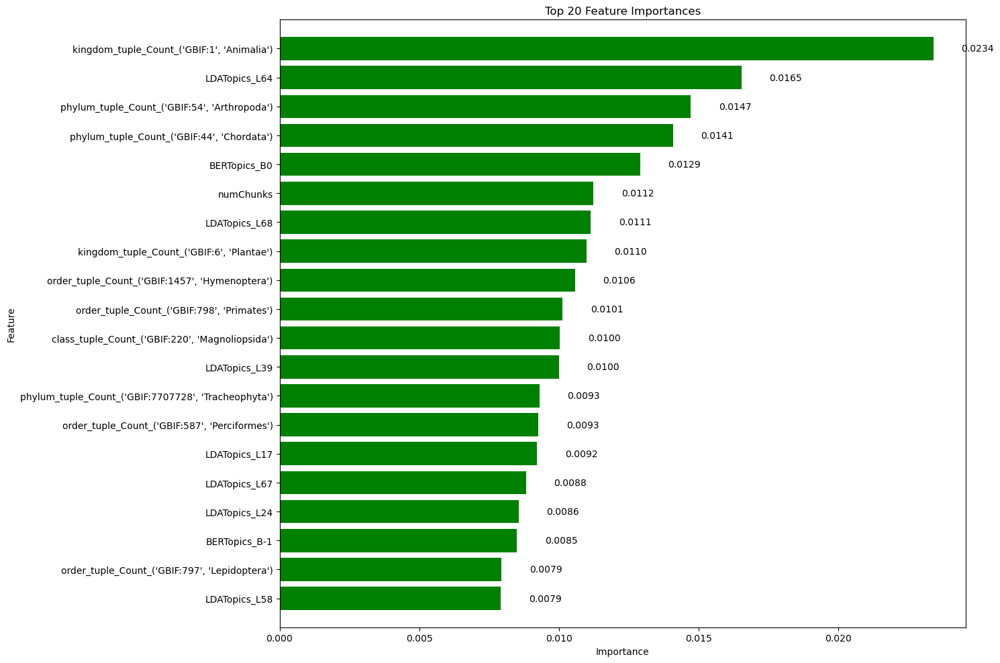

In [19]:
import matplotlib.pyplot as plt
import numpy as np

# Select the top 20 features for better visualization
top_n = 20
top_indices = indices[:top_n]

# Plot the feature importances
plt.figure(figsize=(15, 10))
plt.title("Top 20 Feature Importances")
plt.barh(range(top_n), importances[top_indices], align="center", color = 'green')
plt.yticks(range(top_n), [feature_names[i] for i in top_indices])
plt.ylim([-1, top_n])
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.gca().invert_yaxis()

# Add the feature importance values next to the bars
for i in range(top_n):
    plt.text(importances[top_indices][i] + 0.001, i, f"{importances[top_indices][i]:.4f}", va='center')

plt.tight_layout()
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/feature_importance_FA.png')
plt.show()
plt.close()



In [20]:
# Create a DataFrame with feature names and their importances
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
})

# Sort the DataFrame by importance in descending order
feature_importance_FA_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Save the DataFrame to an Excel file
output_path = 'C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/feature_importances_FA.xlsx'
feature_importance_FA_df.to_excel(output_path, index=False)

feature_importance_FA_df

C:\Users\maria\AppData\Local\Temp\ipykernel_33464\2292134807.py:12: UserWarning: Pandas requires version '3.0.5' or newer of 'xlsxwriter' (version '3.0.3' currently installed).
  feature_importance_FA_df.to_excel(output_path, index=False)


,Feature,Importance
141,"kingdom_tuple_Count_('GBIF:1', 'Animalia')",0.023389
104,LDATopics_L64,0.016524
154,"phylum_tuple_Count_('GBIF:54', 'Arthropoda')",0.014718
153,"phylum_tuple_Count_('GBIF:44', 'Chordata')",0.014075
11,BERTopics_B0,0.012895
...,...,...
2532,"genus_tuple_Count_('GBIF:7341538', 'Stymphalor...",0.000000
2531,"genus_tuple_Count_('GBIF:7310391', 'Oxychloe')",0.000000
2530,"genus_tuple_Count_('GBIF:2007771', 'Nysius')",0.000000
2529,"genus_tuple_Count_('GBIF:2385963', 'Trematomus')",0.000000


In [21]:
# Print the classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.60      0.80      0.69       109
           1       0.53      0.30      0.38        83

    accuracy                           0.58       192
   macro avg       0.57      0.55      0.53       192
weighted avg       0.57      0.58      0.56       192



Precision measures how many of the items identified as a certain class are actually that class. For example, 68% of the instances labeled as "female" are actually female.

Recall measures how many of the actual instances of a class were identified correctly. For example, 84% of actual male instances were correctly identified.

F1-score is the harmonic mean of precision and recall, providing a balance between the two metrics.

#### Confussion Matrix 

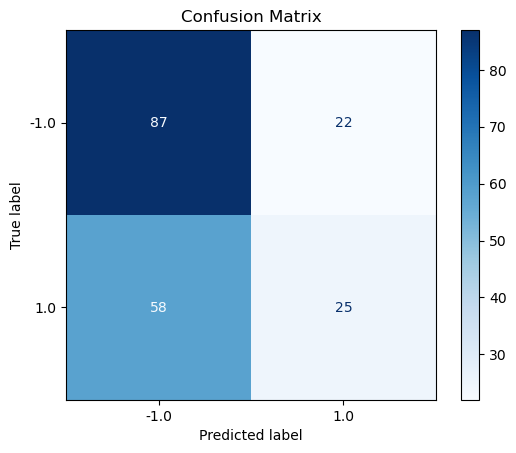

In [22]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Predict the test set
y_pred = best_grid.predict(X_test)

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred, labels=best_grid.classes_)

# Plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/confusion_matrix.png')
plt.show()
plt.close()

### Entropy meassures

Entropy is a measure of randomness or uncertainty in the dataset. A higher entropy value indicates more uncertainty.
The total entropy of 1.2626 indicates the level of unpredictability in the target variable (First_Gender) before any splits.

Range: 0-2 for 4 classes

### Gain meassurement
Information Gain measures the reduction in entropy or uncertainty after a dataset is split based on an attribute.
Higher information gain indicates that the attribute provides a significant reduction in uncertainty, making it a valuable feature for classification.

####  Out-of-Bag (OOB) Error

The OOB score is an internal validation score for Random Forests. It indicates how well the model generalizes to unseen data.
An OOB score of 0.5465 (54.65%) suggests moderate performance, indicating that the model has a reasonable but not outstanding ability to generalize.

In [23]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE


# Calculate OOB score
oob_score = best_grid.oob_score_

# Calculate feature importances (used as a proxy for gain)
feature_importances = best_grid.feature_importances_

# Calculate entropy for each feature (using feature importance as a proxy)
entropy = -feature_importances * np.log2(feature_importances + 1e-10)

# Sum of entropies
total_entropy = np.sum(entropy)

print("OOB Score:", oob_score)
print("Total Entropy:", total_entropy)
print("Feature Importances (Gain):", feature_importances)

# Save results in variables
oob_result = oob_score
entropy_result = total_entropy
gain_result = feature_importances



OOB Score: 0.6171875
Total Entropy: 8.387652752064046
Feature Importances (Gain): [1.35903312e-04 2.71874134e-04 1.32126639e-05 ... 1.12281018e-02
 7.64434438e-03 7.01447634e-03]


## Training RF for Last Author Prediction

In [25]:

# Select other relevant columns
relevant_columns = [
    'numChunks', 'releasedDateY_i', 'First_Gender_Value', 'Last_Gender_Value'
]

target = 'Last_Gender_Value'
other_df = data[relevant_columns]

# Combine encoded columns with other relevant columns
final_df = pd.concat([encoded_df.reset_index(drop=True), other_df.reset_index(drop=True)], axis=1)

# Drop rows with values different than 1 or -1
final_df = final_df[final_df[target].isin([1, -1])]



# Split data into features and target
X = final_df.drop(columns=[target])
y = final_df[target]

# Encode the target variable
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Handle class imbalance using Random Under-sampling
rus = RandomUnderSampler(random_state=42)
X_train_res, y_train_res = rus.fit_resample(X_train, y_train)

# Convert target names to strings
target_names = [str(cls) for cls in label_encoder.classes_]



# Define the parameter grid, including n_estimators
param_grid = {
    'n_estimators': [100, 300, 500, 700],
    'max_depth': [None, 20, 30, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Create a base model
rf = RandomForestClassifier(random_state=42,  oob_score=True)

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

print("Best parameters found: ", grid_search.best_params_)

# Evaluate the model with the best found parameters
best_grid = grid_search.best_estimator_
y_pred = best_grid.predict(X_test)

print(classification_report(y_test, y_pred, target_names=target_names))

Fitting 5 folds for each of 432 candidates, totalling 2160 fits


C:\Users\maria\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:425: FitFailedWarning: 
720 fits failed out of a total of 2160.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
504 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 732, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\base.py", line 1144, in wrapper
    estimator._validate_params()
  File "C:\Users\maria\anaconda3\lib\site-packages\sklearn\base.py", line 637, in _validate_params
    validate_parameter_constraints(
  File "C:\Users\maria\anaconda3\lib\site-packa

Best parameters found:  {'max_depth': 50, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
              precision    recall  f1-score   support

        -1.0       0.73      0.98      0.84       136
         1.0       0.25      0.02      0.04        49

    accuracy                           0.72       185
   macro avg       0.49      0.50      0.44       185
weighted avg       0.61      0.72      0.63       185



In [26]:
# Select the first tree in the forest
tree = best_grid.estimators_[0]

# Convert feature names to a list
feature_names = X_train.columns.tolist()

# Convert class names to a list
class_names = label_encoder.classes_.astype(str).tolist()

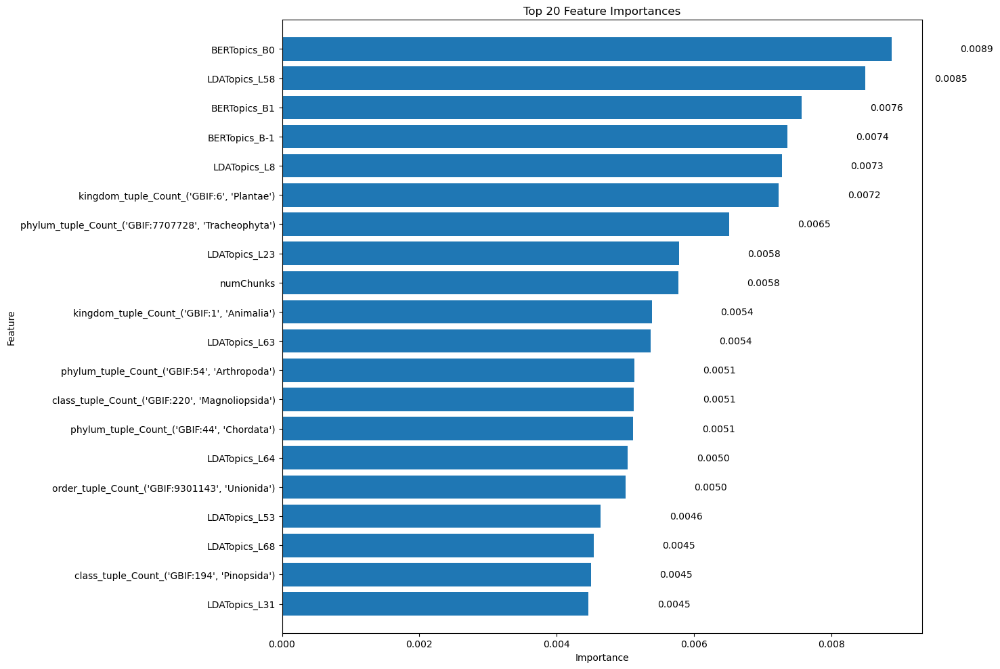

C:\Users\maria\AppData\Local\Temp\ipykernel_33464\4143308280.py:44: UserWarning: Pandas requires version '3.0.5' or newer of 'xlsxwriter' (version '3.0.3' currently installed).
  feature_importance_LA_df.to_excel(output_path, index=False)


,Feature,Importance
11,BERTopics_B0,0.008879
117,LDATopics_L58,0.008499
44,BERTopics_B1,0.007569
21,BERTopics_B-1,0.007362
85,LDATopics_L8,0.007278
...,...,...
3190,"genus_tuple_Count_('GBIF:2587127', 'Peltula')",0.000000
3192,"genus_tuple_Count_('GBIF:2431937', 'Chioglossa')",0.000000
3193,"genus_tuple_Count_('GBIF:2528519', 'Hebeloma')",0.000000
3197,"genus_tuple_Count_('GBIF:3137422', 'Leontodon')",0.000000


In [27]:

# Get feature importances from the trained model
importances = best_grid.feature_importances_

# Create a list of feature names
feature_names = X_train.columns

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Select the top 20 features for better visualization
top_n = 20
top_indices = indices[:top_n]

# Plot the feature importances
plt.figure(figsize=(15, 10))
plt.title("Top 20 Feature Importances")
plt.barh(range(top_n), importances[top_indices], align="center")
plt.yticks(range(top_n), [feature_names[i] for i in top_indices])
plt.ylim([-1, top_n])
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.gca().invert_yaxis()

# Add the feature importance values next to the bars
for i in range(top_n):
    plt.text(importances[top_indices][i] + 0.001, i, f"{importances[top_indices][i]:.4f}", va='center')

plt.tight_layout()
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/feature_importance_LA.png')
plt.show()
plt.close()

# Create a DataFrame with feature names and their importances
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
})

# Sort the DataFrame by importance in descending order
feature_importance_LA_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Save the DataFrame to an Excel file
output_path = 'C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/feature_importances_LA.xlsx'
feature_importance_LA_df.to_excel(output_path, index=False)

feature_importance_LA_df

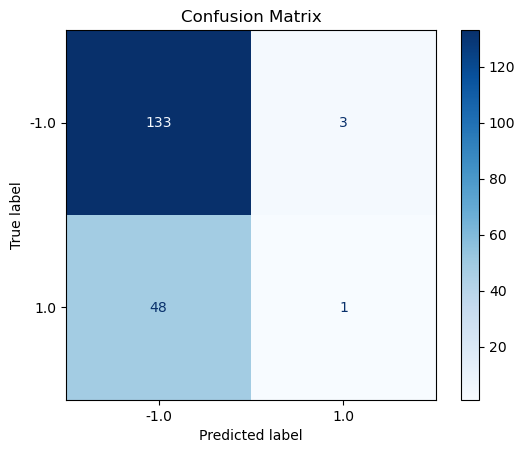

In [28]:
# Predict the test set
y_pred = best_grid.predict(X_test)

# Compute the confusion matrix
cm = confusion_matrix(y_test, y_pred, labels=best_grid.classes_)

# Plot the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/confusion_matrix_LA.png')
plt.show()
plt.close()

In [29]:



# Calculate OOB score
oob_score = best_grid.oob_score_

# Calculate feature importances (used as a proxy for gain)
feature_importances = best_grid.feature_importances_

# Calculate entropy for each feature (using feature importance as a proxy)
entropy = -feature_importances * np.log2(feature_importances + 1e-10)

# Sum of entropies
total_entropy = np.sum(entropy)

print("OOB Score:", oob_score)
print("Total Entropy:", total_entropy)
print("Feature Importances (Gain):", feature_importances)

# Save results in variables
oob_result = oob_score
entropy_result = total_entropy
gain_result = feature_importances


OOB Score: 0.7225981055480379
Total Entropy: 10.046514096584527
Feature Importances (Gain): [0.00299027 0.00038758 0.00056622 ... 0.00577148 0.00444831 0.00294744]


# Gender Score comparison

In [1]:


#LOAD GRAPH 


def load_graph_pickle(filename):
    """
    Load the graph from a pickle file.
    """
    with open(filename, 'rb') as file:
        graph = pickle.load(file)
    
    print(f"Graph loaded from {filename}")
    
    # Check if the loaded graph is same as the saved one
    print(f"Number of nodes in loaded graph: {graph.number_of_nodes()}")
    print(f"Number of edges in loaded graph: {graph.number_of_edges()}")
    
    print("\nNode attributes:")
    for node, data in graph.nodes(data=True):
        print(f"Node {node}: {data}")

    print("\nEdge attributes:")
    for u, v, data in graph.edges(data=True):
        print(f"Edge {u}-{v}: {data}")


    return graph

import pickle



kingdom_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/kingdom_G2.pkl')
phylum_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/phylum_G2.pkl')
class_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/class_G2.pkl')
order_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/order_G2.pkl')
family_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/family_G2.pkl')
genus_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/genus_G2.pkl')
species_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/species_G2.pkl')

tdt_bertopic_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/tdt_bertopic_G.pkl')
tdt_lda_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/tdt_lda_G.pkl')

dtd_bertopic_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/dtd_bertopic_G.pkl')
dtd_lda_G = load_graph_pickle('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/dtd_lda_G.pkl')



Graph loaded from C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/kingdom_G2.pkl
Number of nodes in loaded graph: 7
Number of edges in loaded graph: 15

Node attributes:
Node ('GBIF:1', 'Animalia'): {'size': 735, 'total_count': 62307, 'color': (0.8267843164705883, 0.8582053555372549, 0.906952644627451, 1.0), 'border_color': (0.6881884831921569, 0.7931783792980391, 0.9880381043568628, 1.0), 'first_author_score': -0.07482993197278912, 'team_score': -0.2971989672179973, 'last_author_score': -0.44013605442176873, 'total_mentions': 62307, 'documents': ['https://hal.inrae.fr/hal-02699278/document', 'https://hal.science/hal-03203941/document', 'https://hal.umontpellier.fr/hal-01835447/document', 'https://normandie-univ.hal.science/hal-01983317/document', 'https://hal.science/hal-03875514/document', 'https://hal.science/hal-01928114/document', 'https://hal.science/hal-04248123/document', 'https://hal.science/hal-03043276/document', 'https://hal.science/hal-03319442/document', 'https

Edge ('GBIF:412', 'Gentianales')-('GBIF:946', 'Dipsacales'): {'weight': 8}
Edge ('GBIF:412', 'Gentianales')-('GBIF:7226464', 'Boraginales'): {'weight': 12}
Edge ('GBIF:412', 'Gentianales')-('GBIF:640', 'Pinales'): {'weight': 8}
Edge ('GBIF:412', 'Gentianales')-('GBIF:1353', 'Ericales'): {'weight': 8}
Edge ('GBIF:412', 'Gentianales')-('GBIF:797', 'Lepidoptera'): {'weight': 2}
Edge ('GBIF:412', 'Gentianales')-('GBIF:7219248', 'Saxifragales'): {'weight': 4}
Edge ('GBIF:412', 'Gentianales')-('GBIF:7191407', 'Falconiformes'): {'weight': 2}
Edge ('GBIF:412', 'Gentianales')-('GBIF:1176', 'Solanales'): {'weight': 6}
Edge ('GBIF:412', 'Gentianales')-('GBIF:7224005', 'Cucurbitales'): {'weight': 4}
Edge ('GBIF:412', 'Gentianales')-('GBIF:407', 'Laurales'): {'weight': 4}
Edge ('GBIF:412', 'Gentianales')-('GBIF:954', 'Equisetales'): {'weight': 2}
Edge ('GBIF:412', 'Gentianales')-('GBIF:1425', 'Ixodida'): {'weight': 2}
Edge ('GBIF:412', 'Gentianales')-('GBIF:392', 'Polypodiales'): {'weight': 4}
Edge

Edge ('GBIF:9301143', 'Unionida')-('GBIF:1070', 'Plumatellida'): {'weight': 2}
Edge ('GBIF:9301143', 'Unionida')-('GBIF:723', 'Galliformes'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:552', 'Arecales'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:797', 'Lepidoptera'): {'weight': 4}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:7191407', 'Falconiformes'): {'weight': 4}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:885', 'Lamniformes'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:7190978', 'Sphenisciformes'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:548', 'Esociformes'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:8214029', 'Myliobatiformes'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:723', 'Galliformes'): {'weight': 4}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:803', 'Soricomorpha'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:1426', 'Sessilia'): {'weight': 2}
Edge ('GBIF:785', 'Lagomorpha')-('GBIF:588', 'Pleuronectiformes'): {'weight'

Node ('GBIF:2852', 'Lymnaeidae'): {'size': 3, 'total_count': 37, 'color': (0.8674276350862745, 0.864376599772549, 0.8626024620196079, 1.0), 'border_color': (0.6881884831921569, 0.7931783792980391, 0.9880381043568628, 1.0), 'first_author_score': 0.0, 'team_score': -0.30357142857142855, 'last_author_score': -0.6666666666666666, 'total_mentions': 37, 'documents': ['https://hal.science/hal-04482826/document', 'https://univ-perp.hal.science/hal-03771627/document', 'https://hal.science/hal-04179044/document'], 'document_count': 3, 'year_occurrences': {2024: 1, 2022: 1, 2023: 1}, 'gender_counts': {'female': 11, 'male': 12, 'andy': 1}, 'FA_genders': Counter({'Mostly male': 2, 'Female': 1}), 'LA_genders': Counter({'Male': 2, 'Neutral': 1}), 'degree_centrality': 0.01968503937007874, 'betweenness_centrality': 0.00024220836296229108, 'closeness_centrality': 0.42249005290615765, 'eigenvector_centrality': 0.007750331159889198, 'clustering_coefficient': 0.4789473684210526, 'strength': 44, 'avg_weight

Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:5277', 'Pycnonotidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:9350', 'Sturnidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:9413', 'Cheloniidae'): {'weight': 4}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:9681', 'Ursidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:2211', 'Carcharhinidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:5310', 'Phocidae'): {'weight': 4}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:5309', 'Otariidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:5087', 'Polypteridae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:8979', 'Claroteidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:8978', 'Clariidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:9617', 'Pelomedusidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:5469', 'Trionychidae'): {'weight': 2}
Edge ('GBIF:7336', 'Cyprinidae')-('GBIF:4512', 'Ariidae'): {'weight': 2}
Edge ('G

Edge ('GBIF:5925', 'Gryllidae')-('GBIF:5481', 'Pieridae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:1555553', 'Scathophagidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:3268702', 'Pseudocerotidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:7780', 'Chrysomelidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:7888', 'Lygaeidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:4279', 'Kyphosidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:3346', 'Culicidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:9199', 'Agamidae'): {'weight': 2}
Edge ('GBIF:5925', 'Gryllidae')-('GBIF:9622', 'Cercopithecidae'): {'weight': 2}
Edge ('GBIF:9327', 'Paridae')-('GBIF:5483', 'Hominidae'): {'weight': 10}
Edge ('GBIF:9327', 'Paridae')-('GBIF:7662', 'Esocidae'): {'weight': 2}
Edge ('GBIF:9327', 'Paridae')-('GBIF:5547', 'Drosophilidae'): {'weight': 8}
Edge ('GBIF:9327', 'Paridae')-('GBIF:5298', 'Cervidae'): {'weight': 18}
Edge ('GBIF:9327

Edge ('GBIF:4342', 'Formicidae')-('GBIF:3073', 'Poaceae'): {'weight': 4}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:8597', 'Serranidae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:5483', 'Hominidae'): {'weight': 6}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:5485', 'Lemuridae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:9371', 'Burramyidae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:6652', 'Oleaceae'): {'weight': 4}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:9701', 'Canidae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:4183', 'Pleurotaceae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:3112', 'Brassicaceae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:8542', 'Lutjanidae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:4689', 'Fagaceae'): {'weight': 2}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:7666', 'Gasterosteidae'): {'weight': 4}
Edge ('GBIF:4342', 'Formicidae')-('GBIF:5479', 'Equidae'): {'weight': 2}
Edge ('GBIF:4342',

Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:9703', 'Felidae'): {'weight': 4}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:6176', 'Icteridae'): {'weight': 4}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:9615', 'Emballonuridae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:9650', 'Pentatomidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:5449', 'Rhinolophidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:8621', 'Cottidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:5602', 'Cerambycidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:2219', 'Tetraodontidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:7015', 'Noctuidae'): {'weight': 8}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:8832', 'Bombycidae'): {'weight': 4}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:6088', 'Dermanyssidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBIF:2832', 'Laelapidae'): {'weight': 2}
Edge ('GBIF:5547', 'Drosophilidae')-('GBI

Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5290', 'Turdidae'): {'weight': 6}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:9342', 'Rallidae'): {'weight': 6}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:6100825', 'Locustellidae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:6101019', 'Acrocephalidae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5493', 'Castoridae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5464', 'Dermochelyidae'): {'weight': 4}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5268', 'Phalacrocoracidae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:9350', 'Sturnidae'): {'weight': 6}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:9338', 'Podicipedidae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5263', 'Parulidae'): {'weight': 2}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:5288', 'Threskiornithidae'): {'weight': 4}
Edge ('GBIF:2877', 'Accipitridae')-('GBIF:3685', 'Ardeidae'): {'weight': 4}
Edge ('GBIF:2877', 'Accipitridae')-('G

Edge ('GBIF:5310', 'Phocidae')-('GBIF:9703', 'Felidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:4287243', 'Haematopodidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:3476', 'Mytilidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:6820', 'Ommastrephidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:2872', 'Mastigoteuthidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:2868', 'Vampyroteuthidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:6835', 'Octopodidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:7191', 'Hemiramphidae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:2420', 'Plantaginaceae'): {'weight': 2}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:2073', 'Euphausiidae'): {'weight': 8}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:8549', 'Nototheniidae'): {'weight': 8}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:5284', 'Spheniscidae'): {'weight': 14}
Edge ('GBIF:5310', 'Phocidae')-('GBIF:9316', 'Laridae'): {'weight': 2}
Edge (

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge ('GBIF:2488', 'Sternaspidae')-('GBIF:8046', 'Inachidae'): {'weight': 2}
Edge ('GBIF:2488', 'Sternaspidae')-('GBIF:2214', 'Zeidae'): {'weight': 2}
Edge ('GBIF:5968394', 'Polybiidae')-('GBIF:8023', 'Atelecyclidae'): {'weight': 2}
Edge ('GBIF:5968394', 'Polybiidae')-('GBIF:8046', 'Inachidae'): {'weight': 2}
Edge ('GBIF:5968394', 'Polybiidae')-('GBIF:2214', 'Zeidae'): {'weight': 2}
Edge ('GBIF:8023', 'Atelecyclidae')-('GBIF:8046', 'Inachidae'): {'weight': 2}
Edge ('GBIF:8023', 'Atelecyclidae')-('GBIF:2214', 'Zeidae'): {'weight': 2}
Edge ('GBIF:8046', 'Inachidae')-('GBIF:2214', 'Zeidae'): {'weight': 2}
Edge ('GBIF:9438', 'Agaonidae')-('GBIF:8170', 'Carybdeidae'): {'weight': 2}
Edge ('GBIF:5300', 'Hippopotamidae')-('GBIF:9334', 'Pittidae'): {'weight': 2}
Edge ('GBIF:5300', 'Hippopotamidae')-('GBIF:5704', 'Bucorvidae'): {'weight': 2}
Edge ('GBIF:3508', 'Lophopodidae')-('GBIF:6907', 'Cristatellidae'): {'weight': 2}
Edge ('GBIF:3508', 'Lophopodidae')-('GBIF:6908', 'Fredericellidae'): {'wei

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Node ('GBIF:8782549', 'Anolis'): {'size': 2, 'total_count': 6, 'color': (0.2298057, 0.298717966, 0.753683153, 1.0), 'border_color': (0.8267843164705883, 0.8582053555372549, 0.906952644627451, 1.0), 'first_author_score': -1.0, 'team_score': -0.07386363636363635, 'last_author_score': 0.5, 'total_mentions': 6, 'documents': ['https://cnrs.hal.science/hal-03764927/document', 'https://hal.science/hal-02399200/document'], 'document_count': 2, 'year_occurrences': {2022: 1, 2020: 1}, 'gender_counts': {'mostly_female': 1, 'male': 4, 'unknown': 2, 'female': 2}, 'FA_genders': Counter({'Male': 2}), 'LA_genders': Counter({'Neutral': 1, 'Female': 1}), 'degree_centrality': 0.004448038819247877, 'betweenness_centrality': 1.8599525765042108e-05, 'closeness_centrality': 0.32532018633299686, 'eigenvector_centrality': 0.0004984552878988609, 'clustering_coefficient': 0.8181818181818182, 'strength': 22, 'avg_weight_end_point_degree': 794.0, 'neighborhood_connectivity': 36.09090909090909, 'male_neighbors': 0.

Edge ('GBIF:1337664', 'Osmia')-('GBIF:1522683', 'Drosophila'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2926061', 'Symphytum'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:8089532', 'Cytisus'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:1341127', 'Diadasia'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2973363', 'Trifolium'): {'weight': 4}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2926556', 'Glechoma'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2882481', 'Calluna'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:1707218', 'Schistocerca'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2963568', 'Styphnolobium'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2877951', 'Quercus'): {'weight': 4}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:2705783', 'Phragmites'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:3189834', 'Acer'): {'weight': 2}
Edge ('GBIF:1337664', 'Osmia')-('GBIF:7787708', 'Taraxacum'): {'weight': 2}
Edge ('GBIF:1337

Edge ('GBIF:3234608', 'Davilla')-('GBIF:1322845', 'Azteca'): {'weight': 2}
Edge ('GBIF:3234608', 'Davilla')-('GBIF:1312361', 'Camponotus'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:8323398', 'Bellucia'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2965936', 'Inga'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:7340133', 'Goupia'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2956904', 'Senna'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2697812', 'Aechmea'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2872218', 'Anthurium'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:3189424', 'Clusia'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2984472', 'Cecropia'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:3075453', 'Mangifera'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:3866386', 'Bellucia'): {'weight': 2}
Edge ('GBIF:2903511', 'Isertia')-('GBIF:2738048', 'Astrocaryum'): {'weight': 2}
Edge (

Edge ('GBIF:3040183', 'Populus')-('GBIF:7487798', 'Picea'): {'weight': 6}
Edge ('GBIF:3040183', 'Populus')-('GBIF:1820270', 'Lymantria'): {'weight': 4}
Edge ('GBIF:3040183', 'Populus')-('GBIF:2882140', 'Castanea'): {'weight': 10}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3013395', 'Crataegus'): {'weight': 4}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3172323', 'Fraxinus'): {'weight': 12}
Edge ('GBIF:3040183', 'Populus')-('GBIF:2685775', 'Pseudotsuga'): {'weight': 4}
Edge ('GBIF:3040183', 'Populus')-('GBIF:2875008', 'Betula'): {'weight': 14}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3001068', 'Malus'): {'weight': 4}
Edge ('GBIF:3040183', 'Populus')-('GBIF:2875770', 'Carpinus'): {'weight': 10}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3020559', 'Prunus'): {'weight': 12}
Edge ('GBIF:3040183', 'Populus')-('GBIF:2952066', 'Robinia'): {'weight': 2}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3152041', 'Tilia'): {'weight': 6}
Edge ('GBIF:3040183', 'Populus')-('GBIF:3025305', 'Cormus'): {'weight': 2}
Edge 

Edge ('GBIF:2965200', 'Medicago')-('GBIF:4124550', 'Stipagrostis'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:3049319', 'Eruca'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:4062022', 'Arnebia'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:3138214', 'Carthamus'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:7897345', 'Tetrahymena'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2130777', 'Tetranychus'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:1045823', 'Tribolium'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2490714', 'Turdus'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2489099', 'Sturnus'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2490696', 'Alauda'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2482468', 'Corvus'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2491468', 'Emberiza'): {'weight': 2}
Edge ('GBIF:2965200', 'Medicago')-('GBIF:2480996', 'Falco'): {'

Edge ('GBIF:2874026', 'Cistus')-('GBIF:3083483', 'Paeonia'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:2925398', 'Avicennia'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:1048808', 'Lilioceris'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:2949492', 'Chamaecrista'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:2873855', 'Linum'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:3190155', 'Citrus'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:2704913', 'Festuca'): {'weight': 4}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:3138550', 'Ageratum'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:3190519', 'Cotinus'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:3040962', 'Raphanus'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:3189834', 'Acer'): {'weight': 6}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:7722389', 'Mikania'): {'weight': 2}
Edge ('GBIF:2874026', 'Cistus')-('GBIF:2084302', 'Chionaspis'): {'weight': 2}
Edge ('GBIF:2874

Edge ('GBIF:3143303', 'Crepis')-('GBIF:3234239', 'Coris'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:2926895', 'Teucrium'): {'weight': 4}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:2933951', 'Astragalus'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:7331269', 'Fumana'): {'weight': 4}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:3190380', 'Ruta'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:3106738', 'Senecio'): {'weight': 6}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:3046735', 'Sisymbrium'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:3105646', 'Sonchus'): {'weight': 4}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:2706217', 'Lolium'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:2704173', 'Poa'): {'weight': 4}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:7787708', 'Taraxacum'): {'weight': 4}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:3083823', 'Chenopodium'): {'weight': 2}
Edge ('GBIF:3143303', 'Crepis')-('GBIF:2706050', 'Hordeum'): {'weight': 4}
Edge ('GBIF:3143303', '

Edge ('GBIF:2346628', 'Esox')-('GBIF:3020559', 'Prunus'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:3039471', 'Rhamnus'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:3052435', 'Arabidopsis'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:8941741', 'Micrurus'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2469849', 'Ophiophagus'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2454645', 'Python'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:8772012', 'Coronella'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2444141', 'Boa'): {'weight': 4}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2454579', 'Fordonia'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2450984', 'Eryx'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2456937', 'Homalopsis'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2450145', 'Laticauda'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:2469991', 'Atractaspis'): {'weight': 2}
Edge ('GBIF:2346628', 'Esox')-('GBIF:24

Edge ('GBIF:2928997', 'Solanum')-('GBIF:2706162', 'Holcus'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:4988750', 'Abax'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2888431', 'Papaver'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2927077', 'Ajuga'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:7502499', 'Asphodelus'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2874495', 'Bryonia'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:3032632', 'Chrysosplenium'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2926907', 'Clinopodium'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:10356062', 'Lathyrus'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2891642', 'Oxalis'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:3166599', 'Phyteuma'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2769995', 'Polygonatum'): {'weight': 2}
Edge ('GBIF:2928997', 'Solanum')-('GBIF:2888741', 'Valeriana'): {'weight':

Edge ('GBIF:2334781', 'Perca')-('GBIF:2413443', 'Sprattus'): {'weight': 2}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2382125', 'Gymnocephalus'): {'weight': 4}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2362632', 'Scardinius'): {'weight': 2}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2392515', 'Lagodon'): {'weight': 6}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2359646', 'Rutilus'): {'weight': 8}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2356953', 'Lutjanus'): {'weight': 6}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2363407', 'Abramis'): {'weight': 6}
Edge ('GBIF:2334781', 'Perca')-('GBIF:5166381', 'Eudiaptomus'): {'weight': 4}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2117019', 'Macrocyclops'): {'weight': 2}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2116764', 'Acanthocyclops'): {'weight': 2}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2117024', 'Thermocyclops'): {'weight': 2}
Edge ('GBIF:2334781', 'Perca')-('GBIF:2382151', 'Sander'): {'weight': 8}
Edge ('GBIF:2334781', 'Perca')-('GBIF:1000426', 'Hexarthra'): {'weight': 2}
Edge

Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:2892977', 'Cosmibuena'): {'weight': 2}
Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:2947121', 'Dipteryx'): {'weight': 2}
Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:5219531', 'Pongo'): {'weight': 2}
Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:2956616', 'Hippocrepis'): {'weight': 2}
Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:3190483', 'Swietenia'): {'weight': 2}
Edge ('GBIF:2440964', 'Odocoileus')-('GBIF:6370546', 'Maerua'): {'weight': 2}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:7372826', 'Monochamus'): {'weight': 2}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:1820270', 'Lymantria'): {'weight': 4}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:2481126', 'Larus'): {'weight': 2}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:1311334', 'Vespa'): {'weight': 2}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:1043111', 'Harmonia'): {'weight': 2}
Edge ('GBIF:6756641', 'Bursaphelenchus')-('GBIF:1228020', 'Dendroctonus'): {'weight': 2}
Edge ('G

Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:1003651', 'Cristatella'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:1003571', 'Fredericella'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:2474376', 'Fulica'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:1003585', 'Plumatella'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:1037903', 'Graphoderus'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:1003640', 'Lophopus'): {'weight': 2}
Edge ('GBIF:2259455', 'Pocillopora')-('GBIF:2235232', 'Artemia'): {'weight': 2}
Edge ('GBIF:2261760', 'Corallium')-('GBIF:7727995', 'Stylophora'): {'weight': 4}
Edge ('GBIF:2261760', 'Corallium')-('GBIF:3250147', 'Porites'): {'weight': 6}
Edge ('GBIF:2261760', 'Corallium')-('GBIF:2304356', 'Stramonita'): {'weight': 2}
Edge ('GBIF:2261760', 'Corallium')-('GBIF:2413443', 'Sprattus'): {'weight': 2}
Edge ('GBIF:2261760', 'Corallium')-('GBIF:2287625', 'Ruditapes'): {'weight': 2}
Edge ('GBIF:2261760', 'Co

Edge ('GBIF:2438591', 'Microtus')-('GBIF:2403092', 'Anguilla'): {'weight': 2}
Edge ('GBIF:2438591', 'Microtus')-('GBIF:2201390', 'Idotea'): {'weight': 2}
Edge ('GBIF:2438591', 'Microtus')-('GBIF:3241445', 'Leuciscus'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2439357', 'Myopus'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:5219834', 'Lemmus'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2363128', 'Enteromius'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:7816758', 'Alces'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2721893', 'Carex'): {'weight': 4}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2668958', 'Sphagnum'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:3172398', 'Utricularia'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2882481', 'Calluna'): {'weight': 4}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:3169330', 'Lysimachia'): {'weight': 2}
Edge ('GBIF:2687913', 'Equisetum')-('GBIF:2730118', 'Eriopho

Edge ('GBIF:3172047', 'Veronica')-('GBIF:8109416', 'Spartium'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:3152041', 'Tilia'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:2754367', 'Dioscorea'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:2888580', 'Viburnum'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:3034560', 'Angelica'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:5390705', 'Gnaphalium'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:2926061', 'Symphytum'): {'weight': 2}
Edge ('GBIF:3172047', 'Veronica')-('GBIF:3096621', 'Urospermum'): {'weight': 2}
Edge ('GBIF:2440446', 'Tursiops')-('GBIF:9800657', 'Mus'): {'weight': 2}
Edge ('GBIF:2440446', 'Tursiops')-('GBIF:2481203', 'Rissa'): {'weight': 2}
Edge ('GBIF:2440446', 'Tursiops')-('GBIF:2481387', 'Diomedea'): {'weight': 2}
Edge ('GBIF:2440446', 'Tursiops')-('GBIF:2481608', 'Stercorarius'): {'weight': 4}
Edge ('GBIF:2440446', 'Tursiops')-('GBIF:1920793', 'Glutophrissa'

Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2186346', 'Phytoseiulus'): {'weight': 4}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2947798', 'Phaseolus'): {'weight': 8}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2378269', 'Gobiusculus'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:3152652', 'Gossypium'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:8380160', 'Purpureocillium'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:7871727', 'Oligonychus'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2559577', 'Neozygites'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:1737701', 'Cydia'): {'weight': 4}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2411251', 'Diplecogaster'): {'weight': 4}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2928509', 'Ipomoea'): {'weight': 2}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:2932923', 'Lycopersicon'): {'weight': 4}
Edge ('GBIF:2130777', 'Tetranychus')-('GBIF:9042695', 'Melitaea'): {'weight': 2}
Ed

Edge ('GBIF:3036021', 'Hedera')-('GBIF:2874495', 'Bryonia'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:3032632', 'Chrysosplenium'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2926907', 'Clinopodium'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:10356062', 'Lathyrus'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2891642', 'Oxalis'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:3166599', 'Phyteuma'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2769995', 'Polygonatum'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:8169866', 'Amara'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:3050645', 'Alliaria'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2808313', 'Anacamptis'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2869100', 'Calla'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2873815', 'Cerastium'): {'weight': 2}
Edge ('GBIF:3036021', 'Hedera')-('GBIF:2705307', 'Dactylis'): {'weight': 2}
Edge 

Edge ('GBIF:2584049', 'Lemonniera')-('GBIF:3039576', 'Salix'): {'weight': 2}
Edge ('GBIF:2584049', 'Lemonniera')-('GBIF:3012146', 'Sorbus'): {'weight': 2}
Edge ('GBIF:2584049', 'Lemonniera')-('GBIF:3152041', 'Tilia'): {'weight': 2}
Edge ('GBIF:2584049', 'Lemonniera')-('GBIF:2614823', 'Clavariopsis'): {'weight': 2}
Edge ('GBIF:2584049', 'Lemonniera')-('GBIF:2378269', 'Gobiusculus'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2434130', 'Mungos'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2347767', 'Poecilia'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:5219531', 'Pongo'): {'weight': 4}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2435450', 'Sarcophilus'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2433504', 'Crocuta'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2436602', 'Macaca'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2433406', 'Ursus'): {'weight': 2}
Edge ('GBIF:2436440', 'Gorilla')-('GBIF:2441208', 'Babyrousa'): {'weig

Edge ('GBIF:2882140', 'Castanea')-('GBIF:3082226', 'Cornus'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:3027437', 'Alchemilla'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:2747303', 'Crocus'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:3169314', 'Cyclamen'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:8079058', 'Potentilla'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:7953297', 'Phegopteris'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:2873978', 'Aristolochia'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:3172289', 'Ligustrum'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:3033512', 'Clematis'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:2754367', 'Dioscorea'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:2888580', 'Viburnum'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:3034560', 'Angelica'): {'weight': 2}
Edge ('GBIF:2882140', 'Castanea')-('GBIF:5390705', 'Gna

Edge ('GBIF:3154735', 'Oxandra')-('GBIF:3157015', 'Xylopia'): {'weight': 2}
Edge ('GBIF:3154735', 'Oxandra')-('GBIF:3082348', 'Lecythis'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3157015', 'Xylopia'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3082348', 'Lecythis'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3186685', 'Myrtastrum'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:2486114', 'Pycnonotus'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3187232', 'Psidium'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3190641', 'Schinus'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3190001', 'Litchi'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3190383', 'Murraya'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:2925302', 'Lantana'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3029010', 'Syzygium'): {'weight': 2}
Edge ('GBIF:3188558', 'Miconia')-('GBIF:3155252', 'Annona'): {'weight': 2}
Edge 

Edge ('GBIF:2705307', 'Dactylis')-('GBIF:3169845', 'Gentianella'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2874068', 'Helianthemum'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:3137422', 'Leontodon'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:8026112', 'Primula'): {'weight': 4}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2888249', 'Pyrola'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2987833', 'Saxifraga'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:7801254', 'Sedum'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2888810', 'Succisa'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:8322495', 'Taraxacum'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2926907', 'Clinopodium'): {'weight': 4}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:2490696', 'Alauda'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:3039576', 'Salix'): {'weight': 2}
Edge ('GBIF:2705307', 'Dactylis')-('GBIF:7367006', 'Pterostichu

Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2381211', 'Girella'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2481645', 'Eudyptula'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2346574', 'Polypterus'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2372271', 'Oreochromis'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2337340', 'Auchenoglanis'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2333535', 'Silurus'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:5202658', 'Clarias'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2442282', 'Pelusios'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:7236986', 'Pelodiscus'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2393260', 'Polydactylus'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2337753', 'Pterocryptis'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:2338709', 'Pimelodella'): {'weight': 2}
Edge ('GBIF:2441864', 'Chelonia')-('GBIF:23

Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:9720698', 'Fistularia'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2407740', 'Lagocephalus'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:5212030', 'Dascyllus'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2398188', 'Dischistodus'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2407828', 'Sphoeroides'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2433765', 'Martes'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2492191', 'Melospiza'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2490934', 'Sialia'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2481797', 'Actitis'): {'weight': 2}
Edge ('GBIF:2493899', 'Troglodytes')-('GBIF:2498324', 'Bucephala'): {'weight': 2}
Edge ('GBIF:2638467', 'Chlorella')-('GBIF:2440608', 'Lagenorhynchus'): {'weight': 2}
Edge ('GBIF:2638467', 'Chlorella')-('GBIF:9429634', 'Monoraphidium'): {'weight': 2}
Edge ('GBI

Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441075', 'Gazella'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441039', 'Damaliscus'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2440900', 'Antilope'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:7814174', 'Hemitragus'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441175', 'Bison'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2900865', 'Cordia'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2433504', 'Crocuta'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441094', 'Kobus'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441107', 'Ovibos'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2928883', 'Brugmansia'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2115783', 'Semibalanus'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2441017', 'Bos'): {'weight': 2}
Edge ('GBIF:2440999', 'Madoqua')-('GBIF:2440941', 'Muntiacus'): {'weight': 2}
Edge (

Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3118160', 'Tanacetum'): {'weight': 4}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:7925185', 'Cota'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3106707', 'Cichorium'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3141844', 'Helminthotheca'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3034921', 'Foeniculum'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3042187', 'Hesperis'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3189452', 'Hypericum'): {'weight': 4}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3034712', 'Carum'): {'weight': 4}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:3093681', 'Hypochaeris'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:7678064', 'Jacobaea'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:8370997', 'Barbarea'): {'weight': 2}
Edge ('GBIF:8079058', 'Potentilla')-('GBIF:2926556', 'Glechoma'): {'weight': 4}
Edge ('GBIF:8079058', 'Potentilla

Edge ('GBIF:2888942', 'Rumex')-('GBIF:2703131', 'Deschampsia'): {'weight': 6}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:2987968', 'Filipendula'): {'weight': 6}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3034824', 'Heracleum'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3033282', 'Caltha'): {'weight': 2}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:6026466', 'Meum'): {'weight': 2}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3027437', 'Alchemilla'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:2913027', 'Galium'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:10465436', 'Elymus'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3024294', 'Geum'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:2700604', 'Luzula'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3029779', 'Fragaria'): {'weight': 4}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:2925668', 'Myosotis'): {'weight': 2}
Edge ('GBIF:2888942', 'Rumex')-('GBIF:3171955', 'Euphrasia'): {'weight': 2}
Edge ('GBIF:2888942', 'Rumex')

Edge ('GBIF:2434451', 'Dusicyon')-('GBIF:5734043', 'Simulium'): {'weight': 2}
Edge ('GBIF:2434451', 'Dusicyon')-('GBIF:7673372', 'Vicugna'): {'weight': 2}
Edge ('GBIF:2434451', 'Dusicyon')-('GBIF:2005375', 'Agnetina'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2440977', 'Ozotoceros'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2440979', 'Hippocamelus'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2434316', 'Cuon'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2495164', 'Rhea'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2440910', 'Pudu'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2798967', 'Stelis'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2441239', 'Lama'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:2459538', 'Amblyrhynchus'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:5734043', 'Simulium'): {'weight': 2}
Edge ('GBIF:2434443', 'Speothos')-('GBIF:7673372', 'Vicugna'): {'weight'

Edge ('GBIF:1540675', 'Eupeodes')-('GBIF:2925668', 'Myosotis'): {'weight': 2}
Edge ('GBIF:1540675', 'Eupeodes')-('GBIF:3166599', 'Phyteuma'): {'weight': 2}
Edge ('GBIF:1540675', 'Eupeodes')-('GBIF:8026112', 'Primula'): {'weight': 2}
Edge ('GBIF:1540675', 'Eupeodes')-('GBIF:2889786', 'Thesium'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:1483491', 'Volucella'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:2952416', 'Anthyllis'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:3034551', 'Bupleurum'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:3034740', 'Daucus'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:3134951', 'Hieracium'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:3093268', 'Picris'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:3034132', 'Seseli'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus')-('GBIF:1532919', 'Pipizella'): {'weight': 2}
Edge ('GBIF:1542996', 'Platycheirus

Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383807', 'Epibulus'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383738', 'Hemigymnus'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2398526', 'Neopomacentrus'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2385639', 'Hemitaurichthys'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383450', 'Wetmorella'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383813', 'Cirrhilabrus'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383604', 'Cheilio'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2384435', 'Hologymnosus'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2385699', 'Forcipiger'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383382', 'Labropsis'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2383279', 'Novaculichthys'): {'weight': 2}
Edge ('GBIF:2384350', 'Oxycheilinus')-('GBIF:2398166', 'Pomachrom

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:2738106', 'Astrocaryum sciophilum'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:7298763', 'Jacaranda copaia'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:3982815', 'Byrsonima aerugo'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:2874176', 'Passiflora coccinea'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:5556447', 'Clusia grandiflora'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:7303996', 'Davilla rugosa'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:5357677', 'Inga edulis'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:5357991', 'Inga thibaudiana'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:7330259', 'Vismia latifolia'): {'weight': 2}
Edge ('GBIF:9076829', 'Bellucia grossularioides')-('GBIF:2957544', 'Senna lat

Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:5201134', 'Hippocampus hippocampus'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2480506', 'Aquila chrysaetos'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2473678', 'Afropavo congensis'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:4848480', 'Larus smithsonianus'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:6161776', 'Coluber constrictor'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2480311', 'Charadrius alexandrinus'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2482001', 'Oceanodroma castro'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2441866', 'Dermochelys coriacea'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:9804664', 'Pelagodroma marina'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2481991', 'Pelagodroma marina'): {'weight': 2}
Edge ('GBIF:2182873', 'Ixodes uriae')-('GBIF:2417940', 'Prionace gl

Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:2925892', 'Echium vulgare'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:3047621', 'Sinapis alba'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:2874030', 'Cistus monspeliensis'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:7290586', 'Coris monspeliensis'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:7272699', 'Lonicera implexa'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:9558260', 'Lonicera implexa'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:3041800', 'Biscutella laevigata'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:7544211', 'Biscutella laevigata'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:5298190', 'Iris lutescens'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('GBIF:7437461', 'Iris lutescens'): {'weight': 2}
Edge ('GBIF:2879175', 'Quercus coccifera')-('

Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:7103891', 'Salix triandra'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:8056040', 'Carabus nemoralis'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:7856746', 'Pterostichus melanarius'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:7911626', 'Quercus robur'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:7586523', 'Quercus robur'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:2888443', 'Papaver rhoeas'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:2926683', 'Lamium album'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:5376075', 'Alliaria petiolata'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:7439233', 'Allium vineale'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:5371743', 'Anthriscus caucalis'): {'weight': 2}
Edge ('GBIF:2436436', 'Homo sapiens')-('GBIF:5371742', 'Anthriscus sylvestris'): {'weight': 2}
Edge ('G

Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2706163', 'Holcus mollis'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2700828', 'Luzula campestris'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2704179', 'Poa annua'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:7760595', 'Poa nemoralis'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2704261', 'Poa palustris'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:7931731', 'Prunus domestica'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:3023221', 'Prunus spinosa'): {'weight': 4}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2879098', 'Quercus ilex'): {'weight': 4}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:8042893', 'Quercus pubescens'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:2995209', 'Rubus caesius'): {'weight': 2}
Edge ('GBIF:8030923', 'Quercus rubra')-('GBIF:8436459', 'Rubus fruticosus'): {'weight': 2}
Edge ('GBIF:8030923', 

Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2409909', 'Buglossidium luteum'): {'weight': 4}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:5213960', 'Limanda limanda'): {'weight': 2}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2409104', 'Hippoglossoides platessoides'): {'weight': 2}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:5214139', 'Solea solea'): {'weight': 6}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2409330', 'Platichthys flesus'): {'weight': 4}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:4315675', 'Haploops nirae'): {'weight': 2}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2415906', 'Trisopterus minutus'): {'weight': 4}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2413224', 'Sardina pilchardus'): {'weight': 6}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:5204019', 'Oncorhynchus mykiss'): {'weight': 2}
Edge ('GBIF:7700106', 'Pleuronectes platessa')-('GBIF:2415916', 'Trisopterus luscus'): {'wei

Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:5369652', 'Geum urbanum'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:8300875', 'Poa trivialis'): {'weight': 4}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:3105782', 'Sonchus asper'): {'weight': 4}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:3034922', 'Foeniculum vulgare'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:3118274', 'Tanacetum vulgare'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:3171939', 'Verbascum densiflorum'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:2927078', 'Ajuga reptans'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:5375388', 'Capsella bursa-pastoris'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:5357013', 'Lotus corniculatus'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:5390618', 'Cota tinctoria'): {'weight': 2}
Edge ('GBIF:3172077', 'Veronica persica')-('GBIF:5392252',

Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:7355203', 'Fraxinus excelsior'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:8322708', 'Fraxinus excelsior'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:1768702', 'Conistra vaccinii'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:3189811', 'Aesculus neglecta'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:7699567', 'Hymenoscyphus pseudoalbidus'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:3040227', 'Populus nigra'): {'weight': 4}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:3021037', 'Prunus padus'): {'weight': 6}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:9148577', 'Alnus incana'): {'weight': 4}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:3040233', 'Populus alba'): {'weight': 2}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:5372513', 'Salix alba'): {'weight': 4}
Edge ('GBIF:2875818', 'Carpinus betulus')-('GBIF:7303616', 'Ulmu

Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:7931226', 'Carex nigra'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2704922', 'Festuca rubra'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2988069', 'Filipendula vulgaris'): {'weight': 2}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:7665313', 'Galium boreale'): {'weight': 2}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2701311', 'Juncus effusus'): {'weight': 2}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2700828', 'Luzula campestris'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2704179', 'Poa annua'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2704178', 'Poa pratensis'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:3172043', 'Rhinanthus minor'): {'weight': 2}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:2888995', 'Rumex acetosella'): {'weight': 4}
Edge ('GBIF:5331916', 'Betula pendula')-('GBIF:6446462', 'Solidago virgaurea'): {'weight': 4}
Edg

Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:5231030', 'Geospiza fortis'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:2350050', 'Poecilia reticulata'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:2480415', 'Rostrhamus sociabilis'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:5231025', 'Geospiza fuliginosa'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:5231036', 'Geospiza magnirostris'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:2928584', 'Ipomoea lacunosa'): {'weight': 2}
Edge ('GBIF:8538855', 'Urosaurus ornatus')-('GBIF:2363791', 'Yuriria amatlana'): {'weight': 2}
Edge ('GBIF:2384899', 'Lutjanus sebae')-('GBIF:2433462', 'Eumetopias jubatus'): {'weight': 2}
Edge ('GBIF:2384899', 'Lutjanus sebae')-('GBIF:3196095', 'Ecklonia radiata'): {'weight': 2}
Edge ('GBIF:2384899', 'Lutjanus sebae')-('GBIF:5422383', 'Laminaria hyperborea'): {'weight': 12}
Edge ('GBIF:2384899', 'Lutjanus sebae

Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:1315391', 'Wasmannia auropunctata'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:3189811', 'Aesculus neglecta'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:1749449', 'Cameraria ohridella'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:2703746', 'Bromus tectorum'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:2287072', 'Dreissena polymorpha'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:3190642', 'Schinus molle'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:5329212', 'Elodea nuttallii'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:4264680', 'Myocastor coypus'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:8979506', 'Faxonius rusticus'): {'weight': 2}
Edge ('GBIF:1316908', 'Linepithema humile')-('GBIF:5389029', 'Solidago canadensis'): {'weight': 2}
Edge ('GBIF:1311527', 'Ves

Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:8406533', 'Pinus uncinata'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:2722326', 'Carex sempervirens'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:2685353', 'Abies fabri'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:3033461', 'Ranunculus glacialis'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:5490514', 'Monascus olei'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:2182588', 'Ixodes ricinus'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:4149465', 'Avenella flexuosa'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:2889011', 'Rumex obtusifolius'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:5333294', 'Castanea sativa'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium myrtillus')-('GBIF:3139040', 'Mycelis muralis'): {'weight': 2}
Edge ('GBIF:2882833', 'Vaccinium my

Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:3085440', 'Cerastium glomeratum'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:2928390', 'Convolvulus arvensis'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:3152374', 'Malva sylvestris'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:9182765', 'Calendula arvensis'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:8760504', 'Convolvulus arvensis'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:2772020', 'Muscari neglectum'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:8559046', 'Muscari neglectum'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:7920199', 'Diplotaxis erucoides'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:9192369', 'Mercurialis annua'): {'weight': 2}
Edge ('GBIF:9485490', 'Erodium cicutarium')-('GBIF:2926679', 'Lamium amplexicaule'): {'weight': 2}
Edge ('GBIF:9485

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2723188', 'Carex elongata'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2726880', 'Carex flava'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2724108', 'Carex montana'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:8285827', 'Carex leporina'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:7477074', 'Carex pilulifera'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2706163', 'Holcus mollis'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2704261', 'Poa palustris'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:3023221', 'Prunus spinosa'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2995209', 'Rubus caesius'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:2888946', 'Rumex longifolius'): {'weight': 2}
Edge ('GBIF:2704951', 'Festuca ovina')-('GBIF:5372513', 'Salix alba'): {'weight': 2}
Edge ('GBIF:2704951', 'Fest

Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:4374731', 'Pinna nobilis'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:2286995', 'Macoma balthica'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:2285352', 'Pinna rudis'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:5427681', 'Vibrio mediterranei'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:5227766', 'Gallus lafayettii'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:2285345', 'Atrina fragilis'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:3225140', 'Mycobacterium tuberculosis'): {'weight': 2}
Edge ('GBIF:4372687', 'Ruditapes decussatus')-('GBIF:2479365', 'Diopsittaca nobilis'): {'weight': 2}
Edge ('GBIF:9814714', 'Asteromella garbowskii')-('GBIF:7861320', 'Bouteloua gracilis'): {'weight': 2}
Edge ('GBIF:7861320', 'Bouteloua gracilis')-('GBIF:3121425', 'Artemisia tripartita'): {'weight': 2}
Edge ('

Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2385419', 'Chaetodon falcula'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2398628', 'Abudefduf septemfasciatus'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2399336', 'Chrysiptera annulata'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:5209716', 'Bodianus anthioides'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2398669', 'Abudefduf sexfasciatus'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2398634', 'Abudefduf vaigiensis'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2398558', 'Neopomacentrus azysron'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:7479802', 'Chaetodon citrinellus'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus evanidus')-('GBIF:2385403', 'Chaetodon lunulatus'): {'weight': 2}
Edge ('GBIF:2383692', 'Pseudocheilinus ev

Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:2914642', 'Galium odoratum'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:7918914', 'Geum rivale'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:5369652', 'Geum urbanum'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:2926557', 'Glechoma hederacea'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:3189486', 'Hypericum perforatum'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:6436469', 'Hypericum tetrapterum'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:2888342', 'Hypopitys monotropa'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:7701037', 'Nasturtium officinale'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:2773448', 'Ornithogalum umbellatum'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:3093337', 'Picris hieracioides'): {'weight': 2}
Edge ('GBIF:9522109', 'Silene vulgaris')-('GBIF:541

Edge ('GBIF:7730008', 'Poa annua')-('GBIF:2882835', 'Vaccinium vitis-idaea'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:2988069', 'Filipendula vulgaris'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:7665313', 'Galium boreale'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:2701311', 'Juncus effusus'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:2700828', 'Luzula campestris'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:3172043', 'Rhinanthus minor'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:2888995', 'Rumex acetosella'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:6446462', 'Solidago virgaurea'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:9606357', 'Veronica chamaedrys'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:7728366', 'Coenonympha arcania'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua')-('GBIF:7934503', 'Rubus idaeus'): {'weight': 2}
Edge ('GBIF:7730008', 'Poa annua'

Edge ('GBIF:2379621', 'Ctenochaetus striatus')-('GBIF:5200938', 'Fistularia commersonii'): {'weight': 2}
Edge ('GBIF:2379621', 'Ctenochaetus striatus')-('GBIF:2390341', 'Scarus rivulatus'): {'weight': 2}
Edge ('GBIF:2379621', 'Ctenochaetus striatus')-('GBIF:2398894', 'Stegastes planifrons'): {'weight': 2}
Edge ('GBIF:2379621', 'Ctenochaetus striatus')-('GBIF:2398897', 'Stegastes adustus'): {'weight': 2}
Edge ('GBIF:2379621', 'Ctenochaetus striatus')-('GBIF:2417981', 'Carcharhinus melanopterus'): {'weight': 2}
Edge ('GBIF:5212176', 'Chromis xanthura')-('GBIF:5209227', 'Acanthurus nigrofuscus'): {'weight': 2}
Edge ('GBIF:5212176', 'Chromis xanthura')-('GBIF:2379864', 'Zebrasoma scopas'): {'weight': 2}
Edge ('GBIF:5212176', 'Chromis xanthura')-('GBIF:5209217', 'Acanthurus triostegus'): {'weight': 2}
Edge ('GBIF:5212176', 'Chromis xanthura')-('GBIF:5209096', 'Naso lituratus'): {'weight': 2}
Edge ('GBIF:5212176', 'Chromis xanthura')-('GBIF:2385531', 'Chaetodon lunula'): {'weight': 2}
Edge (

Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:3171939', 'Verbascum densiflorum'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:2927078', 'Ajuga reptans'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:5357013', 'Lotus corniculatus'): {'weight': 4}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:5390618', 'Cota tinctoria'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:5392252', 'Cichorium intybus'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:7710259', 'Foeniculum vulgare'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:3042291', 'Hesperis matronalis'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:8848598', 'Leucanthemum vulgare'): {'weight': 2}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:3189486', 'Hypericum perforatum'): {'weight': 4}
Edge ('GBIF:5367273', 'Potentilla reptans')-('GBIF:2914642', 'Galium odoratum'): {'weight': 2}
Edge ('GBIF:5367273', 'Po

Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1750094', 'Phyllonorycter scitulella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1749959', 'Phyllonorycter coryli'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1749775', 'Phyllonorycter stettinensis'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1750288', 'Phyllonorycter strigulatella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1750130', 'Phyllonorycter dubitella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1749766', 'Phyllonorycter salicicolella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1750051', 'Phyllonorycter trifasciella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1749856', 'Phyllonorycter populifoliella'): {'weight': 2}
Edge ('GBIF:1749894', 'Phyllonorycter esperella')-('GBIF:1750265', 'Phyllonorycter delitella'): {'weigh

Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:2731882', 'Elaeis guineensis'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:2735760', 'Eremospatha wendlandiana'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:8278609', 'Hyphaene petersiana'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:9687623', 'Laccosperma laeve'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:5293210', 'Raphia farinifera'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:5293265', 'Raphia sudanica'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:5293243', 'Raphia vinifera'): {'weight': 2}
Edge ('GBIF:9484195', 'Laccosperma cristalensis')-('GBIF:2738932', 'Sclerosperma mannii'): {'weight': 2}
Edge ('GBIF:2736071', 'Laccosperma secundiflorum')-('GBIF:2423310', 'Aglyptodactylus madagascariensis'): {'weight': 2}
Edge ('GBIF:2736071', 'Laccosperma secundiflorum')

Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:2495165', 'Rhea americana'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:2440911', 'Pudu puda'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:5309798', 'Stelis pendens'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:5220190', 'Lama glama'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:5224602', 'Amblyrhynchus cristatus'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:1645105', 'Simulium huemul'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:2440980', 'Hippocamelus antisensis'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:5220192', 'Vicugna vicugna'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:2434452', 'Dusicyon australis'): {'weight': 2}
Edge ('GBIF:2434444', 'Speothos venaticus')-('GBIF:2005405', 'Agnetina annulipes'): {'weight': 2}
Edge ('GBIF:8488303', 'Dusicyon avus')-('

Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:2398824', 'Stegastes nigricans'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:5209188', 'Acanthurus coeruleus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:2390750', 'Caranx melampygus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:5788023', 'Chlorurus spilurus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:2332595', 'Aulostomus maculatus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:2393800', 'Scarus psittacus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:5209152', 'Acanthurus guttatus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:7812043', 'Acanthurus guttatus'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:2384758', 'Lutjanus bohar'): {'weight': 2}
Edge ('GBIF:10637578', 'Aulostomus chinensis')-('GBIF:5209203', 'Acanthurus blochii'): {'we

Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:2927305', 'Lavandula angustifolia'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:8415248', 'Linum narbonense'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:5356844', 'Lotus delortii'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:8073758', 'Medicago minima'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:3093337', 'Picris hieracioides'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:8377689', 'Primula veris'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:7420038', 'Prunella grandiflora'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:7537801', 'Rosa canina'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:8263812', 'Senecio jacobaea'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispidus')-('GBIF:6026420', 'Seseli montanum'): {'weight': 2}
Edge ('GBIF:8387527', 'Leontodon hispid

Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:3189080', 'Epilobium palustre'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:3171964', 'Euphrasia nemorosa'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:8405483', 'Filipendula ulmaria'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:2987999', 'Filipendula ulmaria'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:8400458', 'Fragaria viridis'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:2914338', 'Galium boreale'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:8323477', 'Galium saxatile'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:9063248', 'Galium verum'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:7270427', 'Gentianella campestris'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:7918914', 'Geum rivale'): {'weight': 2}
Edge ('GBIF:3034714', 'Carum carvi')-('GBIF:6437017', 'Hypericum maculatum'): {'weight': 2}
Edge ('GBIF:30

Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:5845578', 'Spinus cucullatus'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:7341745', 'Spinus magellanicus'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:6092503', 'Spinus atratus'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:5231210', 'Passer luteus'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:2492350', 'Petronia petronia'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:9687165', 'Motacilla alba'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:2491719', 'Plectrophenax nivalis'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:2488011', 'Euphonia xanthogaster'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:2494508', 'Carpodacus puniceus'): {'weight': 2}
Edge ('GBIF:2487964', 'Euphonia chlorotica')-('GBIF:2494514', 'Carpodacus roseus'): {'weight': 2}
Edge ('GBIF:248796

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:1739272', 'Cnephasia stephensiana'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:4497426', 'Alloxysta consobrina'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:5403470', 'Crepis foetida'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:7922725', 'Papaver rhoeas'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:1543099', 'Platycheirus scutatus'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:4452252', 'Psyllobora vigintiduopunctata'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:3171943', 'Verbascum blattaria'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:9811001', 'Cystiphora sonchi'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:4510177', 'Bracon radialis'): {'weight': 2}
Edge ('GBIF:8357721', 'Agapanthia cardui')-('GBIF:8747502', 'Cirsium vulgare'): {'weight': 2}
Edge ('GBIF:8357721', 'A

Edge ('GBIF:2722602', 'Carex sylvatica')-('GBIF:5781277', 'Deroceras reticulatum'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:5753725', 'Poecilus lepidus'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:7322563', 'Epilobium tetragonum'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:2927324', 'Lamium galeobdolon'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:3188743', 'Lythrum portula'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:5414335', 'Primula vulgaris'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:5384606', 'Stellaria alsine'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:5663962', 'Viola reichenbachiana'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:2725414', 'Carex demissa'): {'weight': 2}
Edge ('GBIF:5754772', 'Abax parallelepipedus')-('GBIF:2722926', 'Carex muricata'): {'weight': 2}
Edge (

Node L32: {'size': 53, 'total_count': 836, 'color': (0.9473454036, 0.7946955048, 0.7169905058, 1.0), 'border_color': (0.753610618, 0.830232851, 0.960871157, 1.0), 'first_author_score': 0.19811320754716982, 'team_score': -0.19741219003880378, 'last_author_score': -0.29245283018867924, 'total_mentions': 53, 'documents': [1, 21, 23, 42, 57, 65, 81, 88, 130, 159, 186, 188, 203, 205, 223, 225, 232, 240, 251, 258, 265, 267, 310, 312, 340, 346, 364, 403, 406, 477, 490, 494, 495, 520, 569, 632, 682, 684, 685, 701, 740, 759, 766, 768, 786, 797, 816, 889, 895, 912, 915, 927, 955], 'document_count': 53, 'year_occurrences': {2016: 3, 2021: 9, 2022: 7, 2018: 3, 2019: 6, 2020: 12, 2010: 2, 2015: 1, 2017: 3, 2023: 7}, 'degree_centrality': 0.9420289855072463, 'betweenness_centrality': 0.0005920643854585192, 'closeness_centrality': 0.9452054794520548, 'eigenvector_centrality': 0.11772879126438533, 'neighborhood_connectivity': 66.27692307692308, 'male_neighbors': 0.0, 'female_neighbors': 0.0, 'neutral_n

Edge L33-L16: {'weight': 26}
Edge L33-L48: {'weight': 6}
Edge L33-L55: {'weight': 10}
Edge L33-L62: {'weight': 4}
Edge L33-L14: {'weight': 40}
Edge L33-L24: {'weight': 52}
Edge L33-L45: {'weight': 40}
Edge L33-L28: {'weight': 24}
Edge L33-L54: {'weight': 10}
Edge L33-L59: {'weight': 2}
Edge L33-L13: {'weight': 6}
Edge L33-L3: {'weight': 14}
Edge L33-L42: {'weight': 2}
Edge L33-L20: {'weight': 10}
Edge L33-L66: {'weight': 14}
Edge L33-L11: {'weight': 10}
Edge L33-L41: {'weight': 8}
Edge L33-L15: {'weight': 4}
Edge L33-L25: {'weight': 4}
Edge L33-L22: {'weight': 2}
Edge L51-L63: {'weight': 42}
Edge L51-L24: {'weight': 30}
Edge L51-L54: {'weight': 8}
Edge L51-L66: {'weight': 44}
Edge L51-L15: {'weight': 10}
Edge L51-L22: {'weight': 26}
Edge L51-L59: {'weight': 10}
Edge L51-L11: {'weight': 26}
Edge L51-L45: {'weight': 36}
Edge L51-L48: {'weight': 16}
Edge L51-L52: {'weight': 32}
Edge L51-L14: {'weight': 16}
Edge L51-L13: {'weight': 6}
Edge L51-L58: {'weight': 16}
Edge L51-L20: {'weight': 1

Node 262: {'title': 'https://hal.inrae.fr/hal-02668849/document', 'size': 15, 'first_author_score': 1.0, 'team_score': -0.5, 'last_author_score': -1.0, 'topics': ['B-1'], 'topic_count': 1, 'color': (0.705673158, 0.01555616, 0.150232812, 1.0), 'border_color': (0.5543118699137254, 0.6900970112156862, 0.9955155482352941, 1.0), 'year_occurrences': 2020, 'degree_centrality': 0.6792452830188679, 'betweenness_centrality': 0.0, 'closeness_centrality': 0.7421283805319453, 'eigenvector_centrality': 0.0381839435392557, 'clustering_coefficient': 1.0, 'strength': 684, 'avg_weight_end_point_degree': 471654.0, 'neighborhood_connectivity': 689.5526315789474, 'male_neighbors': 0.0, 'female_neighbors': 0.0, 'neutral_neighbors': 1.0}
Node 263: {'title': 'https://hal.science/hal-02329871/document', 'size': 15, 'first_author_score': 1.0, 'team_score': -0.4285714285714285, 'last_author_score': -1.0, 'topics': ['B4'], 'topic_count': 1, 'color': (0.705673158, 0.01555616, 0.150232812, 1.0), 'border_color': (0.

Edge 18-975: {'weight': 1}
Edge 18-976: {'weight': 1}
Edge 18-977: {'weight': 1}
Edge 18-979: {'weight': 1}
Edge 18-980: {'weight': 1}
Edge 18-982: {'weight': 1}
Edge 18-985: {'weight': 1}
Edge 18-986: {'weight': 1}
Edge 18-987: {'weight': 1}
Edge 18-988: {'weight': 1}
Edge 18-989: {'weight': 1}
Edge 18-990: {'weight': 1}
Edge 18-991: {'weight': 1}
Edge 18-992: {'weight': 1}
Edge 18-993: {'weight': 1}
Edge 18-994: {'weight': 1}
Edge 18-995: {'weight': 1}
Edge 18-997: {'weight': 1}
Edge 18-998: {'weight': 1}
Edge 18-999: {'weight': 1}
Edge 18-1002: {'weight': 1}
Edge 18-1003: {'weight': 1}
Edge 18-1004: {'weight': 1}
Edge 18-1005: {'weight': 1}
Edge 18-1006: {'weight': 1}
Edge 19-23: {'weight': 1}
Edge 19-89: {'weight': 1}
Edge 19-172: {'weight': 1}
Edge 19-220: {'weight': 1}
Edge 19-407: {'weight': 1}
Edge 19-517: {'weight': 1}
Edge 19-528: {'weight': 1}
Edge 19-622: {'weight': 1}
Edge 19-745: {'weight': 1}
Edge 19-939: {'weight': 1}
Edge 19-1001: {'weight': 1}
Edge 20-27: {'weight': 1

Edge 32-454: {'weight': 1}
Edge 32-455: {'weight': 1}
Edge 32-457: {'weight': 1}
Edge 32-459: {'weight': 1}
Edge 32-463: {'weight': 1}
Edge 32-464: {'weight': 1}
Edge 32-467: {'weight': 1}
Edge 32-468: {'weight': 1}
Edge 32-470: {'weight': 1}
Edge 32-471: {'weight': 1}
Edge 32-472: {'weight': 1}
Edge 32-473: {'weight': 1}
Edge 32-475: {'weight': 1}
Edge 32-476: {'weight': 1}
Edge 32-477: {'weight': 1}
Edge 32-478: {'weight': 1}
Edge 32-479: {'weight': 1}
Edge 32-481: {'weight': 1}
Edge 32-482: {'weight': 1}
Edge 32-483: {'weight': 1}
Edge 32-484: {'weight': 1}
Edge 32-485: {'weight': 1}
Edge 32-486: {'weight': 1}
Edge 32-487: {'weight': 1}
Edge 32-489: {'weight': 1}
Edge 32-491: {'weight': 1}
Edge 32-493: {'weight': 1}
Edge 32-494: {'weight': 1}
Edge 32-495: {'weight': 1}
Edge 32-496: {'weight': 1}
Edge 32-498: {'weight': 1}
Edge 32-499: {'weight': 1}
Edge 32-500: {'weight': 1}
Edge 32-505: {'weight': 1}
Edge 32-506: {'weight': 1}
Edge 32-508: {'weight': 1}
Edge 32-509: {'weight': 2}
E

Edge 39-997: {'weight': 1}
Edge 40-42: {'weight': 1}
Edge 40-43: {'weight': 1}
Edge 40-44: {'weight': 1}
Edge 40-46: {'weight': 1}
Edge 40-47: {'weight': 1}
Edge 40-48: {'weight': 1}
Edge 40-49: {'weight': 1}
Edge 40-50: {'weight': 1}
Edge 40-51: {'weight': 1}
Edge 40-52: {'weight': 1}
Edge 40-54: {'weight': 1}
Edge 40-57: {'weight': 1}
Edge 40-58: {'weight': 1}
Edge 40-61: {'weight': 1}
Edge 40-62: {'weight': 1}
Edge 40-63: {'weight': 1}
Edge 40-64: {'weight': 1}
Edge 40-70: {'weight': 1}
Edge 40-71: {'weight': 1}
Edge 40-72: {'weight': 1}
Edge 40-75: {'weight': 1}
Edge 40-77: {'weight': 1}
Edge 40-78: {'weight': 1}
Edge 40-80: {'weight': 1}
Edge 40-81: {'weight': 1}
Edge 40-82: {'weight': 1}
Edge 40-84: {'weight': 1}
Edge 40-86: {'weight': 1}
Edge 40-87: {'weight': 1}
Edge 40-90: {'weight': 1}
Edge 40-93: {'weight': 1}
Edge 40-94: {'weight': 1}
Edge 40-95: {'weight': 1}
Edge 40-96: {'weight': 1}
Edge 40-99: {'weight': 1}
Edge 40-100: {'weight': 1}
Edge 40-101: {'weight': 1}
Edge 40-1

Edge 44-342: {'weight': 1}
Edge 44-343: {'weight': 1}
Edge 44-344: {'weight': 1}
Edge 44-345: {'weight': 1}
Edge 44-346: {'weight': 1}
Edge 44-347: {'weight': 1}
Edge 44-349: {'weight': 1}
Edge 44-350: {'weight': 1}
Edge 44-351: {'weight': 1}
Edge 44-352: {'weight': 1}
Edge 44-353: {'weight': 1}
Edge 44-354: {'weight': 1}
Edge 44-355: {'weight': 1}
Edge 44-356: {'weight': 1}
Edge 44-357: {'weight': 1}
Edge 44-361: {'weight': 1}
Edge 44-363: {'weight': 1}
Edge 44-364: {'weight': 1}
Edge 44-365: {'weight': 1}
Edge 44-366: {'weight': 1}
Edge 44-370: {'weight': 1}
Edge 44-372: {'weight': 1}
Edge 44-373: {'weight': 1}
Edge 44-374: {'weight': 1}
Edge 44-376: {'weight': 1}
Edge 44-379: {'weight': 1}
Edge 44-380: {'weight': 1}
Edge 44-382: {'weight': 1}
Edge 44-384: {'weight': 1}
Edge 44-387: {'weight': 1}
Edge 44-389: {'weight': 1}
Edge 44-390: {'weight': 1}
Edge 44-392: {'weight': 1}
Edge 44-393: {'weight': 1}
Edge 44-395: {'weight': 1}
Edge 44-396: {'weight': 1}
Edge 44-398: {'weight': 1}
E

Edge 48-648: {'weight': 1}
Edge 48-649: {'weight': 1}
Edge 48-650: {'weight': 1}
Edge 48-651: {'weight': 1}
Edge 48-652: {'weight': 1}
Edge 48-653: {'weight': 1}
Edge 48-655: {'weight': 1}
Edge 48-656: {'weight': 1}
Edge 48-659: {'weight': 1}
Edge 48-660: {'weight': 1}
Edge 48-662: {'weight': 1}
Edge 48-666: {'weight': 1}
Edge 48-667: {'weight': 1}
Edge 48-668: {'weight': 1}
Edge 48-671: {'weight': 1}
Edge 48-672: {'weight': 1}
Edge 48-674: {'weight': 1}
Edge 48-675: {'weight': 1}
Edge 48-677: {'weight': 1}
Edge 48-680: {'weight': 1}
Edge 48-682: {'weight': 1}
Edge 48-683: {'weight': 1}
Edge 48-684: {'weight': 1}
Edge 48-685: {'weight': 1}
Edge 48-687: {'weight': 1}
Edge 48-691: {'weight': 1}
Edge 48-693: {'weight': 1}
Edge 48-694: {'weight': 1}
Edge 48-695: {'weight': 1}
Edge 48-696: {'weight': 1}
Edge 48-697: {'weight': 1}
Edge 48-698: {'weight': 1}
Edge 48-699: {'weight': 1}
Edge 48-700: {'weight': 1}
Edge 48-701: {'weight': 1}
Edge 48-705: {'weight': 1}
Edge 48-706: {'weight': 1}
E

Edge 54-113: {'weight': 1}
Edge 54-114: {'weight': 1}
Edge 54-115: {'weight': 1}
Edge 54-116: {'weight': 1}
Edge 54-117: {'weight': 1}
Edge 54-120: {'weight': 1}
Edge 54-121: {'weight': 1}
Edge 54-124: {'weight': 1}
Edge 54-126: {'weight': 1}
Edge 54-127: {'weight': 1}
Edge 54-129: {'weight': 1}
Edge 54-130: {'weight': 1}
Edge 54-131: {'weight': 1}
Edge 54-132: {'weight': 1}
Edge 54-134: {'weight': 1}
Edge 54-135: {'weight': 1}
Edge 54-137: {'weight': 1}
Edge 54-138: {'weight': 1}
Edge 54-139: {'weight': 1}
Edge 54-140: {'weight': 1}
Edge 54-141: {'weight': 1}
Edge 54-146: {'weight': 1}
Edge 54-148: {'weight': 1}
Edge 54-150: {'weight': 1}
Edge 54-151: {'weight': 1}
Edge 54-152: {'weight': 1}
Edge 54-154: {'weight': 1}
Edge 54-155: {'weight': 1}
Edge 54-156: {'weight': 1}
Edge 54-157: {'weight': 1}
Edge 54-159: {'weight': 1}
Edge 54-160: {'weight': 1}
Edge 54-161: {'weight': 1}
Edge 54-162: {'weight': 1}
Edge 54-163: {'weight': 1}
Edge 54-166: {'weight': 1}
Edge 54-167: {'weight': 1}
E

Edge 61-591: {'weight': 1}
Edge 61-593: {'weight': 1}
Edge 61-594: {'weight': 1}
Edge 61-595: {'weight': 1}
Edge 61-597: {'weight': 1}
Edge 61-599: {'weight': 1}
Edge 61-600: {'weight': 1}
Edge 61-601: {'weight': 1}
Edge 61-604: {'weight': 1}
Edge 61-605: {'weight': 1}
Edge 61-607: {'weight': 1}
Edge 61-608: {'weight': 1}
Edge 61-609: {'weight': 1}
Edge 61-610: {'weight': 1}
Edge 61-611: {'weight': 1}
Edge 61-613: {'weight': 1}
Edge 61-615: {'weight': 1}
Edge 61-618: {'weight': 1}
Edge 61-620: {'weight': 1}
Edge 61-621: {'weight': 1}
Edge 61-623: {'weight': 1}
Edge 61-626: {'weight': 1}
Edge 61-627: {'weight': 1}
Edge 61-628: {'weight': 1}
Edge 61-629: {'weight': 1}
Edge 61-630: {'weight': 1}
Edge 61-631: {'weight': 1}
Edge 61-632: {'weight': 1}
Edge 61-635: {'weight': 1}
Edge 61-637: {'weight': 1}
Edge 61-638: {'weight': 1}
Edge 61-639: {'weight': 1}
Edge 61-640: {'weight': 1}
Edge 61-641: {'weight': 1}
Edge 61-642: {'weight': 1}
Edge 61-643: {'weight': 1}
Edge 61-644: {'weight': 1}
E

Edge 65-796: {'weight': 1}
Edge 65-812: {'weight': 1}
Edge 65-816: {'weight': 1}
Edge 65-819: {'weight': 1}
Edge 65-820: {'weight': 1}
Edge 65-823: {'weight': 1}
Edge 65-841: {'weight': 1}
Edge 65-842: {'weight': 1}
Edge 65-852: {'weight': 1}
Edge 65-859: {'weight': 1}
Edge 65-861: {'weight': 1}
Edge 65-868: {'weight': 1}
Edge 65-871: {'weight': 1}
Edge 65-877: {'weight': 1}
Edge 65-879: {'weight': 1}
Edge 65-880: {'weight': 1}
Edge 65-890: {'weight': 1}
Edge 65-892: {'weight': 1}
Edge 65-897: {'weight': 1}
Edge 65-901: {'weight': 1}
Edge 65-916: {'weight': 1}
Edge 65-932: {'weight': 1}
Edge 65-936: {'weight': 1}
Edge 65-941: {'weight': 1}
Edge 65-945: {'weight': 1}
Edge 65-953: {'weight': 1}
Edge 65-955: {'weight': 1}
Edge 65-956: {'weight': 1}
Edge 65-969: {'weight': 1}
Edge 65-977: {'weight': 1}
Edge 65-979: {'weight': 1}
Edge 65-980: {'weight': 1}
Edge 65-984: {'weight': 1}
Edge 65-1002: {'weight': 1}
Edge 66-91: {'weight': 1}
Edge 66-122: {'weight': 1}
Edge 66-133: {'weight': 1}
E

Edge 75-868: {'weight': 1}
Edge 75-869: {'weight': 1}
Edge 75-870: {'weight': 1}
Edge 75-871: {'weight': 1}
Edge 75-874: {'weight': 1}
Edge 75-876: {'weight': 1}
Edge 75-877: {'weight': 1}
Edge 75-878: {'weight': 1}
Edge 75-879: {'weight': 1}
Edge 75-880: {'weight': 1}
Edge 75-881: {'weight': 1}
Edge 75-882: {'weight': 1}
Edge 75-883: {'weight': 1}
Edge 75-884: {'weight': 1}
Edge 75-885: {'weight': 1}
Edge 75-887: {'weight': 1}
Edge 75-888: {'weight': 1}
Edge 75-889: {'weight': 1}
Edge 75-890: {'weight': 1}
Edge 75-891: {'weight': 1}
Edge 75-892: {'weight': 1}
Edge 75-893: {'weight': 1}
Edge 75-894: {'weight': 1}
Edge 75-896: {'weight': 1}
Edge 75-897: {'weight': 1}
Edge 75-898: {'weight': 1}
Edge 75-901: {'weight': 1}
Edge 75-902: {'weight': 1}
Edge 75-903: {'weight': 1}
Edge 75-904: {'weight': 1}
Edge 75-905: {'weight': 1}
Edge 75-906: {'weight': 1}
Edge 75-907: {'weight': 1}
Edge 75-909: {'weight': 1}
Edge 75-912: {'weight': 1}
Edge 75-915: {'weight': 1}
Edge 75-916: {'weight': 1}
E

Edge 81-522: {'weight': 1}
Edge 81-524: {'weight': 1}
Edge 81-525: {'weight': 1}
Edge 81-529: {'weight': 1}
Edge 81-530: {'weight': 1}
Edge 81-531: {'weight': 1}
Edge 81-532: {'weight': 1}
Edge 81-533: {'weight': 1}
Edge 81-534: {'weight': 1}
Edge 81-535: {'weight': 1}
Edge 81-536: {'weight': 1}
Edge 81-537: {'weight': 1}
Edge 81-538: {'weight': 1}
Edge 81-541: {'weight': 1}
Edge 81-544: {'weight': 1}
Edge 81-545: {'weight': 1}
Edge 81-546: {'weight': 1}
Edge 81-547: {'weight': 1}
Edge 81-548: {'weight': 1}
Edge 81-549: {'weight': 1}
Edge 81-550: {'weight': 1}
Edge 81-552: {'weight': 1}
Edge 81-553: {'weight': 1}
Edge 81-554: {'weight': 1}
Edge 81-555: {'weight': 1}
Edge 81-557: {'weight': 1}
Edge 81-560: {'weight': 1}
Edge 81-561: {'weight': 1}
Edge 81-562: {'weight': 1}
Edge 81-563: {'weight': 1}
Edge 81-567: {'weight': 1}
Edge 81-568: {'weight': 1}
Edge 81-569: {'weight': 1}
Edge 81-570: {'weight': 1}
Edge 81-571: {'weight': 1}
Edge 81-572: {'weight': 1}
Edge 81-573: {'weight': 1}
E

Edge 87-935: {'weight': 1}
Edge 87-936: {'weight': 1}
Edge 87-937: {'weight': 1}
Edge 87-938: {'weight': 1}
Edge 87-940: {'weight': 1}
Edge 87-944: {'weight': 1}
Edge 87-945: {'weight': 1}
Edge 87-946: {'weight': 1}
Edge 87-947: {'weight': 1}
Edge 87-948: {'weight': 1}
Edge 87-950: {'weight': 1}
Edge 87-951: {'weight': 1}
Edge 87-952: {'weight': 1}
Edge 87-953: {'weight': 1}
Edge 87-955: {'weight': 1}
Edge 87-956: {'weight': 1}
Edge 87-957: {'weight': 1}
Edge 87-958: {'weight': 1}
Edge 87-959: {'weight': 1}
Edge 87-961: {'weight': 1}
Edge 87-962: {'weight': 1}
Edge 87-963: {'weight': 1}
Edge 87-964: {'weight': 1}
Edge 87-965: {'weight': 1}
Edge 87-966: {'weight': 1}
Edge 87-968: {'weight': 1}
Edge 87-969: {'weight': 1}
Edge 87-973: {'weight': 1}
Edge 87-974: {'weight': 1}
Edge 87-975: {'weight': 1}
Edge 87-976: {'weight': 1}
Edge 87-977: {'weight': 1}
Edge 87-979: {'weight': 1}
Edge 87-980: {'weight': 1}
Edge 87-982: {'weight': 1}
Edge 87-985: {'weight': 1}
Edge 87-986: {'weight': 1}
E

Edge 95-944: {'weight': 2}
Edge 95-945: {'weight': 1}
Edge 95-946: {'weight': 1}
Edge 95-947: {'weight': 1}
Edge 95-948: {'weight': 1}
Edge 95-950: {'weight': 1}
Edge 95-951: {'weight': 1}
Edge 95-952: {'weight': 1}
Edge 95-953: {'weight': 1}
Edge 95-955: {'weight': 1}
Edge 95-956: {'weight': 1}
Edge 95-957: {'weight': 1}
Edge 95-958: {'weight': 1}
Edge 95-959: {'weight': 1}
Edge 95-961: {'weight': 1}
Edge 95-962: {'weight': 2}
Edge 95-963: {'weight': 2}
Edge 95-964: {'weight': 1}
Edge 95-965: {'weight': 1}
Edge 95-966: {'weight': 1}
Edge 95-968: {'weight': 1}
Edge 95-969: {'weight': 1}
Edge 95-973: {'weight': 1}
Edge 95-974: {'weight': 1}
Edge 95-975: {'weight': 1}
Edge 95-976: {'weight': 1}
Edge 95-977: {'weight': 1}
Edge 95-979: {'weight': 1}
Edge 95-980: {'weight': 1}
Edge 95-982: {'weight': 1}
Edge 95-985: {'weight': 1}
Edge 95-986: {'weight': 2}
Edge 95-987: {'weight': 1}
Edge 95-988: {'weight': 1}
Edge 95-989: {'weight': 1}
Edge 95-990: {'weight': 1}
Edge 95-991: {'weight': 1}
E

Edge 100-735: {'weight': 1}
Edge 100-736: {'weight': 1}
Edge 100-737: {'weight': 1}
Edge 100-738: {'weight': 1}
Edge 100-740: {'weight': 1}
Edge 100-741: {'weight': 1}
Edge 100-742: {'weight': 1}
Edge 100-746: {'weight': 1}
Edge 100-747: {'weight': 1}
Edge 100-748: {'weight': 1}
Edge 100-749: {'weight': 1}
Edge 100-750: {'weight': 1}
Edge 100-751: {'weight': 1}
Edge 100-752: {'weight': 1}
Edge 100-753: {'weight': 1}
Edge 100-754: {'weight': 1}
Edge 100-755: {'weight': 1}
Edge 100-757: {'weight': 1}
Edge 100-758: {'weight': 1}
Edge 100-760: {'weight': 1}
Edge 100-761: {'weight': 1}
Edge 100-762: {'weight': 1}
Edge 100-763: {'weight': 1}
Edge 100-764: {'weight': 1}
Edge 100-765: {'weight': 1}
Edge 100-766: {'weight': 1}
Edge 100-767: {'weight': 1}
Edge 100-768: {'weight': 1}
Edge 100-770: {'weight': 1}
Edge 100-771: {'weight': 1}
Edge 100-772: {'weight': 1}
Edge 100-773: {'weight': 1}
Edge 100-776: {'weight': 1}
Edge 100-778: {'weight': 1}
Edge 100-779: {'weight': 1}
Edge 100-780: {'weig

Edge 104-157: {'weight': 1}
Edge 104-159: {'weight': 1}
Edge 104-160: {'weight': 1}
Edge 104-161: {'weight': 1}
Edge 104-162: {'weight': 1}
Edge 104-163: {'weight': 1}
Edge 104-166: {'weight': 1}
Edge 104-167: {'weight': 1}
Edge 104-170: {'weight': 1}
Edge 104-174: {'weight': 1}
Edge 104-176: {'weight': 1}
Edge 104-177: {'weight': 1}
Edge 104-178: {'weight': 1}
Edge 104-179: {'weight': 1}
Edge 104-181: {'weight': 1}
Edge 104-182: {'weight': 1}
Edge 104-183: {'weight': 1}
Edge 104-184: {'weight': 1}
Edge 104-187: {'weight': 1}
Edge 104-188: {'weight': 1}
Edge 104-189: {'weight': 1}
Edge 104-190: {'weight': 1}
Edge 104-191: {'weight': 1}
Edge 104-196: {'weight': 1}
Edge 104-197: {'weight': 1}
Edge 104-198: {'weight': 1}
Edge 104-199: {'weight': 1}
Edge 104-200: {'weight': 1}
Edge 104-201: {'weight': 1}
Edge 104-203: {'weight': 1}
Edge 104-204: {'weight': 1}
Edge 104-205: {'weight': 1}
Edge 104-206: {'weight': 1}
Edge 104-207: {'weight': 1}
Edge 104-208: {'weight': 1}
Edge 104-209: {'weig

Edge 107-1004: {'weight': 2}
Edge 107-1005: {'weight': 1}
Edge 107-1006: {'weight': 2}
Edge 107-202: {'weight': 1}
Edge 107-219: {'weight': 1}
Edge 107-263: {'weight': 1}
Edge 107-269: {'weight': 1}
Edge 107-299: {'weight': 1}
Edge 107-317: {'weight': 1}
Edge 107-527: {'weight': 1}
Edge 107-725: {'weight': 1}
Edge 107-756: {'weight': 1}
Edge 107-798: {'weight': 1}
Edge 108-113: {'weight': 1}
Edge 108-114: {'weight': 1}
Edge 108-115: {'weight': 1}
Edge 108-116: {'weight': 1}
Edge 108-117: {'weight': 1}
Edge 108-120: {'weight': 1}
Edge 108-121: {'weight': 1}
Edge 108-124: {'weight': 1}
Edge 108-126: {'weight': 1}
Edge 108-127: {'weight': 1}
Edge 108-129: {'weight': 1}
Edge 108-130: {'weight': 1}
Edge 108-131: {'weight': 1}
Edge 108-132: {'weight': 1}
Edge 108-134: {'weight': 1}
Edge 108-135: {'weight': 1}
Edge 108-137: {'weight': 1}
Edge 108-138: {'weight': 1}
Edge 108-139: {'weight': 1}
Edge 108-140: {'weight': 1}
Edge 108-141: {'weight': 1}
Edge 108-146: {'weight': 1}
Edge 108-148: {'w

Edge 115-902: {'weight': 1}
Edge 115-903: {'weight': 1}
Edge 115-904: {'weight': 1}
Edge 115-905: {'weight': 1}
Edge 115-906: {'weight': 1}
Edge 115-907: {'weight': 1}
Edge 115-909: {'weight': 1}
Edge 115-912: {'weight': 1}
Edge 115-915: {'weight': 1}
Edge 115-916: {'weight': 1}
Edge 115-917: {'weight': 1}
Edge 115-918: {'weight': 1}
Edge 115-919: {'weight': 1}
Edge 115-920: {'weight': 1}
Edge 115-921: {'weight': 1}
Edge 115-922: {'weight': 1}
Edge 115-924: {'weight': 1}
Edge 115-925: {'weight': 1}
Edge 115-926: {'weight': 1}
Edge 115-927: {'weight': 1}
Edge 115-930: {'weight': 1}
Edge 115-931: {'weight': 1}
Edge 115-932: {'weight': 1}
Edge 115-933: {'weight': 1}
Edge 115-934: {'weight': 1}
Edge 115-935: {'weight': 1}
Edge 115-936: {'weight': 1}
Edge 115-937: {'weight': 1}
Edge 115-938: {'weight': 1}
Edge 115-940: {'weight': 1}
Edge 115-944: {'weight': 1}
Edge 115-945: {'weight': 1}
Edge 115-946: {'weight': 1}
Edge 115-947: {'weight': 1}
Edge 115-948: {'weight': 1}
Edge 115-950: {'weig

Edge 124-223: {'weight': 1}
Edge 124-224: {'weight': 1}
Edge 124-225: {'weight': 1}
Edge 124-226: {'weight': 1}
Edge 124-227: {'weight': 1}
Edge 124-228: {'weight': 1}
Edge 124-229: {'weight': 1}
Edge 124-230: {'weight': 1}
Edge 124-231: {'weight': 1}
Edge 124-232: {'weight': 1}
Edge 124-233: {'weight': 1}
Edge 124-234: {'weight': 1}
Edge 124-235: {'weight': 1}
Edge 124-236: {'weight': 1}
Edge 124-237: {'weight': 1}
Edge 124-238: {'weight': 1}
Edge 124-242: {'weight': 1}
Edge 124-243: {'weight': 1}
Edge 124-245: {'weight': 1}
Edge 124-247: {'weight': 1}
Edge 124-249: {'weight': 1}
Edge 124-250: {'weight': 1}
Edge 124-251: {'weight': 1}
Edge 124-252: {'weight': 1}
Edge 124-253: {'weight': 1}
Edge 124-254: {'weight': 1}
Edge 124-255: {'weight': 1}
Edge 124-257: {'weight': 1}
Edge 124-260: {'weight': 1}
Edge 124-261: {'weight': 1}
Edge 124-262: {'weight': 1}
Edge 124-265: {'weight': 1}
Edge 124-266: {'weight': 1}
Edge 124-267: {'weight': 1}
Edge 124-268: {'weight': 1}
Edge 124-271: {'weig

Edge 130-331: {'weight': 1}
Edge 130-332: {'weight': 1}
Edge 130-336: {'weight': 1}
Edge 130-337: {'weight': 1}
Edge 130-339: {'weight': 1}
Edge 130-340: {'weight': 1}
Edge 130-341: {'weight': 1}
Edge 130-342: {'weight': 1}
Edge 130-343: {'weight': 1}
Edge 130-344: {'weight': 1}
Edge 130-345: {'weight': 1}
Edge 130-346: {'weight': 1}
Edge 130-347: {'weight': 1}
Edge 130-349: {'weight': 1}
Edge 130-350: {'weight': 1}
Edge 130-351: {'weight': 1}
Edge 130-352: {'weight': 1}
Edge 130-353: {'weight': 1}
Edge 130-354: {'weight': 1}
Edge 130-355: {'weight': 1}
Edge 130-356: {'weight': 1}
Edge 130-357: {'weight': 1}
Edge 130-361: {'weight': 1}
Edge 130-363: {'weight': 1}
Edge 130-364: {'weight': 1}
Edge 130-365: {'weight': 1}
Edge 130-366: {'weight': 1}
Edge 130-370: {'weight': 1}
Edge 130-372: {'weight': 1}
Edge 130-373: {'weight': 1}
Edge 130-374: {'weight': 1}
Edge 130-376: {'weight': 1}
Edge 130-379: {'weight': 1}
Edge 130-380: {'weight': 1}
Edge 130-382: {'weight': 1}
Edge 130-384: {'weig

Edge 135-374: {'weight': 1}
Edge 135-376: {'weight': 1}
Edge 135-379: {'weight': 1}
Edge 135-380: {'weight': 1}
Edge 135-382: {'weight': 1}
Edge 135-384: {'weight': 1}
Edge 135-387: {'weight': 1}
Edge 135-389: {'weight': 1}
Edge 135-390: {'weight': 1}
Edge 135-392: {'weight': 1}
Edge 135-393: {'weight': 1}
Edge 135-395: {'weight': 1}
Edge 135-396: {'weight': 1}
Edge 135-398: {'weight': 1}
Edge 135-399: {'weight': 1}
Edge 135-400: {'weight': 1}
Edge 135-403: {'weight': 1}
Edge 135-404: {'weight': 1}
Edge 135-405: {'weight': 1}
Edge 135-407: {'weight': 1}
Edge 135-409: {'weight': 1}
Edge 135-411: {'weight': 1}
Edge 135-413: {'weight': 1}
Edge 135-414: {'weight': 1}
Edge 135-415: {'weight': 1}
Edge 135-419: {'weight': 1}
Edge 135-421: {'weight': 1}
Edge 135-422: {'weight': 1}
Edge 135-423: {'weight': 1}
Edge 135-427: {'weight': 1}
Edge 135-428: {'weight': 1}
Edge 135-429: {'weight': 1}
Edge 135-430: {'weight': 1}
Edge 135-432: {'weight': 1}
Edge 135-433: {'weight': 1}
Edge 135-434: {'weig

Edge 140-429: {'weight': 1}
Edge 140-430: {'weight': 1}
Edge 140-432: {'weight': 1}
Edge 140-433: {'weight': 1}
Edge 140-434: {'weight': 1}
Edge 140-435: {'weight': 1}
Edge 140-436: {'weight': 1}
Edge 140-437: {'weight': 1}
Edge 140-438: {'weight': 1}
Edge 140-440: {'weight': 1}
Edge 140-441: {'weight': 1}
Edge 140-442: {'weight': 1}
Edge 140-443: {'weight': 1}
Edge 140-444: {'weight': 1}
Edge 140-445: {'weight': 1}
Edge 140-446: {'weight': 1}
Edge 140-447: {'weight': 1}
Edge 140-448: {'weight': 1}
Edge 140-450: {'weight': 1}
Edge 140-451: {'weight': 1}
Edge 140-453: {'weight': 1}
Edge 140-454: {'weight': 1}
Edge 140-455: {'weight': 1}
Edge 140-457: {'weight': 1}
Edge 140-459: {'weight': 1}
Edge 140-463: {'weight': 1}
Edge 140-464: {'weight': 1}
Edge 140-467: {'weight': 1}
Edge 140-468: {'weight': 1}
Edge 140-470: {'weight': 1}
Edge 140-471: {'weight': 1}
Edge 140-472: {'weight': 1}
Edge 140-473: {'weight': 1}
Edge 140-475: {'weight': 1}
Edge 140-476: {'weight': 1}
Edge 140-477: {'weig

Edge 148-965: {'weight': 1}
Edge 148-966: {'weight': 1}
Edge 148-968: {'weight': 1}
Edge 148-969: {'weight': 1}
Edge 148-973: {'weight': 1}
Edge 148-974: {'weight': 1}
Edge 148-975: {'weight': 1}
Edge 148-976: {'weight': 1}
Edge 148-977: {'weight': 1}
Edge 148-979: {'weight': 1}
Edge 148-980: {'weight': 1}
Edge 148-982: {'weight': 1}
Edge 148-985: {'weight': 1}
Edge 148-986: {'weight': 1}
Edge 148-987: {'weight': 1}
Edge 148-988: {'weight': 1}
Edge 148-989: {'weight': 1}
Edge 148-990: {'weight': 1}
Edge 148-991: {'weight': 1}
Edge 148-992: {'weight': 1}
Edge 148-993: {'weight': 1}
Edge 148-994: {'weight': 1}
Edge 148-995: {'weight': 1}
Edge 148-997: {'weight': 1}
Edge 148-998: {'weight': 1}
Edge 148-999: {'weight': 1}
Edge 148-1002: {'weight': 1}
Edge 148-1003: {'weight': 1}
Edge 148-1004: {'weight': 1}
Edge 148-1005: {'weight': 1}
Edge 148-1006: {'weight': 1}
Edge 149-153: {'weight': 1}
Edge 149-161: {'weight': 1}
Edge 149-206: {'weight': 1}
Edge 149-215: {'weight': 1}
Edge 149-226: {

Edge 154-623: {'weight': 1}
Edge 154-626: {'weight': 1}
Edge 154-627: {'weight': 1}
Edge 154-628: {'weight': 1}
Edge 154-629: {'weight': 1}
Edge 154-630: {'weight': 1}
Edge 154-631: {'weight': 1}
Edge 154-632: {'weight': 1}
Edge 154-635: {'weight': 1}
Edge 154-637: {'weight': 1}
Edge 154-638: {'weight': 1}
Edge 154-639: {'weight': 1}
Edge 154-640: {'weight': 1}
Edge 154-641: {'weight': 1}
Edge 154-642: {'weight': 1}
Edge 154-643: {'weight': 1}
Edge 154-644: {'weight': 1}
Edge 154-648: {'weight': 1}
Edge 154-649: {'weight': 1}
Edge 154-650: {'weight': 1}
Edge 154-651: {'weight': 1}
Edge 154-652: {'weight': 1}
Edge 154-653: {'weight': 1}
Edge 154-655: {'weight': 1}
Edge 154-656: {'weight': 1}
Edge 154-659: {'weight': 1}
Edge 154-660: {'weight': 1}
Edge 154-662: {'weight': 1}
Edge 154-666: {'weight': 1}
Edge 154-667: {'weight': 1}
Edge 154-668: {'weight': 2}
Edge 154-671: {'weight': 1}
Edge 154-672: {'weight': 1}
Edge 154-674: {'weight': 1}
Edge 154-675: {'weight': 1}
Edge 154-677: {'weig

Edge 159-560: {'weight': 1}
Edge 159-561: {'weight': 1}
Edge 159-562: {'weight': 1}
Edge 159-563: {'weight': 1}
Edge 159-567: {'weight': 1}
Edge 159-568: {'weight': 1}
Edge 159-569: {'weight': 1}
Edge 159-570: {'weight': 1}
Edge 159-571: {'weight': 1}
Edge 159-572: {'weight': 1}
Edge 159-573: {'weight': 1}
Edge 159-574: {'weight': 1}
Edge 159-575: {'weight': 1}
Edge 159-576: {'weight': 1}
Edge 159-577: {'weight': 1}
Edge 159-578: {'weight': 1}
Edge 159-579: {'weight': 1}
Edge 159-580: {'weight': 1}
Edge 159-582: {'weight': 1}
Edge 159-583: {'weight': 1}
Edge 159-586: {'weight': 1}
Edge 159-587: {'weight': 1}
Edge 159-588: {'weight': 1}
Edge 159-591: {'weight': 1}
Edge 159-593: {'weight': 1}
Edge 159-594: {'weight': 1}
Edge 159-595: {'weight': 1}
Edge 159-597: {'weight': 1}
Edge 159-599: {'weight': 1}
Edge 159-600: {'weight': 1}
Edge 159-601: {'weight': 1}
Edge 159-604: {'weight': 1}
Edge 159-605: {'weight': 1}
Edge 159-607: {'weight': 1}
Edge 159-608: {'weight': 1}
Edge 159-609: {'weig

Edge 162-926: {'weight': 1}
Edge 162-927: {'weight': 1}
Edge 162-930: {'weight': 1}
Edge 162-931: {'weight': 1}
Edge 162-932: {'weight': 1}
Edge 162-933: {'weight': 1}
Edge 162-934: {'weight': 1}
Edge 162-935: {'weight': 1}
Edge 162-936: {'weight': 1}
Edge 162-937: {'weight': 1}
Edge 162-938: {'weight': 1}
Edge 162-940: {'weight': 1}
Edge 162-944: {'weight': 1}
Edge 162-945: {'weight': 1}
Edge 162-946: {'weight': 1}
Edge 162-947: {'weight': 1}
Edge 162-948: {'weight': 1}
Edge 162-950: {'weight': 1}
Edge 162-951: {'weight': 1}
Edge 162-952: {'weight': 1}
Edge 162-953: {'weight': 1}
Edge 162-955: {'weight': 1}
Edge 162-956: {'weight': 1}
Edge 162-957: {'weight': 1}
Edge 162-958: {'weight': 1}
Edge 162-959: {'weight': 1}
Edge 162-961: {'weight': 1}
Edge 162-962: {'weight': 1}
Edge 162-963: {'weight': 1}
Edge 162-964: {'weight': 1}
Edge 162-965: {'weight': 1}
Edge 162-966: {'weight': 1}
Edge 162-968: {'weight': 1}
Edge 162-969: {'weight': 1}
Edge 162-973: {'weight': 1}
Edge 162-974: {'weig

Edge 170-976: {'weight': 1}
Edge 170-977: {'weight': 1}
Edge 170-979: {'weight': 1}
Edge 170-980: {'weight': 1}
Edge 170-982: {'weight': 1}
Edge 170-985: {'weight': 1}
Edge 170-986: {'weight': 1}
Edge 170-987: {'weight': 1}
Edge 170-988: {'weight': 1}
Edge 170-989: {'weight': 1}
Edge 170-990: {'weight': 1}
Edge 170-991: {'weight': 1}
Edge 170-992: {'weight': 1}
Edge 170-993: {'weight': 1}
Edge 170-994: {'weight': 1}
Edge 170-995: {'weight': 1}
Edge 170-997: {'weight': 1}
Edge 170-998: {'weight': 1}
Edge 170-999: {'weight': 1}
Edge 170-1002: {'weight': 1}
Edge 170-1003: {'weight': 1}
Edge 170-1004: {'weight': 1}
Edge 170-1005: {'weight': 1}
Edge 170-1006: {'weight': 1}
Edge 171-313: {'weight': 1}
Edge 171-385: {'weight': 1}
Edge 171-495: {'weight': 1}
Edge 171-503: {'weight': 1}
Edge 171-596: {'weight': 1}
Edge 171-617: {'weight': 1}
Edge 171-654: {'weight': 1}
Edge 171-695: {'weight': 1}
Edge 171-774: {'weight': 1}
Edge 171-932: {'weight': 1}
Edge 171-964: {'weight': 1}
Edge 171-984: {

Edge 179-279: {'weight': 1}
Edge 179-280: {'weight': 1}
Edge 179-281: {'weight': 1}
Edge 179-282: {'weight': 1}
Edge 179-283: {'weight': 1}
Edge 179-285: {'weight': 1}
Edge 179-286: {'weight': 1}
Edge 179-288: {'weight': 1}
Edge 179-292: {'weight': 1}
Edge 179-293: {'weight': 1}
Edge 179-295: {'weight': 1}
Edge 179-296: {'weight': 1}
Edge 179-297: {'weight': 1}
Edge 179-298: {'weight': 1}
Edge 179-300: {'weight': 1}
Edge 179-301: {'weight': 1}
Edge 179-303: {'weight': 1}
Edge 179-305: {'weight': 1}
Edge 179-306: {'weight': 1}
Edge 179-307: {'weight': 1}
Edge 179-308: {'weight': 1}
Edge 179-311: {'weight': 1}
Edge 179-312: {'weight': 1}
Edge 179-313: {'weight': 1}
Edge 179-314: {'weight': 1}
Edge 179-315: {'weight': 1}
Edge 179-316: {'weight': 1}
Edge 179-320: {'weight': 1}
Edge 179-322: {'weight': 1}
Edge 179-323: {'weight': 1}
Edge 179-324: {'weight': 1}
Edge 179-325: {'weight': 1}
Edge 179-326: {'weight': 1}
Edge 179-327: {'weight': 1}
Edge 179-328: {'weight': 1}
Edge 179-329: {'weig

Edge 187-326: {'weight': 1}
Edge 187-327: {'weight': 1}
Edge 187-328: {'weight': 1}
Edge 187-329: {'weight': 1}
Edge 187-330: {'weight': 1}
Edge 187-331: {'weight': 1}
Edge 187-332: {'weight': 1}
Edge 187-336: {'weight': 1}
Edge 187-337: {'weight': 1}
Edge 187-339: {'weight': 2}
Edge 187-340: {'weight': 1}
Edge 187-341: {'weight': 1}
Edge 187-342: {'weight': 1}
Edge 187-343: {'weight': 2}
Edge 187-344: {'weight': 1}
Edge 187-345: {'weight': 1}
Edge 187-346: {'weight': 1}
Edge 187-347: {'weight': 1}
Edge 187-349: {'weight': 1}
Edge 187-350: {'weight': 1}
Edge 187-351: {'weight': 1}
Edge 187-352: {'weight': 1}
Edge 187-353: {'weight': 1}
Edge 187-354: {'weight': 1}
Edge 187-355: {'weight': 1}
Edge 187-356: {'weight': 1}
Edge 187-357: {'weight': 1}
Edge 187-361: {'weight': 1}
Edge 187-363: {'weight': 1}
Edge 187-364: {'weight': 1}
Edge 187-365: {'weight': 1}
Edge 187-366: {'weight': 1}
Edge 187-370: {'weight': 1}
Edge 187-372: {'weight': 1}
Edge 187-373: {'weight': 1}
Edge 187-374: {'weig

Edge 191-493: {'weight': 1}
Edge 191-494: {'weight': 1}
Edge 191-495: {'weight': 1}
Edge 191-496: {'weight': 1}
Edge 191-498: {'weight': 1}
Edge 191-499: {'weight': 1}
Edge 191-500: {'weight': 1}
Edge 191-505: {'weight': 1}
Edge 191-506: {'weight': 1}
Edge 191-508: {'weight': 1}
Edge 191-509: {'weight': 1}
Edge 191-510: {'weight': 1}
Edge 191-511: {'weight': 1}
Edge 191-512: {'weight': 1}
Edge 191-514: {'weight': 1}
Edge 191-517: {'weight': 1}
Edge 191-518: {'weight': 1}
Edge 191-520: {'weight': 1}
Edge 191-521: {'weight': 1}
Edge 191-522: {'weight': 1}
Edge 191-524: {'weight': 1}
Edge 191-525: {'weight': 1}
Edge 191-529: {'weight': 1}
Edge 191-530: {'weight': 1}
Edge 191-531: {'weight': 1}
Edge 191-532: {'weight': 1}
Edge 191-533: {'weight': 1}
Edge 191-534: {'weight': 1}
Edge 191-535: {'weight': 1}
Edge 191-536: {'weight': 1}
Edge 191-537: {'weight': 1}
Edge 191-538: {'weight': 1}
Edge 191-541: {'weight': 1}
Edge 191-544: {'weight': 1}
Edge 191-545: {'weight': 1}
Edge 191-546: {'weig

Edge 199-989: {'weight': 1}
Edge 199-990: {'weight': 1}
Edge 199-991: {'weight': 1}
Edge 199-992: {'weight': 1}
Edge 199-993: {'weight': 1}
Edge 199-994: {'weight': 1}
Edge 199-995: {'weight': 1}
Edge 199-997: {'weight': 1}
Edge 199-998: {'weight': 1}
Edge 199-999: {'weight': 1}
Edge 199-1002: {'weight': 1}
Edge 199-1003: {'weight': 1}
Edge 199-1004: {'weight': 1}
Edge 199-1005: {'weight': 1}
Edge 199-1006: {'weight': 1}
Edge 200-201: {'weight': 1}
Edge 200-203: {'weight': 1}
Edge 200-204: {'weight': 1}
Edge 200-205: {'weight': 1}
Edge 200-206: {'weight': 1}
Edge 200-207: {'weight': 1}
Edge 200-208: {'weight': 1}
Edge 200-209: {'weight': 1}
Edge 200-210: {'weight': 1}
Edge 200-211: {'weight': 1}
Edge 200-212: {'weight': 1}
Edge 200-213: {'weight': 1}
Edge 200-215: {'weight': 1}
Edge 200-216: {'weight': 1}
Edge 200-218: {'weight': 1}
Edge 200-221: {'weight': 1}
Edge 200-222: {'weight': 1}
Edge 200-223: {'weight': 1}
Edge 200-224: {'weight': 1}
Edge 200-225: {'weight': 1}
Edge 200-226: {

Edge 205-252: {'weight': 1}
Edge 205-253: {'weight': 1}
Edge 205-254: {'weight': 1}
Edge 205-255: {'weight': 1}
Edge 205-257: {'weight': 1}
Edge 205-260: {'weight': 1}
Edge 205-261: {'weight': 1}
Edge 205-262: {'weight': 1}
Edge 205-265: {'weight': 1}
Edge 205-266: {'weight': 1}
Edge 205-267: {'weight': 1}
Edge 205-268: {'weight': 1}
Edge 205-271: {'weight': 1}
Edge 205-272: {'weight': 1}
Edge 205-274: {'weight': 1}
Edge 205-275: {'weight': 1}
Edge 205-276: {'weight': 1}
Edge 205-277: {'weight': 1}
Edge 205-278: {'weight': 1}
Edge 205-279: {'weight': 1}
Edge 205-280: {'weight': 1}
Edge 205-281: {'weight': 1}
Edge 205-282: {'weight': 1}
Edge 205-283: {'weight': 1}
Edge 205-285: {'weight': 1}
Edge 205-286: {'weight': 1}
Edge 205-288: {'weight': 1}
Edge 205-292: {'weight': 1}
Edge 205-293: {'weight': 1}
Edge 205-295: {'weight': 1}
Edge 205-296: {'weight': 1}
Edge 205-297: {'weight': 1}
Edge 205-298: {'weight': 1}
Edge 205-300: {'weight': 1}
Edge 205-301: {'weight': 1}
Edge 205-303: {'weig

Edge 208-887: {'weight': 1}
Edge 208-888: {'weight': 1}
Edge 208-889: {'weight': 1}
Edge 208-890: {'weight': 1}
Edge 208-891: {'weight': 1}
Edge 208-892: {'weight': 1}
Edge 208-893: {'weight': 1}
Edge 208-894: {'weight': 1}
Edge 208-896: {'weight': 1}
Edge 208-897: {'weight': 1}
Edge 208-898: {'weight': 1}
Edge 208-901: {'weight': 1}
Edge 208-902: {'weight': 1}
Edge 208-903: {'weight': 1}
Edge 208-904: {'weight': 1}
Edge 208-905: {'weight': 1}
Edge 208-906: {'weight': 1}
Edge 208-907: {'weight': 1}
Edge 208-909: {'weight': 1}
Edge 208-912: {'weight': 1}
Edge 208-915: {'weight': 1}
Edge 208-916: {'weight': 1}
Edge 208-917: {'weight': 1}
Edge 208-918: {'weight': 1}
Edge 208-919: {'weight': 1}
Edge 208-920: {'weight': 1}
Edge 208-921: {'weight': 1}
Edge 208-922: {'weight': 1}
Edge 208-924: {'weight': 1}
Edge 208-925: {'weight': 1}
Edge 208-926: {'weight': 1}
Edge 208-927: {'weight': 1}
Edge 208-930: {'weight': 1}
Edge 208-931: {'weight': 1}
Edge 208-932: {'weight': 1}
Edge 208-933: {'weig

Edge 211-601: {'weight': 1}
Edge 211-604: {'weight': 1}
Edge 211-605: {'weight': 1}
Edge 211-607: {'weight': 1}
Edge 211-608: {'weight': 1}
Edge 211-609: {'weight': 1}
Edge 211-610: {'weight': 1}
Edge 211-611: {'weight': 1}
Edge 211-613: {'weight': 1}
Edge 211-615: {'weight': 1}
Edge 211-618: {'weight': 1}
Edge 211-620: {'weight': 1}
Edge 211-621: {'weight': 1}
Edge 211-623: {'weight': 1}
Edge 211-626: {'weight': 1}
Edge 211-627: {'weight': 1}
Edge 211-628: {'weight': 1}
Edge 211-629: {'weight': 1}
Edge 211-630: {'weight': 1}
Edge 211-631: {'weight': 1}
Edge 211-632: {'weight': 1}
Edge 211-635: {'weight': 1}
Edge 211-637: {'weight': 1}
Edge 211-638: {'weight': 1}
Edge 211-639: {'weight': 1}
Edge 211-640: {'weight': 1}
Edge 211-641: {'weight': 1}
Edge 211-642: {'weight': 1}
Edge 211-643: {'weight': 1}
Edge 211-644: {'weight': 1}
Edge 211-648: {'weight': 1}
Edge 211-649: {'weight': 1}
Edge 211-650: {'weight': 1}
Edge 211-651: {'weight': 1}
Edge 211-652: {'weight': 1}
Edge 211-653: {'weig

Edge 215-760: {'weight': 1}
Edge 215-761: {'weight': 2}
Edge 215-762: {'weight': 1}
Edge 215-763: {'weight': 2}
Edge 215-764: {'weight': 1}
Edge 215-765: {'weight': 1}
Edge 215-766: {'weight': 1}
Edge 215-767: {'weight': 1}
Edge 215-768: {'weight': 1}
Edge 215-770: {'weight': 1}
Edge 215-771: {'weight': 1}
Edge 215-772: {'weight': 1}
Edge 215-773: {'weight': 1}
Edge 215-776: {'weight': 1}
Edge 215-778: {'weight': 1}
Edge 215-779: {'weight': 1}
Edge 215-780: {'weight': 1}
Edge 215-781: {'weight': 1}
Edge 215-783: {'weight': 1}
Edge 215-784: {'weight': 1}
Edge 215-785: {'weight': 1}
Edge 215-786: {'weight': 1}
Edge 215-787: {'weight': 1}
Edge 215-788: {'weight': 1}
Edge 215-789: {'weight': 1}
Edge 215-790: {'weight': 1}
Edge 215-791: {'weight': 1}
Edge 215-793: {'weight': 1}
Edge 215-794: {'weight': 1}
Edge 215-795: {'weight': 1}
Edge 215-796: {'weight': 1}
Edge 215-797: {'weight': 1}
Edge 215-799: {'weight': 1}
Edge 215-800: {'weight': 1}
Edge 215-801: {'weight': 1}
Edge 215-802: {'weig

Edge 223-587: {'weight': 1}
Edge 223-588: {'weight': 1}
Edge 223-591: {'weight': 1}
Edge 223-593: {'weight': 1}
Edge 223-594: {'weight': 1}
Edge 223-595: {'weight': 1}
Edge 223-597: {'weight': 1}
Edge 223-599: {'weight': 1}
Edge 223-600: {'weight': 1}
Edge 223-601: {'weight': 1}
Edge 223-604: {'weight': 1}
Edge 223-605: {'weight': 1}
Edge 223-607: {'weight': 1}
Edge 223-608: {'weight': 1}
Edge 223-609: {'weight': 1}
Edge 223-610: {'weight': 1}
Edge 223-611: {'weight': 1}
Edge 223-613: {'weight': 1}
Edge 223-615: {'weight': 1}
Edge 223-618: {'weight': 1}
Edge 223-620: {'weight': 1}
Edge 223-621: {'weight': 1}
Edge 223-623: {'weight': 1}
Edge 223-626: {'weight': 1}
Edge 223-627: {'weight': 1}
Edge 223-628: {'weight': 1}
Edge 223-629: {'weight': 1}
Edge 223-630: {'weight': 1}
Edge 223-631: {'weight': 1}
Edge 223-632: {'weight': 1}
Edge 223-635: {'weight': 1}
Edge 223-637: {'weight': 1}
Edge 223-638: {'weight': 1}
Edge 223-639: {'weight': 1}
Edge 223-640: {'weight': 1}
Edge 223-641: {'weig

Edge 227-660: {'weight': 1}
Edge 227-662: {'weight': 1}
Edge 227-666: {'weight': 1}
Edge 227-667: {'weight': 1}
Edge 227-668: {'weight': 1}
Edge 227-671: {'weight': 1}
Edge 227-672: {'weight': 1}
Edge 227-674: {'weight': 1}
Edge 227-675: {'weight': 1}
Edge 227-677: {'weight': 1}
Edge 227-680: {'weight': 1}
Edge 227-682: {'weight': 1}
Edge 227-683: {'weight': 1}
Edge 227-684: {'weight': 1}
Edge 227-685: {'weight': 1}
Edge 227-687: {'weight': 1}
Edge 227-691: {'weight': 1}
Edge 227-693: {'weight': 1}
Edge 227-694: {'weight': 1}
Edge 227-695: {'weight': 1}
Edge 227-696: {'weight': 1}
Edge 227-697: {'weight': 1}
Edge 227-698: {'weight': 1}
Edge 227-699: {'weight': 1}
Edge 227-700: {'weight': 1}
Edge 227-701: {'weight': 1}
Edge 227-705: {'weight': 1}
Edge 227-706: {'weight': 1}
Edge 227-707: {'weight': 1}
Edge 227-708: {'weight': 1}
Edge 227-709: {'weight': 1}
Edge 227-710: {'weight': 1}
Edge 227-711: {'weight': 1}
Edge 227-714: {'weight': 1}
Edge 227-717: {'weight': 2}
Edge 227-723: {'weig

Edge 232-980: {'weight': 2}
Edge 232-982: {'weight': 1}
Edge 232-985: {'weight': 1}
Edge 232-986: {'weight': 1}
Edge 232-987: {'weight': 1}
Edge 232-988: {'weight': 1}
Edge 232-989: {'weight': 1}
Edge 232-990: {'weight': 1}
Edge 232-991: {'weight': 1}
Edge 232-992: {'weight': 1}
Edge 232-993: {'weight': 1}
Edge 232-994: {'weight': 1}
Edge 232-995: {'weight': 1}
Edge 232-997: {'weight': 1}
Edge 232-998: {'weight': 1}
Edge 232-999: {'weight': 1}
Edge 232-1002: {'weight': 1}
Edge 232-1003: {'weight': 1}
Edge 232-1004: {'weight': 1}
Edge 232-1005: {'weight': 1}
Edge 232-1006: {'weight': 1}
Edge 233-234: {'weight': 1}
Edge 233-235: {'weight': 1}
Edge 233-236: {'weight': 1}
Edge 233-237: {'weight': 1}
Edge 233-238: {'weight': 1}
Edge 233-242: {'weight': 1}
Edge 233-243: {'weight': 1}
Edge 233-245: {'weight': 1}
Edge 233-247: {'weight': 1}
Edge 233-249: {'weight': 1}
Edge 233-250: {'weight': 1}
Edge 233-251: {'weight': 1}
Edge 233-252: {'weight': 1}
Edge 233-253: {'weight': 1}
Edge 233-254: {

Edge 238-451: {'weight': 1}
Edge 238-453: {'weight': 1}
Edge 238-454: {'weight': 1}
Edge 238-455: {'weight': 1}
Edge 238-457: {'weight': 1}
Edge 238-459: {'weight': 1}
Edge 238-463: {'weight': 1}
Edge 238-464: {'weight': 1}
Edge 238-467: {'weight': 1}
Edge 238-468: {'weight': 1}
Edge 238-470: {'weight': 1}
Edge 238-471: {'weight': 1}
Edge 238-472: {'weight': 1}
Edge 238-473: {'weight': 1}
Edge 238-475: {'weight': 1}
Edge 238-476: {'weight': 1}
Edge 238-477: {'weight': 1}
Edge 238-478: {'weight': 1}
Edge 238-479: {'weight': 1}
Edge 238-481: {'weight': 1}
Edge 238-482: {'weight': 1}
Edge 238-483: {'weight': 1}
Edge 238-484: {'weight': 1}
Edge 238-485: {'weight': 1}
Edge 238-486: {'weight': 1}
Edge 238-487: {'weight': 1}
Edge 238-489: {'weight': 1}
Edge 238-491: {'weight': 1}
Edge 238-493: {'weight': 1}
Edge 238-494: {'weight': 1}
Edge 238-495: {'weight': 1}
Edge 238-496: {'weight': 1}
Edge 238-498: {'weight': 1}
Edge 238-499: {'weight': 1}
Edge 238-500: {'weight': 1}
Edge 238-505: {'weig

Edge 247-975: {'weight': 1}
Edge 247-976: {'weight': 1}
Edge 247-977: {'weight': 1}
Edge 247-979: {'weight': 1}
Edge 247-980: {'weight': 1}
Edge 247-982: {'weight': 1}
Edge 247-985: {'weight': 1}
Edge 247-986: {'weight': 1}
Edge 247-987: {'weight': 1}
Edge 247-988: {'weight': 1}
Edge 247-989: {'weight': 1}
Edge 247-990: {'weight': 1}
Edge 247-991: {'weight': 1}
Edge 247-992: {'weight': 1}
Edge 247-993: {'weight': 1}
Edge 247-994: {'weight': 1}
Edge 247-995: {'weight': 1}
Edge 247-997: {'weight': 1}
Edge 247-998: {'weight': 1}
Edge 247-999: {'weight': 1}
Edge 247-1002: {'weight': 1}
Edge 247-1003: {'weight': 1}
Edge 247-1004: {'weight': 1}
Edge 247-1005: {'weight': 1}
Edge 247-1006: {'weight': 1}
Edge 248-505: {'weight': 1}
Edge 248-506: {'weight': 1}
Edge 248-539: {'weight': 1}
Edge 248-818: {'weight': 1}
Edge 248-999: {'weight': 1}
Edge 249-250: {'weight': 1}
Edge 249-251: {'weight': 1}
Edge 249-252: {'weight': 1}
Edge 249-253: {'weight': 1}
Edge 249-254: {'weight': 1}
Edge 249-255: {

Edge 253-766: {'weight': 1}
Edge 253-767: {'weight': 1}
Edge 253-768: {'weight': 1}
Edge 253-770: {'weight': 1}
Edge 253-771: {'weight': 1}
Edge 253-772: {'weight': 1}
Edge 253-773: {'weight': 1}
Edge 253-776: {'weight': 1}
Edge 253-778: {'weight': 1}
Edge 253-779: {'weight': 2}
Edge 253-780: {'weight': 1}
Edge 253-781: {'weight': 2}
Edge 253-783: {'weight': 1}
Edge 253-784: {'weight': 2}
Edge 253-785: {'weight': 1}
Edge 253-786: {'weight': 1}
Edge 253-787: {'weight': 1}
Edge 253-788: {'weight': 1}
Edge 253-789: {'weight': 1}
Edge 253-790: {'weight': 1}
Edge 253-791: {'weight': 1}
Edge 253-793: {'weight': 1}
Edge 253-794: {'weight': 1}
Edge 253-795: {'weight': 1}
Edge 253-796: {'weight': 2}
Edge 253-797: {'weight': 1}
Edge 253-799: {'weight': 1}
Edge 253-800: {'weight': 1}
Edge 253-801: {'weight': 1}
Edge 253-802: {'weight': 1}
Edge 253-803: {'weight': 1}
Edge 253-804: {'weight': 1}
Edge 253-805: {'weight': 1}
Edge 253-806: {'weight': 1}
Edge 253-807: {'weight': 1}
Edge 253-808: {'weig

Edge 261-459: {'weight': 1}
Edge 261-463: {'weight': 1}
Edge 261-464: {'weight': 1}
Edge 261-467: {'weight': 1}
Edge 261-468: {'weight': 1}
Edge 261-470: {'weight': 1}
Edge 261-471: {'weight': 1}
Edge 261-472: {'weight': 1}
Edge 261-473: {'weight': 1}
Edge 261-475: {'weight': 1}
Edge 261-476: {'weight': 1}
Edge 261-477: {'weight': 1}
Edge 261-478: {'weight': 1}
Edge 261-479: {'weight': 1}
Edge 261-481: {'weight': 1}
Edge 261-482: {'weight': 1}
Edge 261-483: {'weight': 1}
Edge 261-484: {'weight': 1}
Edge 261-485: {'weight': 1}
Edge 261-486: {'weight': 1}
Edge 261-487: {'weight': 1}
Edge 261-489: {'weight': 1}
Edge 261-491: {'weight': 1}
Edge 261-493: {'weight': 1}
Edge 261-494: {'weight': 1}
Edge 261-495: {'weight': 1}
Edge 261-496: {'weight': 1}
Edge 261-498: {'weight': 1}
Edge 261-499: {'weight': 1}
Edge 261-500: {'weight': 1}
Edge 261-505: {'weight': 1}
Edge 261-506: {'weight': 1}
Edge 261-508: {'weight': 1}
Edge 261-509: {'weight': 1}
Edge 261-510: {'weight': 1}
Edge 261-511: {'weig

Edge 267-587: {'weight': 1}
Edge 267-588: {'weight': 1}
Edge 267-591: {'weight': 1}
Edge 267-593: {'weight': 1}
Edge 267-594: {'weight': 1}
Edge 267-595: {'weight': 1}
Edge 267-597: {'weight': 1}
Edge 267-599: {'weight': 1}
Edge 267-600: {'weight': 1}
Edge 267-601: {'weight': 1}
Edge 267-604: {'weight': 1}
Edge 267-605: {'weight': 1}
Edge 267-607: {'weight': 1}
Edge 267-608: {'weight': 1}
Edge 267-609: {'weight': 1}
Edge 267-610: {'weight': 1}
Edge 267-611: {'weight': 1}
Edge 267-613: {'weight': 1}
Edge 267-615: {'weight': 1}
Edge 267-618: {'weight': 1}
Edge 267-620: {'weight': 1}
Edge 267-621: {'weight': 1}
Edge 267-623: {'weight': 1}
Edge 267-626: {'weight': 1}
Edge 267-627: {'weight': 1}
Edge 267-628: {'weight': 1}
Edge 267-629: {'weight': 1}
Edge 267-630: {'weight': 1}
Edge 267-631: {'weight': 1}
Edge 267-632: {'weight': 1}
Edge 267-635: {'weight': 1}
Edge 267-637: {'weight': 2}
Edge 267-638: {'weight': 1}
Edge 267-639: {'weight': 1}
Edge 267-640: {'weight': 1}
Edge 267-641: {'weig

Edge 275-771: {'weight': 1}
Edge 275-772: {'weight': 1}
Edge 275-773: {'weight': 1}
Edge 275-776: {'weight': 1}
Edge 275-778: {'weight': 1}
Edge 275-779: {'weight': 1}
Edge 275-780: {'weight': 1}
Edge 275-781: {'weight': 1}
Edge 275-783: {'weight': 1}
Edge 275-784: {'weight': 1}
Edge 275-785: {'weight': 1}
Edge 275-786: {'weight': 1}
Edge 275-787: {'weight': 1}
Edge 275-788: {'weight': 1}
Edge 275-789: {'weight': 1}
Edge 275-790: {'weight': 1}
Edge 275-791: {'weight': 1}
Edge 275-793: {'weight': 1}
Edge 275-794: {'weight': 1}
Edge 275-795: {'weight': 1}
Edge 275-796: {'weight': 1}
Edge 275-797: {'weight': 1}
Edge 275-799: {'weight': 1}
Edge 275-800: {'weight': 1}
Edge 275-801: {'weight': 1}
Edge 275-802: {'weight': 1}
Edge 275-803: {'weight': 1}
Edge 275-804: {'weight': 1}
Edge 275-805: {'weight': 1}
Edge 275-806: {'weight': 1}
Edge 275-807: {'weight': 1}
Edge 275-808: {'weight': 1}
Edge 275-810: {'weight': 1}
Edge 275-811: {'weight': 1}
Edge 275-813: {'weight': 1}
Edge 275-814: {'weig

Edge 281-640: {'weight': 1}
Edge 281-641: {'weight': 1}
Edge 281-642: {'weight': 1}
Edge 281-643: {'weight': 1}
Edge 281-644: {'weight': 1}
Edge 281-648: {'weight': 1}
Edge 281-649: {'weight': 1}
Edge 281-650: {'weight': 1}
Edge 281-651: {'weight': 1}
Edge 281-652: {'weight': 1}
Edge 281-653: {'weight': 1}
Edge 281-655: {'weight': 1}
Edge 281-656: {'weight': 1}
Edge 281-659: {'weight': 1}
Edge 281-660: {'weight': 1}
Edge 281-662: {'weight': 1}
Edge 281-666: {'weight': 1}
Edge 281-667: {'weight': 1}
Edge 281-668: {'weight': 1}
Edge 281-671: {'weight': 1}
Edge 281-672: {'weight': 1}
Edge 281-674: {'weight': 1}
Edge 281-675: {'weight': 1}
Edge 281-677: {'weight': 1}
Edge 281-680: {'weight': 1}
Edge 281-682: {'weight': 1}
Edge 281-683: {'weight': 1}
Edge 281-684: {'weight': 1}
Edge 281-685: {'weight': 1}
Edge 281-687: {'weight': 1}
Edge 281-691: {'weight': 1}
Edge 281-693: {'weight': 1}
Edge 281-694: {'weight': 1}
Edge 281-695: {'weight': 1}
Edge 281-696: {'weight': 1}
Edge 281-697: {'weig

Edge 288-536: {'weight': 1}
Edge 288-537: {'weight': 1}
Edge 288-538: {'weight': 1}
Edge 288-541: {'weight': 1}
Edge 288-544: {'weight': 1}
Edge 288-545: {'weight': 1}
Edge 288-546: {'weight': 1}
Edge 288-547: {'weight': 1}
Edge 288-548: {'weight': 1}
Edge 288-549: {'weight': 1}
Edge 288-550: {'weight': 1}
Edge 288-552: {'weight': 1}
Edge 288-553: {'weight': 1}
Edge 288-554: {'weight': 1}
Edge 288-555: {'weight': 1}
Edge 288-557: {'weight': 1}
Edge 288-560: {'weight': 1}
Edge 288-561: {'weight': 1}
Edge 288-562: {'weight': 1}
Edge 288-563: {'weight': 1}
Edge 288-567: {'weight': 1}
Edge 288-568: {'weight': 1}
Edge 288-569: {'weight': 1}
Edge 288-570: {'weight': 1}
Edge 288-571: {'weight': 1}
Edge 288-572: {'weight': 1}
Edge 288-573: {'weight': 1}
Edge 288-574: {'weight': 1}
Edge 288-575: {'weight': 1}
Edge 288-576: {'weight': 1}
Edge 288-577: {'weight': 1}
Edge 288-578: {'weight': 1}
Edge 288-579: {'weight': 1}
Edge 288-580: {'weight': 1}
Edge 288-582: {'weight': 1}
Edge 288-583: {'weig

Edge 295-920: {'weight': 2}
Edge 295-921: {'weight': 1}
Edge 295-922: {'weight': 1}
Edge 295-924: {'weight': 1}
Edge 295-925: {'weight': 1}
Edge 295-926: {'weight': 1}
Edge 295-927: {'weight': 1}
Edge 295-930: {'weight': 1}
Edge 295-931: {'weight': 1}
Edge 295-932: {'weight': 1}
Edge 295-933: {'weight': 2}
Edge 295-934: {'weight': 1}
Edge 295-935: {'weight': 1}
Edge 295-936: {'weight': 1}
Edge 295-937: {'weight': 1}
Edge 295-938: {'weight': 1}
Edge 295-940: {'weight': 2}
Edge 295-944: {'weight': 2}
Edge 295-945: {'weight': 1}
Edge 295-946: {'weight': 1}
Edge 295-947: {'weight': 1}
Edge 295-948: {'weight': 1}
Edge 295-950: {'weight': 1}
Edge 295-951: {'weight': 1}
Edge 295-952: {'weight': 1}
Edge 295-953: {'weight': 1}
Edge 295-955: {'weight': 1}
Edge 295-956: {'weight': 1}
Edge 295-957: {'weight': 1}
Edge 295-958: {'weight': 1}
Edge 295-959: {'weight': 1}
Edge 295-961: {'weight': 1}
Edge 295-962: {'weight': 2}
Edge 295-963: {'weight': 2}
Edge 295-964: {'weight': 1}
Edge 295-965: {'weig

Edge 302-503: {'weight': 1}
Edge 302-507: {'weight': 1}
Edge 302-535: {'weight': 1}
Edge 302-566: {'weight': 1}
Edge 302-573: {'weight': 1}
Edge 302-581: {'weight': 1}
Edge 302-584: {'weight': 1}
Edge 302-623: {'weight': 1}
Edge 302-627: {'weight': 1}
Edge 302-636: {'weight': 1}
Edge 302-653: {'weight': 1}
Edge 302-673: {'weight': 1}
Edge 302-702: {'weight': 1}
Edge 302-703: {'weight': 1}
Edge 302-705: {'weight': 1}
Edge 302-708: {'weight': 1}
Edge 302-718: {'weight': 1}
Edge 302-740: {'weight': 1}
Edge 302-744: {'weight': 1}
Edge 302-751: {'weight': 1}
Edge 302-764: {'weight': 1}
Edge 302-779: {'weight': 1}
Edge 302-781: {'weight': 1}
Edge 302-784: {'weight': 1}
Edge 302-796: {'weight': 1}
Edge 302-812: {'weight': 1}
Edge 302-816: {'weight': 1}
Edge 302-819: {'weight': 1}
Edge 302-820: {'weight': 1}
Edge 302-823: {'weight': 1}
Edge 302-841: {'weight': 1}
Edge 302-842: {'weight': 1}
Edge 302-852: {'weight': 1}
Edge 302-859: {'weight': 1}
Edge 302-861: {'weight': 1}
Edge 302-868: {'weig

Edge 308-525: {'weight': 1}
Edge 308-529: {'weight': 1}
Edge 308-530: {'weight': 1}
Edge 308-531: {'weight': 1}
Edge 308-532: {'weight': 1}
Edge 308-533: {'weight': 1}
Edge 308-534: {'weight': 1}
Edge 308-535: {'weight': 1}
Edge 308-536: {'weight': 1}
Edge 308-537: {'weight': 1}
Edge 308-538: {'weight': 1}
Edge 308-541: {'weight': 1}
Edge 308-544: {'weight': 1}
Edge 308-545: {'weight': 1}
Edge 308-546: {'weight': 1}
Edge 308-547: {'weight': 1}
Edge 308-548: {'weight': 1}
Edge 308-549: {'weight': 1}
Edge 308-550: {'weight': 1}
Edge 308-552: {'weight': 1}
Edge 308-553: {'weight': 1}
Edge 308-554: {'weight': 1}
Edge 308-555: {'weight': 1}
Edge 308-557: {'weight': 1}
Edge 308-560: {'weight': 1}
Edge 308-561: {'weight': 1}
Edge 308-562: {'weight': 1}
Edge 308-563: {'weight': 1}
Edge 308-567: {'weight': 1}
Edge 308-568: {'weight': 1}
Edge 308-569: {'weight': 1}
Edge 308-570: {'weight': 1}
Edge 308-571: {'weight': 1}
Edge 308-572: {'weight': 1}
Edge 308-573: {'weight': 1}
Edge 308-574: {'weig

Edge 315-990: {'weight': 1}
Edge 315-991: {'weight': 1}
Edge 315-992: {'weight': 1}
Edge 315-993: {'weight': 1}
Edge 315-994: {'weight': 1}
Edge 315-995: {'weight': 1}
Edge 315-997: {'weight': 1}
Edge 315-998: {'weight': 1}
Edge 315-999: {'weight': 1}
Edge 315-1002: {'weight': 1}
Edge 315-1003: {'weight': 1}
Edge 315-1004: {'weight': 1}
Edge 315-1005: {'weight': 1}
Edge 315-1006: {'weight': 1}
Edge 316-320: {'weight': 1}
Edge 316-322: {'weight': 1}
Edge 316-323: {'weight': 1}
Edge 316-324: {'weight': 1}
Edge 316-325: {'weight': 1}
Edge 316-326: {'weight': 1}
Edge 316-327: {'weight': 1}
Edge 316-328: {'weight': 1}
Edge 316-329: {'weight': 1}
Edge 316-330: {'weight': 1}
Edge 316-331: {'weight': 1}
Edge 316-332: {'weight': 1}
Edge 316-336: {'weight': 1}
Edge 316-337: {'weight': 1}
Edge 316-339: {'weight': 1}
Edge 316-340: {'weight': 1}
Edge 316-341: {'weight': 1}
Edge 316-342: {'weight': 1}
Edge 316-343: {'weight': 1}
Edge 316-344: {'weight': 1}
Edge 316-345: {'weight': 1}
Edge 316-346: {

Edge 323-714: {'weight': 1}
Edge 323-717: {'weight': 1}
Edge 323-723: {'weight': 1}
Edge 323-726: {'weight': 1}
Edge 323-727: {'weight': 1}
Edge 323-729: {'weight': 1}
Edge 323-730: {'weight': 1}
Edge 323-731: {'weight': 1}
Edge 323-732: {'weight': 1}
Edge 323-735: {'weight': 1}
Edge 323-736: {'weight': 1}
Edge 323-737: {'weight': 1}
Edge 323-738: {'weight': 2}
Edge 323-740: {'weight': 1}
Edge 323-741: {'weight': 1}
Edge 323-742: {'weight': 1}
Edge 323-746: {'weight': 1}
Edge 323-747: {'weight': 1}
Edge 323-748: {'weight': 1}
Edge 323-749: {'weight': 1}
Edge 323-750: {'weight': 1}
Edge 323-751: {'weight': 1}
Edge 323-752: {'weight': 1}
Edge 323-753: {'weight': 1}
Edge 323-754: {'weight': 1}
Edge 323-755: {'weight': 1}
Edge 323-757: {'weight': 1}
Edge 323-758: {'weight': 1}
Edge 323-760: {'weight': 1}
Edge 323-761: {'weight': 1}
Edge 323-762: {'weight': 1}
Edge 323-763: {'weight': 1}
Edge 323-764: {'weight': 1}
Edge 323-765: {'weight': 1}
Edge 323-766: {'weight': 1}
Edge 323-767: {'weig

Edge 326-550: {'weight': 1}
Edge 326-552: {'weight': 1}
Edge 326-553: {'weight': 1}
Edge 326-554: {'weight': 1}
Edge 326-555: {'weight': 1}
Edge 326-557: {'weight': 1}
Edge 326-560: {'weight': 1}
Edge 326-561: {'weight': 1}
Edge 326-562: {'weight': 1}
Edge 326-563: {'weight': 1}
Edge 326-567: {'weight': 1}
Edge 326-568: {'weight': 1}
Edge 326-569: {'weight': 1}
Edge 326-570: {'weight': 1}
Edge 326-571: {'weight': 1}
Edge 326-572: {'weight': 1}
Edge 326-573: {'weight': 1}
Edge 326-574: {'weight': 1}
Edge 326-575: {'weight': 1}
Edge 326-576: {'weight': 1}
Edge 326-577: {'weight': 1}
Edge 326-578: {'weight': 1}
Edge 326-579: {'weight': 1}
Edge 326-580: {'weight': 1}
Edge 326-582: {'weight': 1}
Edge 326-583: {'weight': 1}
Edge 326-586: {'weight': 1}
Edge 326-587: {'weight': 1}
Edge 326-588: {'weight': 1}
Edge 326-591: {'weight': 1}
Edge 326-593: {'weight': 1}
Edge 326-594: {'weight': 1}
Edge 326-595: {'weight': 1}
Edge 326-597: {'weight': 1}
Edge 326-599: {'weight': 1}
Edge 326-600: {'weig

Edge 332-495: {'weight': 1}
Edge 332-496: {'weight': 1}
Edge 332-498: {'weight': 1}
Edge 332-499: {'weight': 1}
Edge 332-500: {'weight': 1}
Edge 332-505: {'weight': 1}
Edge 332-506: {'weight': 1}
Edge 332-508: {'weight': 1}
Edge 332-509: {'weight': 1}
Edge 332-510: {'weight': 1}
Edge 332-511: {'weight': 1}
Edge 332-512: {'weight': 1}
Edge 332-514: {'weight': 1}
Edge 332-517: {'weight': 1}
Edge 332-518: {'weight': 1}
Edge 332-520: {'weight': 1}
Edge 332-521: {'weight': 1}
Edge 332-522: {'weight': 1}
Edge 332-524: {'weight': 1}
Edge 332-525: {'weight': 1}
Edge 332-529: {'weight': 1}
Edge 332-530: {'weight': 1}
Edge 332-531: {'weight': 1}
Edge 332-532: {'weight': 1}
Edge 332-533: {'weight': 1}
Edge 332-534: {'weight': 1}
Edge 332-535: {'weight': 1}
Edge 332-536: {'weight': 1}
Edge 332-537: {'weight': 1}
Edge 332-538: {'weight': 1}
Edge 332-541: {'weight': 1}
Edge 332-544: {'weight': 1}
Edge 332-545: {'weight': 1}
Edge 332-546: {'weight': 1}
Edge 332-547: {'weight': 1}
Edge 332-548: {'weig

Edge 341-530: {'weight': 1}
Edge 341-531: {'weight': 1}
Edge 341-532: {'weight': 1}
Edge 341-533: {'weight': 1}
Edge 341-534: {'weight': 1}
Edge 341-535: {'weight': 1}
Edge 341-536: {'weight': 1}
Edge 341-537: {'weight': 1}
Edge 341-538: {'weight': 1}
Edge 341-541: {'weight': 1}
Edge 341-544: {'weight': 1}
Edge 341-545: {'weight': 1}
Edge 341-546: {'weight': 1}
Edge 341-547: {'weight': 1}
Edge 341-548: {'weight': 1}
Edge 341-549: {'weight': 1}
Edge 341-550: {'weight': 1}
Edge 341-552: {'weight': 1}
Edge 341-553: {'weight': 1}
Edge 341-554: {'weight': 1}
Edge 341-555: {'weight': 1}
Edge 341-557: {'weight': 1}
Edge 341-560: {'weight': 1}
Edge 341-561: {'weight': 1}
Edge 341-562: {'weight': 1}
Edge 341-563: {'weight': 1}
Edge 341-567: {'weight': 1}
Edge 341-568: {'weight': 1}
Edge 341-569: {'weight': 1}
Edge 341-570: {'weight': 1}
Edge 341-571: {'weight': 1}
Edge 341-572: {'weight': 1}
Edge 341-573: {'weight': 1}
Edge 341-574: {'weight': 1}
Edge 341-575: {'weight': 1}
Edge 341-576: {'weig

Edge 346-840: {'weight': 1}
Edge 346-841: {'weight': 1}
Edge 346-844: {'weight': 1}
Edge 346-845: {'weight': 1}
Edge 346-846: {'weight': 1}
Edge 346-847: {'weight': 1}
Edge 346-848: {'weight': 2}
Edge 346-849: {'weight': 1}
Edge 346-850: {'weight': 1}
Edge 346-851: {'weight': 1}
Edge 346-853: {'weight': 1}
Edge 346-854: {'weight': 1}
Edge 346-856: {'weight': 1}
Edge 346-858: {'weight': 1}
Edge 346-860: {'weight': 1}
Edge 346-861: {'weight': 1}
Edge 346-863: {'weight': 1}
Edge 346-864: {'weight': 1}
Edge 346-865: {'weight': 1}
Edge 346-866: {'weight': 1}
Edge 346-868: {'weight': 1}
Edge 346-869: {'weight': 2}
Edge 346-870: {'weight': 1}
Edge 346-871: {'weight': 1}
Edge 346-874: {'weight': 1}
Edge 346-876: {'weight': 1}
Edge 346-877: {'weight': 1}
Edge 346-878: {'weight': 1}
Edge 346-879: {'weight': 1}
Edge 346-880: {'weight': 1}
Edge 346-881: {'weight': 1}
Edge 346-882: {'weight': 1}
Edge 346-883: {'weight': 1}
Edge 346-884: {'weight': 1}
Edge 346-885: {'weight': 1}
Edge 346-887: {'weig

Edge 353-374: {'weight': 1}
Edge 353-376: {'weight': 1}
Edge 353-379: {'weight': 1}
Edge 353-380: {'weight': 1}
Edge 353-382: {'weight': 1}
Edge 353-384: {'weight': 1}
Edge 353-387: {'weight': 1}
Edge 353-389: {'weight': 1}
Edge 353-390: {'weight': 1}
Edge 353-392: {'weight': 1}
Edge 353-393: {'weight': 1}
Edge 353-395: {'weight': 1}
Edge 353-396: {'weight': 1}
Edge 353-398: {'weight': 1}
Edge 353-399: {'weight': 1}
Edge 353-400: {'weight': 1}
Edge 353-403: {'weight': 1}
Edge 353-404: {'weight': 1}
Edge 353-405: {'weight': 1}
Edge 353-407: {'weight': 1}
Edge 353-409: {'weight': 1}
Edge 353-411: {'weight': 1}
Edge 353-413: {'weight': 1}
Edge 353-414: {'weight': 1}
Edge 353-415: {'weight': 1}
Edge 353-419: {'weight': 1}
Edge 353-421: {'weight': 1}
Edge 353-422: {'weight': 1}
Edge 353-423: {'weight': 1}
Edge 353-427: {'weight': 1}
Edge 353-428: {'weight': 1}
Edge 353-429: {'weight': 1}
Edge 353-430: {'weight': 1}
Edge 353-432: {'weight': 1}
Edge 353-433: {'weight': 1}
Edge 353-434: {'weig

Edge 363-554: {'weight': 1}
Edge 363-555: {'weight': 1}
Edge 363-557: {'weight': 1}
Edge 363-560: {'weight': 1}
Edge 363-561: {'weight': 1}
Edge 363-562: {'weight': 1}
Edge 363-563: {'weight': 1}
Edge 363-567: {'weight': 1}
Edge 363-568: {'weight': 1}
Edge 363-569: {'weight': 1}
Edge 363-570: {'weight': 1}
Edge 363-571: {'weight': 1}
Edge 363-572: {'weight': 1}
Edge 363-573: {'weight': 1}
Edge 363-574: {'weight': 1}
Edge 363-575: {'weight': 1}
Edge 363-576: {'weight': 1}
Edge 363-577: {'weight': 1}
Edge 363-578: {'weight': 1}
Edge 363-579: {'weight': 1}
Edge 363-580: {'weight': 1}
Edge 363-582: {'weight': 1}
Edge 363-583: {'weight': 1}
Edge 363-586: {'weight': 1}
Edge 363-587: {'weight': 1}
Edge 363-588: {'weight': 1}
Edge 363-591: {'weight': 1}
Edge 363-593: {'weight': 1}
Edge 363-594: {'weight': 1}
Edge 363-595: {'weight': 1}
Edge 363-597: {'weight': 1}
Edge 363-599: {'weight': 1}
Edge 363-600: {'weight': 1}
Edge 363-601: {'weight': 1}
Edge 363-604: {'weight': 1}
Edge 363-605: {'weig

Edge 373-384: {'weight': 1}
Edge 373-387: {'weight': 1}
Edge 373-389: {'weight': 1}
Edge 373-390: {'weight': 1}
Edge 373-392: {'weight': 1}
Edge 373-393: {'weight': 1}
Edge 373-395: {'weight': 1}
Edge 373-396: {'weight': 1}
Edge 373-398: {'weight': 1}
Edge 373-399: {'weight': 1}
Edge 373-400: {'weight': 1}
Edge 373-403: {'weight': 1}
Edge 373-404: {'weight': 1}
Edge 373-405: {'weight': 1}
Edge 373-407: {'weight': 1}
Edge 373-409: {'weight': 1}
Edge 373-411: {'weight': 1}
Edge 373-413: {'weight': 1}
Edge 373-414: {'weight': 1}
Edge 373-415: {'weight': 1}
Edge 373-419: {'weight': 1}
Edge 373-421: {'weight': 1}
Edge 373-422: {'weight': 1}
Edge 373-423: {'weight': 1}
Edge 373-427: {'weight': 1}
Edge 373-428: {'weight': 1}
Edge 373-429: {'weight': 1}
Edge 373-430: {'weight': 1}
Edge 373-432: {'weight': 1}
Edge 373-433: {'weight': 1}
Edge 373-434: {'weight': 1}
Edge 373-435: {'weight': 1}
Edge 373-436: {'weight': 1}
Edge 373-437: {'weight': 1}
Edge 373-438: {'weight': 1}
Edge 373-440: {'weig

Edge 382-575: {'weight': 1}
Edge 382-576: {'weight': 1}
Edge 382-577: {'weight': 1}
Edge 382-578: {'weight': 1}
Edge 382-579: {'weight': 1}
Edge 382-580: {'weight': 1}
Edge 382-582: {'weight': 1}
Edge 382-583: {'weight': 1}
Edge 382-586: {'weight': 1}
Edge 382-587: {'weight': 1}
Edge 382-588: {'weight': 1}
Edge 382-591: {'weight': 1}
Edge 382-593: {'weight': 1}
Edge 382-594: {'weight': 1}
Edge 382-595: {'weight': 1}
Edge 382-597: {'weight': 1}
Edge 382-599: {'weight': 1}
Edge 382-600: {'weight': 1}
Edge 382-601: {'weight': 1}
Edge 382-604: {'weight': 1}
Edge 382-605: {'weight': 1}
Edge 382-607: {'weight': 1}
Edge 382-608: {'weight': 1}
Edge 382-609: {'weight': 1}
Edge 382-610: {'weight': 1}
Edge 382-611: {'weight': 1}
Edge 382-613: {'weight': 1}
Edge 382-615: {'weight': 1}
Edge 382-618: {'weight': 1}
Edge 382-620: {'weight': 1}
Edge 382-621: {'weight': 1}
Edge 382-623: {'weight': 1}
Edge 382-626: {'weight': 1}
Edge 382-627: {'weight': 1}
Edge 382-628: {'weight': 1}
Edge 382-629: {'weig

Edge 392-901: {'weight': 1}
Edge 392-902: {'weight': 1}
Edge 392-903: {'weight': 1}
Edge 392-904: {'weight': 1}
Edge 392-905: {'weight': 1}
Edge 392-906: {'weight': 1}
Edge 392-907: {'weight': 1}
Edge 392-909: {'weight': 1}
Edge 392-912: {'weight': 1}
Edge 392-915: {'weight': 1}
Edge 392-916: {'weight': 1}
Edge 392-917: {'weight': 1}
Edge 392-918: {'weight': 1}
Edge 392-919: {'weight': 1}
Edge 392-920: {'weight': 1}
Edge 392-921: {'weight': 1}
Edge 392-922: {'weight': 1}
Edge 392-924: {'weight': 1}
Edge 392-925: {'weight': 1}
Edge 392-926: {'weight': 1}
Edge 392-927: {'weight': 1}
Edge 392-930: {'weight': 1}
Edge 392-931: {'weight': 1}
Edge 392-932: {'weight': 1}
Edge 392-933: {'weight': 1}
Edge 392-934: {'weight': 1}
Edge 392-935: {'weight': 1}
Edge 392-936: {'weight': 1}
Edge 392-937: {'weight': 1}
Edge 392-938: {'weight': 1}
Edge 392-940: {'weight': 1}
Edge 392-944: {'weight': 1}
Edge 392-945: {'weight': 1}
Edge 392-946: {'weight': 1}
Edge 392-947: {'weight': 1}
Edge 392-948: {'weig

Edge 400-762: {'weight': 1}
Edge 400-763: {'weight': 2}
Edge 400-764: {'weight': 1}
Edge 400-765: {'weight': 1}
Edge 400-766: {'weight': 1}
Edge 400-767: {'weight': 1}
Edge 400-768: {'weight': 1}
Edge 400-770: {'weight': 1}
Edge 400-771: {'weight': 1}
Edge 400-772: {'weight': 1}
Edge 400-773: {'weight': 1}
Edge 400-776: {'weight': 1}
Edge 400-778: {'weight': 1}
Edge 400-779: {'weight': 1}
Edge 400-780: {'weight': 1}
Edge 400-781: {'weight': 1}
Edge 400-783: {'weight': 1}
Edge 400-784: {'weight': 1}
Edge 400-785: {'weight': 1}
Edge 400-786: {'weight': 1}
Edge 400-787: {'weight': 1}
Edge 400-788: {'weight': 1}
Edge 400-789: {'weight': 1}
Edge 400-790: {'weight': 1}
Edge 400-791: {'weight': 1}
Edge 400-793: {'weight': 1}
Edge 400-794: {'weight': 1}
Edge 400-795: {'weight': 1}
Edge 400-796: {'weight': 1}
Edge 400-797: {'weight': 1}
Edge 400-799: {'weight': 1}
Edge 400-800: {'weight': 1}
Edge 400-801: {'weight': 1}
Edge 400-802: {'weight': 1}
Edge 400-803: {'weight': 1}
Edge 400-804: {'weig

Edge 411-498: {'weight': 1}
Edge 411-499: {'weight': 1}
Edge 411-500: {'weight': 1}
Edge 411-505: {'weight': 1}
Edge 411-506: {'weight': 1}
Edge 411-508: {'weight': 1}
Edge 411-509: {'weight': 1}
Edge 411-510: {'weight': 1}
Edge 411-511: {'weight': 1}
Edge 411-512: {'weight': 1}
Edge 411-514: {'weight': 1}
Edge 411-517: {'weight': 1}
Edge 411-518: {'weight': 1}
Edge 411-520: {'weight': 1}
Edge 411-521: {'weight': 1}
Edge 411-522: {'weight': 1}
Edge 411-524: {'weight': 1}
Edge 411-525: {'weight': 1}
Edge 411-529: {'weight': 1}
Edge 411-530: {'weight': 1}
Edge 411-531: {'weight': 1}
Edge 411-532: {'weight': 1}
Edge 411-533: {'weight': 1}
Edge 411-534: {'weight': 1}
Edge 411-535: {'weight': 1}
Edge 411-536: {'weight': 1}
Edge 411-537: {'weight': 1}
Edge 411-538: {'weight': 1}
Edge 411-541: {'weight': 1}
Edge 411-544: {'weight': 1}
Edge 411-545: {'weight': 1}
Edge 411-546: {'weight': 1}
Edge 411-547: {'weight': 1}
Edge 411-548: {'weight': 1}
Edge 411-549: {'weight': 1}
Edge 411-550: {'weig

Edge 423-532: {'weight': 1}
Edge 423-533: {'weight': 1}
Edge 423-534: {'weight': 1}
Edge 423-535: {'weight': 1}
Edge 423-536: {'weight': 1}
Edge 423-537: {'weight': 1}
Edge 423-538: {'weight': 1}
Edge 423-541: {'weight': 1}
Edge 423-544: {'weight': 1}
Edge 423-545: {'weight': 1}
Edge 423-546: {'weight': 1}
Edge 423-547: {'weight': 1}
Edge 423-548: {'weight': 1}
Edge 423-549: {'weight': 1}
Edge 423-550: {'weight': 1}
Edge 423-552: {'weight': 1}
Edge 423-553: {'weight': 1}
Edge 423-554: {'weight': 1}
Edge 423-555: {'weight': 1}
Edge 423-557: {'weight': 1}
Edge 423-560: {'weight': 1}
Edge 423-561: {'weight': 1}
Edge 423-562: {'weight': 1}
Edge 423-563: {'weight': 1}
Edge 423-567: {'weight': 1}
Edge 423-568: {'weight': 1}
Edge 423-569: {'weight': 1}
Edge 423-570: {'weight': 1}
Edge 423-571: {'weight': 1}
Edge 423-572: {'weight': 1}
Edge 423-573: {'weight': 1}
Edge 423-574: {'weight': 1}
Edge 423-575: {'weight': 1}
Edge 423-576: {'weight': 1}
Edge 423-577: {'weight': 1}
Edge 423-578: {'weig

Edge 432-662: {'weight': 1}
Edge 432-666: {'weight': 1}
Edge 432-667: {'weight': 1}
Edge 432-668: {'weight': 1}
Edge 432-671: {'weight': 1}
Edge 432-672: {'weight': 1}
Edge 432-674: {'weight': 1}
Edge 432-675: {'weight': 1}
Edge 432-677: {'weight': 1}
Edge 432-680: {'weight': 1}
Edge 432-682: {'weight': 1}
Edge 432-683: {'weight': 1}
Edge 432-684: {'weight': 1}
Edge 432-685: {'weight': 1}
Edge 432-687: {'weight': 1}
Edge 432-691: {'weight': 1}
Edge 432-693: {'weight': 1}
Edge 432-694: {'weight': 1}
Edge 432-695: {'weight': 1}
Edge 432-696: {'weight': 1}
Edge 432-697: {'weight': 1}
Edge 432-698: {'weight': 1}
Edge 432-699: {'weight': 1}
Edge 432-700: {'weight': 1}
Edge 432-701: {'weight': 1}
Edge 432-705: {'weight': 1}
Edge 432-706: {'weight': 1}
Edge 432-707: {'weight': 1}
Edge 432-708: {'weight': 1}
Edge 432-709: {'weight': 1}
Edge 432-710: {'weight': 1}
Edge 432-711: {'weight': 1}
Edge 432-714: {'weight': 1}
Edge 432-717: {'weight': 2}
Edge 432-723: {'weight': 1}
Edge 432-726: {'weig

Edge 438-1002: {'weight': 1}
Edge 438-1003: {'weight': 1}
Edge 438-1004: {'weight': 1}
Edge 438-1005: {'weight': 1}
Edge 438-1006: {'weight': 1}
Edge 439-456: {'weight': 1}
Edge 439-466: {'weight': 1}
Edge 439-497: {'weight': 1}
Edge 439-500: {'weight': 1}
Edge 439-872: {'weight': 1}
Edge 440-441: {'weight': 1}
Edge 440-442: {'weight': 1}
Edge 440-443: {'weight': 1}
Edge 440-444: {'weight': 1}
Edge 440-445: {'weight': 1}
Edge 440-446: {'weight': 1}
Edge 440-447: {'weight': 1}
Edge 440-448: {'weight': 1}
Edge 440-450: {'weight': 1}
Edge 440-451: {'weight': 1}
Edge 440-453: {'weight': 1}
Edge 440-454: {'weight': 1}
Edge 440-455: {'weight': 2}
Edge 440-457: {'weight': 1}
Edge 440-459: {'weight': 1}
Edge 440-463: {'weight': 1}
Edge 440-464: {'weight': 1}
Edge 440-467: {'weight': 1}
Edge 440-468: {'weight': 1}
Edge 440-470: {'weight': 1}
Edge 440-471: {'weight': 1}
Edge 440-472: {'weight': 1}
Edge 440-473: {'weight': 1}
Edge 440-475: {'weight': 1}
Edge 440-476: {'weight': 1}
Edge 440-477: {

Edge 447-639: {'weight': 1}
Edge 447-640: {'weight': 1}
Edge 447-641: {'weight': 1}
Edge 447-642: {'weight': 1}
Edge 447-643: {'weight': 1}
Edge 447-644: {'weight': 1}
Edge 447-648: {'weight': 1}
Edge 447-649: {'weight': 1}
Edge 447-650: {'weight': 1}
Edge 447-651: {'weight': 1}
Edge 447-652: {'weight': 1}
Edge 447-653: {'weight': 1}
Edge 447-655: {'weight': 1}
Edge 447-656: {'weight': 1}
Edge 447-659: {'weight': 1}
Edge 447-660: {'weight': 1}
Edge 447-662: {'weight': 1}
Edge 447-666: {'weight': 1}
Edge 447-667: {'weight': 1}
Edge 447-668: {'weight': 1}
Edge 447-671: {'weight': 1}
Edge 447-672: {'weight': 1}
Edge 447-674: {'weight': 1}
Edge 447-675: {'weight': 1}
Edge 447-677: {'weight': 1}
Edge 447-680: {'weight': 1}
Edge 447-682: {'weight': 1}
Edge 447-683: {'weight': 1}
Edge 447-684: {'weight': 1}
Edge 447-685: {'weight': 1}
Edge 447-687: {'weight': 1}
Edge 447-691: {'weight': 1}
Edge 447-693: {'weight': 1}
Edge 447-694: {'weight': 1}
Edge 447-695: {'weight': 1}
Edge 447-696: {'weig

Edge 453-980: {'weight': 1}
Edge 453-982: {'weight': 1}
Edge 453-985: {'weight': 1}
Edge 453-986: {'weight': 1}
Edge 453-987: {'weight': 1}
Edge 453-988: {'weight': 1}
Edge 453-989: {'weight': 1}
Edge 453-990: {'weight': 1}
Edge 453-991: {'weight': 1}
Edge 453-992: {'weight': 1}
Edge 453-993: {'weight': 1}
Edge 453-994: {'weight': 1}
Edge 453-995: {'weight': 1}
Edge 453-997: {'weight': 1}
Edge 453-998: {'weight': 1}
Edge 453-999: {'weight': 1}
Edge 453-1002: {'weight': 1}
Edge 453-1003: {'weight': 1}
Edge 453-1004: {'weight': 1}
Edge 453-1005: {'weight': 1}
Edge 453-1006: {'weight': 1}
Edge 454-455: {'weight': 1}
Edge 454-457: {'weight': 1}
Edge 454-459: {'weight': 1}
Edge 454-463: {'weight': 1}
Edge 454-464: {'weight': 1}
Edge 454-467: {'weight': 1}
Edge 454-468: {'weight': 1}
Edge 454-470: {'weight': 1}
Edge 454-471: {'weight': 1}
Edge 454-472: {'weight': 1}
Edge 454-473: {'weight': 1}
Edge 454-475: {'weight': 1}
Edge 454-476: {'weight': 1}
Edge 454-477: {'weight': 1}
Edge 454-478: {

Edge 467-832: {'weight': 1}
Edge 467-833: {'weight': 1}
Edge 467-834: {'weight': 1}
Edge 467-835: {'weight': 1}
Edge 467-836: {'weight': 1}
Edge 467-837: {'weight': 1}
Edge 467-838: {'weight': 1}
Edge 467-839: {'weight': 1}
Edge 467-840: {'weight': 1}
Edge 467-841: {'weight': 1}
Edge 467-844: {'weight': 1}
Edge 467-845: {'weight': 1}
Edge 467-846: {'weight': 1}
Edge 467-847: {'weight': 1}
Edge 467-848: {'weight': 1}
Edge 467-849: {'weight': 1}
Edge 467-850: {'weight': 1}
Edge 467-851: {'weight': 1}
Edge 467-853: {'weight': 1}
Edge 467-854: {'weight': 1}
Edge 467-856: {'weight': 1}
Edge 467-858: {'weight': 1}
Edge 467-860: {'weight': 1}
Edge 467-861: {'weight': 1}
Edge 467-863: {'weight': 1}
Edge 467-864: {'weight': 1}
Edge 467-865: {'weight': 1}
Edge 467-866: {'weight': 1}
Edge 467-868: {'weight': 1}
Edge 467-869: {'weight': 1}
Edge 467-870: {'weight': 1}
Edge 467-871: {'weight': 1}
Edge 467-874: {'weight': 1}
Edge 467-876: {'weight': 1}
Edge 467-877: {'weight': 1}
Edge 467-878: {'weig

Edge 473-897: {'weight': 1}
Edge 473-898: {'weight': 1}
Edge 473-901: {'weight': 1}
Edge 473-902: {'weight': 1}
Edge 473-903: {'weight': 1}
Edge 473-904: {'weight': 1}
Edge 473-905: {'weight': 1}
Edge 473-906: {'weight': 1}
Edge 473-907: {'weight': 1}
Edge 473-909: {'weight': 1}
Edge 473-912: {'weight': 1}
Edge 473-915: {'weight': 1}
Edge 473-916: {'weight': 1}
Edge 473-917: {'weight': 1}
Edge 473-918: {'weight': 1}
Edge 473-919: {'weight': 1}
Edge 473-920: {'weight': 1}
Edge 473-921: {'weight': 1}
Edge 473-922: {'weight': 1}
Edge 473-924: {'weight': 1}
Edge 473-925: {'weight': 1}
Edge 473-926: {'weight': 1}
Edge 473-927: {'weight': 1}
Edge 473-930: {'weight': 1}
Edge 473-931: {'weight': 1}
Edge 473-932: {'weight': 1}
Edge 473-933: {'weight': 1}
Edge 473-934: {'weight': 1}
Edge 473-935: {'weight': 1}
Edge 473-936: {'weight': 1}
Edge 473-937: {'weight': 1}
Edge 473-938: {'weight': 1}
Edge 473-940: {'weight': 1}
Edge 473-944: {'weight': 1}
Edge 473-945: {'weight': 1}
Edge 473-946: {'weig

Edge 483-714: {'weight': 1}
Edge 483-717: {'weight': 1}
Edge 483-723: {'weight': 1}
Edge 483-726: {'weight': 1}
Edge 483-727: {'weight': 1}
Edge 483-729: {'weight': 1}
Edge 483-730: {'weight': 1}
Edge 483-731: {'weight': 1}
Edge 483-732: {'weight': 1}
Edge 483-735: {'weight': 1}
Edge 483-736: {'weight': 1}
Edge 483-737: {'weight': 1}
Edge 483-738: {'weight': 1}
Edge 483-740: {'weight': 1}
Edge 483-741: {'weight': 1}
Edge 483-742: {'weight': 1}
Edge 483-746: {'weight': 1}
Edge 483-747: {'weight': 1}
Edge 483-748: {'weight': 1}
Edge 483-749: {'weight': 1}
Edge 483-750: {'weight': 1}
Edge 483-751: {'weight': 1}
Edge 483-752: {'weight': 1}
Edge 483-753: {'weight': 1}
Edge 483-754: {'weight': 1}
Edge 483-755: {'weight': 1}
Edge 483-757: {'weight': 1}
Edge 483-758: {'weight': 1}
Edge 483-760: {'weight': 1}
Edge 483-761: {'weight': 1}
Edge 483-762: {'weight': 1}
Edge 483-763: {'weight': 1}
Edge 483-764: {'weight': 1}
Edge 483-765: {'weight': 1}
Edge 483-766: {'weight': 1}
Edge 483-767: {'weig

Edge 489-758: {'weight': 1}
Edge 489-760: {'weight': 1}
Edge 489-761: {'weight': 1}
Edge 489-762: {'weight': 1}
Edge 489-763: {'weight': 1}
Edge 489-764: {'weight': 1}
Edge 489-765: {'weight': 1}
Edge 489-766: {'weight': 1}
Edge 489-767: {'weight': 1}
Edge 489-768: {'weight': 1}
Edge 489-770: {'weight': 1}
Edge 489-771: {'weight': 1}
Edge 489-772: {'weight': 1}
Edge 489-773: {'weight': 1}
Edge 489-776: {'weight': 1}
Edge 489-778: {'weight': 1}
Edge 489-779: {'weight': 1}
Edge 489-780: {'weight': 1}
Edge 489-781: {'weight': 1}
Edge 489-783: {'weight': 1}
Edge 489-784: {'weight': 1}
Edge 489-785: {'weight': 1}
Edge 489-786: {'weight': 1}
Edge 489-787: {'weight': 1}
Edge 489-788: {'weight': 1}
Edge 489-789: {'weight': 1}
Edge 489-790: {'weight': 1}
Edge 489-791: {'weight': 1}
Edge 489-793: {'weight': 1}
Edge 489-794: {'weight': 1}
Edge 489-795: {'weight': 1}
Edge 489-796: {'weight': 1}
Edge 489-797: {'weight': 1}
Edge 489-799: {'weight': 1}
Edge 489-800: {'weight': 1}
Edge 489-801: {'weig

Edge 499-573: {'weight': 1}
Edge 499-574: {'weight': 1}
Edge 499-575: {'weight': 1}
Edge 499-576: {'weight': 1}
Edge 499-577: {'weight': 1}
Edge 499-578: {'weight': 1}
Edge 499-579: {'weight': 1}
Edge 499-580: {'weight': 1}
Edge 499-582: {'weight': 1}
Edge 499-583: {'weight': 1}
Edge 499-586: {'weight': 1}
Edge 499-587: {'weight': 1}
Edge 499-588: {'weight': 1}
Edge 499-591: {'weight': 1}
Edge 499-593: {'weight': 1}
Edge 499-594: {'weight': 1}
Edge 499-595: {'weight': 1}
Edge 499-597: {'weight': 1}
Edge 499-599: {'weight': 1}
Edge 499-600: {'weight': 1}
Edge 499-601: {'weight': 1}
Edge 499-604: {'weight': 1}
Edge 499-605: {'weight': 1}
Edge 499-607: {'weight': 1}
Edge 499-608: {'weight': 1}
Edge 499-609: {'weight': 1}
Edge 499-610: {'weight': 1}
Edge 499-611: {'weight': 1}
Edge 499-613: {'weight': 1}
Edge 499-615: {'weight': 1}
Edge 499-618: {'weight': 1}
Edge 499-620: {'weight': 1}
Edge 499-621: {'weight': 1}
Edge 499-623: {'weight': 1}
Edge 499-626: {'weight': 1}
Edge 499-627: {'weig

Edge 509-891: {'weight': 1}
Edge 509-892: {'weight': 1}
Edge 509-893: {'weight': 1}
Edge 509-894: {'weight': 1}
Edge 509-896: {'weight': 1}
Edge 509-897: {'weight': 1}
Edge 509-898: {'weight': 1}
Edge 509-901: {'weight': 1}
Edge 509-902: {'weight': 1}
Edge 509-903: {'weight': 1}
Edge 509-904: {'weight': 1}
Edge 509-905: {'weight': 1}
Edge 509-906: {'weight': 1}
Edge 509-907: {'weight': 1}
Edge 509-909: {'weight': 1}
Edge 509-912: {'weight': 1}
Edge 509-915: {'weight': 1}
Edge 509-916: {'weight': 1}
Edge 509-917: {'weight': 1}
Edge 509-918: {'weight': 1}
Edge 509-919: {'weight': 1}
Edge 509-920: {'weight': 1}
Edge 509-921: {'weight': 1}
Edge 509-922: {'weight': 1}
Edge 509-924: {'weight': 1}
Edge 509-925: {'weight': 1}
Edge 509-926: {'weight': 1}
Edge 509-927: {'weight': 1}
Edge 509-930: {'weight': 1}
Edge 509-931: {'weight': 1}
Edge 509-932: {'weight': 1}
Edge 509-933: {'weight': 1}
Edge 509-934: {'weight': 1}
Edge 509-935: {'weight': 1}
Edge 509-936: {'weight': 1}
Edge 509-937: {'weig

Edge 520-854: {'weight': 1}
Edge 520-856: {'weight': 1}
Edge 520-858: {'weight': 1}
Edge 520-860: {'weight': 1}
Edge 520-861: {'weight': 1}
Edge 520-863: {'weight': 1}
Edge 520-864: {'weight': 1}
Edge 520-865: {'weight': 1}
Edge 520-866: {'weight': 1}
Edge 520-868: {'weight': 1}
Edge 520-869: {'weight': 1}
Edge 520-870: {'weight': 1}
Edge 520-871: {'weight': 1}
Edge 520-874: {'weight': 1}
Edge 520-876: {'weight': 1}
Edge 520-877: {'weight': 1}
Edge 520-878: {'weight': 1}
Edge 520-879: {'weight': 1}
Edge 520-880: {'weight': 1}
Edge 520-881: {'weight': 1}
Edge 520-882: {'weight': 1}
Edge 520-883: {'weight': 1}
Edge 520-884: {'weight': 1}
Edge 520-885: {'weight': 1}
Edge 520-887: {'weight': 1}
Edge 520-888: {'weight': 1}
Edge 520-889: {'weight': 1}
Edge 520-890: {'weight': 1}
Edge 520-891: {'weight': 1}
Edge 520-892: {'weight': 1}
Edge 520-893: {'weight': 1}
Edge 520-894: {'weight': 1}
Edge 520-896: {'weight': 1}
Edge 520-897: {'weight': 1}
Edge 520-898: {'weight': 1}
Edge 520-901: {'weig

Edge 530-695: {'weight': 1}
Edge 530-696: {'weight': 1}
Edge 530-697: {'weight': 1}
Edge 530-698: {'weight': 1}
Edge 530-699: {'weight': 1}
Edge 530-700: {'weight': 1}
Edge 530-701: {'weight': 1}
Edge 530-705: {'weight': 1}
Edge 530-706: {'weight': 1}
Edge 530-707: {'weight': 1}
Edge 530-708: {'weight': 1}
Edge 530-709: {'weight': 1}
Edge 530-710: {'weight': 1}
Edge 530-711: {'weight': 1}
Edge 530-714: {'weight': 1}
Edge 530-717: {'weight': 1}
Edge 530-723: {'weight': 1}
Edge 530-726: {'weight': 1}
Edge 530-727: {'weight': 1}
Edge 530-729: {'weight': 1}
Edge 530-730: {'weight': 1}
Edge 530-731: {'weight': 1}
Edge 530-732: {'weight': 1}
Edge 530-735: {'weight': 1}
Edge 530-736: {'weight': 1}
Edge 530-737: {'weight': 1}
Edge 530-738: {'weight': 1}
Edge 530-740: {'weight': 1}
Edge 530-741: {'weight': 1}
Edge 530-742: {'weight': 1}
Edge 530-746: {'weight': 1}
Edge 530-747: {'weight': 1}
Edge 530-748: {'weight': 1}
Edge 530-749: {'weight': 1}
Edge 530-750: {'weight': 1}
Edge 530-751: {'weig

Edge 537-796: {'weight': 1}
Edge 537-797: {'weight': 1}
Edge 537-799: {'weight': 1}
Edge 537-800: {'weight': 1}
Edge 537-801: {'weight': 1}
Edge 537-802: {'weight': 1}
Edge 537-803: {'weight': 1}
Edge 537-804: {'weight': 1}
Edge 537-805: {'weight': 1}
Edge 537-806: {'weight': 1}
Edge 537-807: {'weight': 1}
Edge 537-808: {'weight': 1}
Edge 537-810: {'weight': 1}
Edge 537-811: {'weight': 1}
Edge 537-813: {'weight': 1}
Edge 537-814: {'weight': 1}
Edge 537-815: {'weight': 1}
Edge 537-816: {'weight': 1}
Edge 537-817: {'weight': 1}
Edge 537-819: {'weight': 2}
Edge 537-821: {'weight': 2}
Edge 537-822: {'weight': 1}
Edge 537-823: {'weight': 1}
Edge 537-824: {'weight': 1}
Edge 537-826: {'weight': 1}
Edge 537-827: {'weight': 1}
Edge 537-828: {'weight': 1}
Edge 537-829: {'weight': 2}
Edge 537-830: {'weight': 1}
Edge 537-831: {'weight': 1}
Edge 537-832: {'weight': 1}
Edge 537-833: {'weight': 1}
Edge 537-834: {'weight': 1}
Edge 537-835: {'weight': 1}
Edge 537-836: {'weight': 1}
Edge 537-837: {'weig

Edge 548-965: {'weight': 1}
Edge 548-966: {'weight': 1}
Edge 548-968: {'weight': 1}
Edge 548-969: {'weight': 1}
Edge 548-973: {'weight': 1}
Edge 548-974: {'weight': 1}
Edge 548-975: {'weight': 1}
Edge 548-976: {'weight': 1}
Edge 548-977: {'weight': 1}
Edge 548-979: {'weight': 1}
Edge 548-980: {'weight': 1}
Edge 548-982: {'weight': 1}
Edge 548-985: {'weight': 1}
Edge 548-986: {'weight': 1}
Edge 548-987: {'weight': 1}
Edge 548-988: {'weight': 1}
Edge 548-989: {'weight': 1}
Edge 548-990: {'weight': 1}
Edge 548-991: {'weight': 1}
Edge 548-992: {'weight': 1}
Edge 548-993: {'weight': 1}
Edge 548-994: {'weight': 1}
Edge 548-995: {'weight': 1}
Edge 548-997: {'weight': 1}
Edge 548-998: {'weight': 1}
Edge 548-999: {'weight': 1}
Edge 548-1002: {'weight': 1}
Edge 548-1003: {'weight': 1}
Edge 548-1004: {'weight': 1}
Edge 548-1005: {'weight': 1}
Edge 548-1006: {'weight': 1}
Edge 549-550: {'weight': 1}
Edge 549-552: {'weight': 1}
Edge 549-553: {'weight': 2}
Edge 549-554: {'weight': 1}
Edge 549-555: {

Edge 560-800: {'weight': 1}
Edge 560-801: {'weight': 1}
Edge 560-802: {'weight': 1}
Edge 560-803: {'weight': 1}
Edge 560-804: {'weight': 1}
Edge 560-805: {'weight': 1}
Edge 560-806: {'weight': 1}
Edge 560-807: {'weight': 1}
Edge 560-808: {'weight': 1}
Edge 560-810: {'weight': 1}
Edge 560-811: {'weight': 1}
Edge 560-813: {'weight': 1}
Edge 560-814: {'weight': 1}
Edge 560-815: {'weight': 1}
Edge 560-816: {'weight': 1}
Edge 560-817: {'weight': 1}
Edge 560-819: {'weight': 1}
Edge 560-821: {'weight': 1}
Edge 560-822: {'weight': 1}
Edge 560-823: {'weight': 1}
Edge 560-824: {'weight': 1}
Edge 560-826: {'weight': 1}
Edge 560-827: {'weight': 1}
Edge 560-828: {'weight': 1}
Edge 560-829: {'weight': 1}
Edge 560-830: {'weight': 1}
Edge 560-831: {'weight': 1}
Edge 560-832: {'weight': 1}
Edge 560-833: {'weight': 1}
Edge 560-834: {'weight': 1}
Edge 560-835: {'weight': 1}
Edge 560-836: {'weight': 1}
Edge 560-837: {'weight': 1}
Edge 560-838: {'weight': 1}
Edge 560-839: {'weight': 1}
Edge 560-840: {'weig

Edge 571-621: {'weight': 1}
Edge 571-623: {'weight': 1}
Edge 571-626: {'weight': 1}
Edge 571-627: {'weight': 1}
Edge 571-628: {'weight': 1}
Edge 571-629: {'weight': 1}
Edge 571-630: {'weight': 1}
Edge 571-631: {'weight': 1}
Edge 571-632: {'weight': 1}
Edge 571-635: {'weight': 1}
Edge 571-637: {'weight': 1}
Edge 571-638: {'weight': 1}
Edge 571-639: {'weight': 1}
Edge 571-640: {'weight': 1}
Edge 571-641: {'weight': 1}
Edge 571-642: {'weight': 1}
Edge 571-643: {'weight': 1}
Edge 571-644: {'weight': 1}
Edge 571-648: {'weight': 1}
Edge 571-649: {'weight': 1}
Edge 571-650: {'weight': 1}
Edge 571-651: {'weight': 1}
Edge 571-652: {'weight': 1}
Edge 571-653: {'weight': 1}
Edge 571-655: {'weight': 1}
Edge 571-656: {'weight': 1}
Edge 571-659: {'weight': 1}
Edge 571-660: {'weight': 1}
Edge 571-662: {'weight': 1}
Edge 571-666: {'weight': 1}
Edge 571-667: {'weight': 1}
Edge 571-668: {'weight': 1}
Edge 571-671: {'weight': 1}
Edge 571-672: {'weight': 1}
Edge 571-674: {'weight': 1}
Edge 571-675: {'weig

Edge 578-781: {'weight': 1}
Edge 578-783: {'weight': 1}
Edge 578-784: {'weight': 1}
Edge 578-785: {'weight': 1}
Edge 578-786: {'weight': 1}
Edge 578-787: {'weight': 1}
Edge 578-788: {'weight': 1}
Edge 578-789: {'weight': 1}
Edge 578-790: {'weight': 1}
Edge 578-791: {'weight': 1}
Edge 578-793: {'weight': 1}
Edge 578-794: {'weight': 1}
Edge 578-795: {'weight': 1}
Edge 578-796: {'weight': 1}
Edge 578-797: {'weight': 1}
Edge 578-799: {'weight': 1}
Edge 578-800: {'weight': 1}
Edge 578-801: {'weight': 2}
Edge 578-802: {'weight': 1}
Edge 578-803: {'weight': 1}
Edge 578-804: {'weight': 1}
Edge 578-805: {'weight': 1}
Edge 578-806: {'weight': 1}
Edge 578-807: {'weight': 1}
Edge 578-808: {'weight': 1}
Edge 578-810: {'weight': 1}
Edge 578-811: {'weight': 1}
Edge 578-813: {'weight': 1}
Edge 578-814: {'weight': 1}
Edge 578-815: {'weight': 1}
Edge 578-816: {'weight': 1}
Edge 578-817: {'weight': 1}
Edge 578-819: {'weight': 1}
Edge 578-821: {'weight': 1}
Edge 578-822: {'weight': 1}
Edge 578-823: {'weig

Edge 588-706: {'weight': 1}
Edge 588-707: {'weight': 1}
Edge 588-708: {'weight': 1}
Edge 588-709: {'weight': 1}
Edge 588-710: {'weight': 1}
Edge 588-711: {'weight': 1}
Edge 588-714: {'weight': 1}
Edge 588-717: {'weight': 1}
Edge 588-723: {'weight': 1}
Edge 588-726: {'weight': 1}
Edge 588-727: {'weight': 1}
Edge 588-729: {'weight': 2}
Edge 588-730: {'weight': 1}
Edge 588-731: {'weight': 1}
Edge 588-732: {'weight': 1}
Edge 588-735: {'weight': 1}
Edge 588-736: {'weight': 1}
Edge 588-737: {'weight': 1}
Edge 588-738: {'weight': 1}
Edge 588-740: {'weight': 1}
Edge 588-741: {'weight': 1}
Edge 588-742: {'weight': 1}
Edge 588-746: {'weight': 1}
Edge 588-747: {'weight': 1}
Edge 588-748: {'weight': 1}
Edge 588-749: {'weight': 1}
Edge 588-750: {'weight': 1}
Edge 588-751: {'weight': 1}
Edge 588-752: {'weight': 1}
Edge 588-753: {'weight': 1}
Edge 588-754: {'weight': 1}
Edge 588-755: {'weight': 1}
Edge 588-757: {'weight': 1}
Edge 588-758: {'weight': 1}
Edge 588-760: {'weight': 1}
Edge 588-761: {'weig

Edge 599-952: {'weight': 1}
Edge 599-953: {'weight': 1}
Edge 599-955: {'weight': 1}
Edge 599-956: {'weight': 1}
Edge 599-957: {'weight': 1}
Edge 599-958: {'weight': 1}
Edge 599-959: {'weight': 1}
Edge 599-961: {'weight': 1}
Edge 599-962: {'weight': 1}
Edge 599-963: {'weight': 1}
Edge 599-964: {'weight': 1}
Edge 599-965: {'weight': 1}
Edge 599-966: {'weight': 1}
Edge 599-968: {'weight': 1}
Edge 599-969: {'weight': 1}
Edge 599-973: {'weight': 1}
Edge 599-974: {'weight': 1}
Edge 599-975: {'weight': 1}
Edge 599-976: {'weight': 1}
Edge 599-977: {'weight': 1}
Edge 599-979: {'weight': 1}
Edge 599-980: {'weight': 1}
Edge 599-982: {'weight': 1}
Edge 599-985: {'weight': 1}
Edge 599-986: {'weight': 1}
Edge 599-987: {'weight': 1}
Edge 599-988: {'weight': 1}
Edge 599-989: {'weight': 1}
Edge 599-990: {'weight': 1}
Edge 599-991: {'weight': 1}
Edge 599-992: {'weight': 1}
Edge 599-993: {'weight': 1}
Edge 599-994: {'weight': 1}
Edge 599-995: {'weight': 1}
Edge 599-997: {'weight': 1}
Edge 599-998: {'weig

Edge 611-781: {'weight': 1}
Edge 611-783: {'weight': 1}
Edge 611-784: {'weight': 1}
Edge 611-785: {'weight': 1}
Edge 611-786: {'weight': 1}
Edge 611-787: {'weight': 1}
Edge 611-788: {'weight': 1}
Edge 611-789: {'weight': 1}
Edge 611-790: {'weight': 1}
Edge 611-791: {'weight': 1}
Edge 611-793: {'weight': 1}
Edge 611-794: {'weight': 1}
Edge 611-795: {'weight': 1}
Edge 611-796: {'weight': 1}
Edge 611-797: {'weight': 1}
Edge 611-799: {'weight': 1}
Edge 611-800: {'weight': 1}
Edge 611-801: {'weight': 1}
Edge 611-802: {'weight': 1}
Edge 611-803: {'weight': 1}
Edge 611-804: {'weight': 1}
Edge 611-805: {'weight': 1}
Edge 611-806: {'weight': 1}
Edge 611-807: {'weight': 1}
Edge 611-808: {'weight': 1}
Edge 611-810: {'weight': 1}
Edge 611-811: {'weight': 1}
Edge 611-813: {'weight': 1}
Edge 611-814: {'weight': 1}
Edge 611-815: {'weight': 1}
Edge 611-816: {'weight': 1}
Edge 611-817: {'weight': 1}
Edge 611-819: {'weight': 2}
Edge 611-821: {'weight': 2}
Edge 611-822: {'weight': 1}
Edge 611-823: {'weig

Edge 626-695: {'weight': 1}
Edge 626-696: {'weight': 1}
Edge 626-697: {'weight': 1}
Edge 626-698: {'weight': 1}
Edge 626-699: {'weight': 1}
Edge 626-700: {'weight': 1}
Edge 626-701: {'weight': 1}
Edge 626-705: {'weight': 1}
Edge 626-706: {'weight': 1}
Edge 626-707: {'weight': 1}
Edge 626-708: {'weight': 1}
Edge 626-709: {'weight': 1}
Edge 626-710: {'weight': 1}
Edge 626-711: {'weight': 1}
Edge 626-714: {'weight': 1}
Edge 626-717: {'weight': 2}
Edge 626-723: {'weight': 1}
Edge 626-726: {'weight': 1}
Edge 626-727: {'weight': 1}
Edge 626-729: {'weight': 1}
Edge 626-730: {'weight': 2}
Edge 626-731: {'weight': 1}
Edge 626-732: {'weight': 1}
Edge 626-735: {'weight': 1}
Edge 626-736: {'weight': 1}
Edge 626-737: {'weight': 1}
Edge 626-738: {'weight': 1}
Edge 626-740: {'weight': 1}
Edge 626-741: {'weight': 1}
Edge 626-742: {'weight': 1}
Edge 626-746: {'weight': 1}
Edge 626-747: {'weight': 1}
Edge 626-748: {'weight': 1}
Edge 626-749: {'weight': 1}
Edge 626-750: {'weight': 1}
Edge 626-751: {'weig

Edge 637-706: {'weight': 1}
Edge 637-707: {'weight': 1}
Edge 637-708: {'weight': 1}
Edge 637-709: {'weight': 1}
Edge 637-710: {'weight': 1}
Edge 637-711: {'weight': 1}
Edge 637-714: {'weight': 1}
Edge 637-717: {'weight': 1}
Edge 637-723: {'weight': 1}
Edge 637-726: {'weight': 1}
Edge 637-727: {'weight': 1}
Edge 637-729: {'weight': 1}
Edge 637-730: {'weight': 1}
Edge 637-731: {'weight': 1}
Edge 637-732: {'weight': 1}
Edge 637-735: {'weight': 1}
Edge 637-736: {'weight': 1}
Edge 637-737: {'weight': 1}
Edge 637-738: {'weight': 1}
Edge 637-740: {'weight': 1}
Edge 637-741: {'weight': 1}
Edge 637-742: {'weight': 1}
Edge 637-746: {'weight': 1}
Edge 637-747: {'weight': 1}
Edge 637-748: {'weight': 1}
Edge 637-749: {'weight': 1}
Edge 637-750: {'weight': 1}
Edge 637-751: {'weight': 1}
Edge 637-752: {'weight': 1}
Edge 637-753: {'weight': 1}
Edge 637-754: {'weight': 1}
Edge 637-755: {'weight': 1}
Edge 637-757: {'weight': 1}
Edge 637-758: {'weight': 1}
Edge 637-760: {'weight': 1}
Edge 637-761: {'weig

Edge 649-696: {'weight': 1}
Edge 649-697: {'weight': 1}
Edge 649-698: {'weight': 1}
Edge 649-699: {'weight': 2}
Edge 649-700: {'weight': 1}
Edge 649-701: {'weight': 1}
Edge 649-705: {'weight': 1}
Edge 649-706: {'weight': 1}
Edge 649-707: {'weight': 1}
Edge 649-708: {'weight': 1}
Edge 649-709: {'weight': 1}
Edge 649-710: {'weight': 1}
Edge 649-711: {'weight': 1}
Edge 649-714: {'weight': 1}
Edge 649-717: {'weight': 1}
Edge 649-723: {'weight': 1}
Edge 649-726: {'weight': 1}
Edge 649-727: {'weight': 1}
Edge 649-729: {'weight': 1}
Edge 649-730: {'weight': 1}
Edge 649-731: {'weight': 1}
Edge 649-732: {'weight': 1}
Edge 649-735: {'weight': 1}
Edge 649-736: {'weight': 1}
Edge 649-737: {'weight': 1}
Edge 649-738: {'weight': 1}
Edge 649-740: {'weight': 1}
Edge 649-741: {'weight': 2}
Edge 649-742: {'weight': 1}
Edge 649-746: {'weight': 1}
Edge 649-747: {'weight': 1}
Edge 649-748: {'weight': 1}
Edge 649-749: {'weight': 1}
Edge 649-750: {'weight': 1}
Edge 649-751: {'weight': 1}
Edge 649-752: {'weig

Edge 662-828: {'weight': 1}
Edge 662-829: {'weight': 1}
Edge 662-830: {'weight': 1}
Edge 662-831: {'weight': 1}
Edge 662-832: {'weight': 1}
Edge 662-833: {'weight': 1}
Edge 662-834: {'weight': 1}
Edge 662-835: {'weight': 1}
Edge 662-836: {'weight': 1}
Edge 662-837: {'weight': 1}
Edge 662-838: {'weight': 1}
Edge 662-839: {'weight': 1}
Edge 662-840: {'weight': 1}
Edge 662-841: {'weight': 1}
Edge 662-844: {'weight': 1}
Edge 662-845: {'weight': 1}
Edge 662-846: {'weight': 1}
Edge 662-847: {'weight': 1}
Edge 662-848: {'weight': 1}
Edge 662-849: {'weight': 1}
Edge 662-850: {'weight': 1}
Edge 662-851: {'weight': 1}
Edge 662-853: {'weight': 1}
Edge 662-854: {'weight': 1}
Edge 662-856: {'weight': 1}
Edge 662-858: {'weight': 1}
Edge 662-860: {'weight': 1}
Edge 662-861: {'weight': 1}
Edge 662-863: {'weight': 1}
Edge 662-864: {'weight': 1}
Edge 662-865: {'weight': 1}
Edge 662-866: {'weight': 1}
Edge 662-868: {'weight': 1}
Edge 662-869: {'weight': 1}
Edge 662-870: {'weight': 1}
Edge 662-871: {'weig

Edge 680-860: {'weight': 1}
Edge 680-861: {'weight': 1}
Edge 680-863: {'weight': 1}
Edge 680-864: {'weight': 1}
Edge 680-865: {'weight': 1}
Edge 680-866: {'weight': 1}
Edge 680-868: {'weight': 1}
Edge 680-869: {'weight': 1}
Edge 680-870: {'weight': 1}
Edge 680-871: {'weight': 1}
Edge 680-874: {'weight': 1}
Edge 680-876: {'weight': 1}
Edge 680-877: {'weight': 1}
Edge 680-878: {'weight': 1}
Edge 680-879: {'weight': 1}
Edge 680-880: {'weight': 1}
Edge 680-881: {'weight': 1}
Edge 680-882: {'weight': 1}
Edge 680-883: {'weight': 1}
Edge 680-884: {'weight': 1}
Edge 680-885: {'weight': 1}
Edge 680-887: {'weight': 1}
Edge 680-888: {'weight': 1}
Edge 680-889: {'weight': 1}
Edge 680-890: {'weight': 1}
Edge 680-891: {'weight': 1}
Edge 680-892: {'weight': 1}
Edge 680-893: {'weight': 1}
Edge 680-894: {'weight': 1}
Edge 680-896: {'weight': 1}
Edge 680-897: {'weight': 2}
Edge 680-898: {'weight': 1}
Edge 680-901: {'weight': 1}
Edge 680-902: {'weight': 1}
Edge 680-903: {'weight': 1}
Edge 680-904: {'weig

Edge 696-931: {'weight': 1}
Edge 696-932: {'weight': 1}
Edge 696-933: {'weight': 1}
Edge 696-934: {'weight': 1}
Edge 696-935: {'weight': 1}
Edge 696-936: {'weight': 1}
Edge 696-937: {'weight': 1}
Edge 696-938: {'weight': 1}
Edge 696-940: {'weight': 1}
Edge 696-944: {'weight': 1}
Edge 696-945: {'weight': 1}
Edge 696-946: {'weight': 1}
Edge 696-947: {'weight': 1}
Edge 696-948: {'weight': 1}
Edge 696-950: {'weight': 1}
Edge 696-951: {'weight': 1}
Edge 696-952: {'weight': 1}
Edge 696-953: {'weight': 1}
Edge 696-955: {'weight': 1}
Edge 696-956: {'weight': 1}
Edge 696-957: {'weight': 1}
Edge 696-958: {'weight': 1}
Edge 696-959: {'weight': 1}
Edge 696-961: {'weight': 1}
Edge 696-962: {'weight': 1}
Edge 696-963: {'weight': 1}
Edge 696-964: {'weight': 1}
Edge 696-965: {'weight': 1}
Edge 696-966: {'weight': 1}
Edge 696-968: {'weight': 1}
Edge 696-969: {'weight': 1}
Edge 696-973: {'weight': 1}
Edge 696-974: {'weight': 1}
Edge 696-975: {'weight': 1}
Edge 696-976: {'weight': 1}
Edge 696-977: {'weig

Edge 707-1003: {'weight': 1}
Edge 707-1004: {'weight': 1}
Edge 707-1005: {'weight': 1}
Edge 707-1006: {'weight': 1}
Edge 708-709: {'weight': 1}
Edge 708-710: {'weight': 1}
Edge 708-711: {'weight': 1}
Edge 708-714: {'weight': 1}
Edge 708-717: {'weight': 1}
Edge 708-723: {'weight': 1}
Edge 708-726: {'weight': 1}
Edge 708-727: {'weight': 1}
Edge 708-729: {'weight': 1}
Edge 708-730: {'weight': 1}
Edge 708-731: {'weight': 1}
Edge 708-732: {'weight': 1}
Edge 708-735: {'weight': 1}
Edge 708-736: {'weight': 1}
Edge 708-737: {'weight': 1}
Edge 708-738: {'weight': 1}
Edge 708-740: {'weight': 2}
Edge 708-741: {'weight': 1}
Edge 708-742: {'weight': 1}
Edge 708-746: {'weight': 1}
Edge 708-747: {'weight': 1}
Edge 708-748: {'weight': 1}
Edge 708-749: {'weight': 1}
Edge 708-750: {'weight': 1}
Edge 708-751: {'weight': 2}
Edge 708-752: {'weight': 1}
Edge 708-753: {'weight': 1}
Edge 708-754: {'weight': 1}
Edge 708-755: {'weight': 1}
Edge 708-757: {'weight': 1}
Edge 708-758: {'weight': 1}
Edge 708-760: {'

Edge 730-760: {'weight': 1}
Edge 730-761: {'weight': 2}
Edge 730-762: {'weight': 1}
Edge 730-763: {'weight': 2}
Edge 730-764: {'weight': 1}
Edge 730-765: {'weight': 1}
Edge 730-766: {'weight': 1}
Edge 730-767: {'weight': 1}
Edge 730-768: {'weight': 1}
Edge 730-770: {'weight': 1}
Edge 730-771: {'weight': 1}
Edge 730-772: {'weight': 1}
Edge 730-773: {'weight': 1}
Edge 730-776: {'weight': 1}
Edge 730-778: {'weight': 1}
Edge 730-779: {'weight': 1}
Edge 730-780: {'weight': 1}
Edge 730-781: {'weight': 1}
Edge 730-783: {'weight': 1}
Edge 730-784: {'weight': 1}
Edge 730-785: {'weight': 1}
Edge 730-786: {'weight': 1}
Edge 730-787: {'weight': 1}
Edge 730-788: {'weight': 1}
Edge 730-789: {'weight': 1}
Edge 730-790: {'weight': 1}
Edge 730-791: {'weight': 1}
Edge 730-793: {'weight': 1}
Edge 730-794: {'weight': 1}
Edge 730-795: {'weight': 1}
Edge 730-796: {'weight': 1}
Edge 730-797: {'weight': 1}
Edge 730-799: {'weight': 2}
Edge 730-800: {'weight': 1}
Edge 730-801: {'weight': 1}
Edge 730-802: {'weig

Edge 748-781: {'weight': 1}
Edge 748-783: {'weight': 1}
Edge 748-784: {'weight': 1}
Edge 748-785: {'weight': 1}
Edge 748-786: {'weight': 1}
Edge 748-787: {'weight': 1}
Edge 748-788: {'weight': 1}
Edge 748-789: {'weight': 1}
Edge 748-790: {'weight': 1}
Edge 748-791: {'weight': 1}
Edge 748-793: {'weight': 1}
Edge 748-794: {'weight': 1}
Edge 748-795: {'weight': 1}
Edge 748-796: {'weight': 1}
Edge 748-797: {'weight': 1}
Edge 748-799: {'weight': 1}
Edge 748-800: {'weight': 1}
Edge 748-801: {'weight': 1}
Edge 748-802: {'weight': 1}
Edge 748-803: {'weight': 1}
Edge 748-804: {'weight': 1}
Edge 748-805: {'weight': 1}
Edge 748-806: {'weight': 1}
Edge 748-807: {'weight': 1}
Edge 748-808: {'weight': 1}
Edge 748-810: {'weight': 1}
Edge 748-811: {'weight': 1}
Edge 748-813: {'weight': 1}
Edge 748-814: {'weight': 1}
Edge 748-815: {'weight': 1}
Edge 748-816: {'weight': 1}
Edge 748-817: {'weight': 1}
Edge 748-819: {'weight': 1}
Edge 748-821: {'weight': 1}
Edge 748-822: {'weight': 1}
Edge 748-823: {'weig

Edge 760-876: {'weight': 1}
Edge 760-877: {'weight': 1}
Edge 760-878: {'weight': 1}
Edge 760-879: {'weight': 1}
Edge 760-880: {'weight': 1}
Edge 760-881: {'weight': 1}
Edge 760-882: {'weight': 1}
Edge 760-883: {'weight': 1}
Edge 760-884: {'weight': 1}
Edge 760-885: {'weight': 1}
Edge 760-887: {'weight': 1}
Edge 760-888: {'weight': 1}
Edge 760-889: {'weight': 1}
Edge 760-890: {'weight': 1}
Edge 760-891: {'weight': 1}
Edge 760-892: {'weight': 1}
Edge 760-893: {'weight': 1}
Edge 760-894: {'weight': 1}
Edge 760-896: {'weight': 1}
Edge 760-897: {'weight': 1}
Edge 760-898: {'weight': 1}
Edge 760-901: {'weight': 1}
Edge 760-902: {'weight': 1}
Edge 760-903: {'weight': 1}
Edge 760-904: {'weight': 1}
Edge 760-905: {'weight': 1}
Edge 760-906: {'weight': 1}
Edge 760-907: {'weight': 1}
Edge 760-909: {'weight': 1}
Edge 760-912: {'weight': 1}
Edge 760-915: {'weight': 1}
Edge 760-916: {'weight': 1}
Edge 760-917: {'weight': 1}
Edge 760-918: {'weight': 1}
Edge 760-919: {'weight': 1}
Edge 760-920: {'weig

Edge 776-948: {'weight': 1}
Edge 776-950: {'weight': 1}
Edge 776-951: {'weight': 1}
Edge 776-952: {'weight': 1}
Edge 776-953: {'weight': 1}
Edge 776-955: {'weight': 1}
Edge 776-956: {'weight': 1}
Edge 776-957: {'weight': 1}
Edge 776-958: {'weight': 1}
Edge 776-959: {'weight': 1}
Edge 776-961: {'weight': 1}
Edge 776-962: {'weight': 1}
Edge 776-963: {'weight': 1}
Edge 776-964: {'weight': 1}
Edge 776-965: {'weight': 1}
Edge 776-966: {'weight': 1}
Edge 776-968: {'weight': 1}
Edge 776-969: {'weight': 1}
Edge 776-973: {'weight': 1}
Edge 776-974: {'weight': 1}
Edge 776-975: {'weight': 1}
Edge 776-976: {'weight': 1}
Edge 776-977: {'weight': 1}
Edge 776-979: {'weight': 1}
Edge 776-980: {'weight': 1}
Edge 776-982: {'weight': 1}
Edge 776-985: {'weight': 1}
Edge 776-986: {'weight': 1}
Edge 776-987: {'weight': 1}
Edge 776-988: {'weight': 1}
Edge 776-989: {'weight': 1}
Edge 776-990: {'weight': 1}
Edge 776-991: {'weight': 1}
Edge 776-992: {'weight': 1}
Edge 776-993: {'weight': 1}
Edge 776-994: {'weig

Edge 790-999: {'weight': 1}
Edge 790-1002: {'weight': 1}
Edge 790-1003: {'weight': 1}
Edge 790-1004: {'weight': 1}
Edge 790-1005: {'weight': 1}
Edge 790-1006: {'weight': 1}
Edge 791-793: {'weight': 1}
Edge 791-794: {'weight': 1}
Edge 791-795: {'weight': 1}
Edge 791-796: {'weight': 1}
Edge 791-797: {'weight': 1}
Edge 791-799: {'weight': 1}
Edge 791-800: {'weight': 1}
Edge 791-801: {'weight': 1}
Edge 791-802: {'weight': 1}
Edge 791-803: {'weight': 1}
Edge 791-804: {'weight': 1}
Edge 791-805: {'weight': 1}
Edge 791-806: {'weight': 1}
Edge 791-807: {'weight': 1}
Edge 791-808: {'weight': 1}
Edge 791-810: {'weight': 1}
Edge 791-811: {'weight': 1}
Edge 791-813: {'weight': 1}
Edge 791-814: {'weight': 1}
Edge 791-815: {'weight': 1}
Edge 791-816: {'weight': 1}
Edge 791-817: {'weight': 1}
Edge 791-819: {'weight': 1}
Edge 791-821: {'weight': 1}
Edge 791-822: {'weight': 1}
Edge 791-823: {'weight': 1}
Edge 791-824: {'weight': 1}
Edge 791-826: {'weight': 1}
Edge 791-827: {'weight': 1}
Edge 791-828: {

Edge 807-878: {'weight': 1}
Edge 807-879: {'weight': 1}
Edge 807-880: {'weight': 1}
Edge 807-881: {'weight': 1}
Edge 807-882: {'weight': 1}
Edge 807-883: {'weight': 1}
Edge 807-884: {'weight': 1}
Edge 807-885: {'weight': 1}
Edge 807-887: {'weight': 1}
Edge 807-888: {'weight': 1}
Edge 807-889: {'weight': 1}
Edge 807-890: {'weight': 1}
Edge 807-891: {'weight': 1}
Edge 807-892: {'weight': 1}
Edge 807-893: {'weight': 1}
Edge 807-894: {'weight': 1}
Edge 807-896: {'weight': 1}
Edge 807-897: {'weight': 1}
Edge 807-898: {'weight': 1}
Edge 807-901: {'weight': 1}
Edge 807-902: {'weight': 1}
Edge 807-903: {'weight': 1}
Edge 807-904: {'weight': 1}
Edge 807-905: {'weight': 1}
Edge 807-906: {'weight': 1}
Edge 807-907: {'weight': 1}
Edge 807-909: {'weight': 1}
Edge 807-912: {'weight': 1}
Edge 807-915: {'weight': 1}
Edge 807-916: {'weight': 1}
Edge 807-917: {'weight': 1}
Edge 807-918: {'weight': 1}
Edge 807-919: {'weight': 1}
Edge 807-920: {'weight': 1}
Edge 807-921: {'weight': 2}
Edge 807-922: {'weig

Edge 827-935: {'weight': 1}
Edge 827-936: {'weight': 1}
Edge 827-937: {'weight': 1}
Edge 827-938: {'weight': 1}
Edge 827-940: {'weight': 1}
Edge 827-944: {'weight': 1}
Edge 827-945: {'weight': 1}
Edge 827-946: {'weight': 1}
Edge 827-947: {'weight': 1}
Edge 827-948: {'weight': 1}
Edge 827-950: {'weight': 1}
Edge 827-951: {'weight': 1}
Edge 827-952: {'weight': 1}
Edge 827-953: {'weight': 1}
Edge 827-955: {'weight': 1}
Edge 827-956: {'weight': 1}
Edge 827-957: {'weight': 1}
Edge 827-958: {'weight': 1}
Edge 827-959: {'weight': 1}
Edge 827-961: {'weight': 1}
Edge 827-962: {'weight': 1}
Edge 827-963: {'weight': 1}
Edge 827-964: {'weight': 1}
Edge 827-965: {'weight': 1}
Edge 827-966: {'weight': 1}
Edge 827-968: {'weight': 1}
Edge 827-969: {'weight': 1}
Edge 827-973: {'weight': 1}
Edge 827-974: {'weight': 1}
Edge 827-975: {'weight': 1}
Edge 827-976: {'weight': 1}
Edge 827-977: {'weight': 1}
Edge 827-979: {'weight': 1}
Edge 827-980: {'weight': 1}
Edge 827-982: {'weight': 1}
Edge 827-985: {'weig

Edge 846-854: {'weight': 1}
Edge 846-856: {'weight': 1}
Edge 846-858: {'weight': 1}
Edge 846-860: {'weight': 1}
Edge 846-861: {'weight': 1}
Edge 846-863: {'weight': 1}
Edge 846-864: {'weight': 1}
Edge 846-865: {'weight': 1}
Edge 846-866: {'weight': 1}
Edge 846-868: {'weight': 1}
Edge 846-869: {'weight': 1}
Edge 846-870: {'weight': 1}
Edge 846-871: {'weight': 1}
Edge 846-874: {'weight': 1}
Edge 846-876: {'weight': 1}
Edge 846-877: {'weight': 1}
Edge 846-878: {'weight': 1}
Edge 846-879: {'weight': 1}
Edge 846-880: {'weight': 1}
Edge 846-881: {'weight': 1}
Edge 846-882: {'weight': 1}
Edge 846-883: {'weight': 1}
Edge 846-884: {'weight': 1}
Edge 846-885: {'weight': 1}
Edge 846-887: {'weight': 1}
Edge 846-888: {'weight': 1}
Edge 846-889: {'weight': 1}
Edge 846-890: {'weight': 1}
Edge 846-891: {'weight': 1}
Edge 846-892: {'weight': 1}
Edge 846-893: {'weight': 1}
Edge 846-894: {'weight': 1}
Edge 846-896: {'weight': 1}
Edge 846-897: {'weight': 1}
Edge 846-898: {'weight': 1}
Edge 846-901: {'weig

Edge 871-933: {'weight': 1}
Edge 871-934: {'weight': 1}
Edge 871-935: {'weight': 1}
Edge 871-936: {'weight': 2}
Edge 871-937: {'weight': 1}
Edge 871-938: {'weight': 1}
Edge 871-940: {'weight': 1}
Edge 871-944: {'weight': 1}
Edge 871-945: {'weight': 2}
Edge 871-946: {'weight': 1}
Edge 871-947: {'weight': 1}
Edge 871-948: {'weight': 1}
Edge 871-950: {'weight': 1}
Edge 871-951: {'weight': 1}
Edge 871-952: {'weight': 1}
Edge 871-953: {'weight': 2}
Edge 871-955: {'weight': 2}
Edge 871-956: {'weight': 2}
Edge 871-957: {'weight': 1}
Edge 871-958: {'weight': 1}
Edge 871-959: {'weight': 1}
Edge 871-961: {'weight': 1}
Edge 871-962: {'weight': 1}
Edge 871-963: {'weight': 1}
Edge 871-964: {'weight': 1}
Edge 871-965: {'weight': 1}
Edge 871-966: {'weight': 1}
Edge 871-968: {'weight': 1}
Edge 871-969: {'weight': 2}
Edge 871-973: {'weight': 1}
Edge 871-974: {'weight': 1}
Edge 871-975: {'weight': 1}
Edge 871-976: {'weight': 1}
Edge 871-977: {'weight': 2}
Edge 871-979: {'weight': 2}
Edge 871-980: {'weig

Edge 903-906: {'weight': 1}
Edge 903-907: {'weight': 1}
Edge 903-909: {'weight': 1}
Edge 903-912: {'weight': 1}
Edge 903-915: {'weight': 1}
Edge 903-916: {'weight': 1}
Edge 903-917: {'weight': 1}
Edge 903-918: {'weight': 1}
Edge 903-919: {'weight': 1}
Edge 903-920: {'weight': 1}
Edge 903-921: {'weight': 1}
Edge 903-922: {'weight': 1}
Edge 903-924: {'weight': 1}
Edge 903-925: {'weight': 1}
Edge 903-926: {'weight': 1}
Edge 903-927: {'weight': 1}
Edge 903-930: {'weight': 1}
Edge 903-931: {'weight': 1}
Edge 903-932: {'weight': 1}
Edge 903-933: {'weight': 1}
Edge 903-934: {'weight': 1}
Edge 903-935: {'weight': 1}
Edge 903-936: {'weight': 1}
Edge 903-937: {'weight': 1}
Edge 903-938: {'weight': 1}
Edge 903-940: {'weight': 1}
Edge 903-944: {'weight': 1}
Edge 903-945: {'weight': 1}
Edge 903-946: {'weight': 1}
Edge 903-947: {'weight': 1}
Edge 903-948: {'weight': 1}
Edge 903-950: {'weight': 1}
Edge 903-951: {'weight': 1}
Edge 903-952: {'weight': 1}
Edge 903-953: {'weight': 1}
Edge 903-955: {'weig

Edge 959-993: {'weight': 1}
Edge 959-994: {'weight': 1}
Edge 959-995: {'weight': 1}
Edge 959-997: {'weight': 1}
Edge 959-998: {'weight': 1}
Edge 959-999: {'weight': 1}
Edge 959-1002: {'weight': 1}
Edge 959-1003: {'weight': 1}
Edge 959-1004: {'weight': 1}
Edge 959-1005: {'weight': 1}
Edge 959-1006: {'weight': 1}
Edge 960-967: {'weight': 1}
Edge 960-972: {'weight': 1}
Edge 961-962: {'weight': 1}
Edge 961-963: {'weight': 1}
Edge 961-964: {'weight': 1}
Edge 961-965: {'weight': 1}
Edge 961-966: {'weight': 1}
Edge 961-968: {'weight': 1}
Edge 961-969: {'weight': 1}
Edge 961-973: {'weight': 1}
Edge 961-974: {'weight': 1}
Edge 961-975: {'weight': 1}
Edge 961-976: {'weight': 1}
Edge 961-977: {'weight': 1}
Edge 961-979: {'weight': 1}
Edge 961-980: {'weight': 1}
Edge 961-982: {'weight': 1}
Edge 961-985: {'weight': 1}
Edge 961-986: {'weight': 1}
Edge 961-987: {'weight': 1}
Edge 961-988: {'weight': 1}
Edge 961-989: {'weight': 1}
Edge 961-990: {'weight': 1}
Edge 961-991: {'weight': 1}
Edge 961-992: {

Graph loaded from C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/dtd_lda_G.pkl
Number of nodes in loaded graph: 1008
Number of edges in loaded graph: 199421

Node attributes:
Node 0: {'size': 1, 'first_author_score': 1.0, 'team_score': -0.5555555555555556, 'last_author_score': -1.0, 'topics': ['L4', 'L10', 'L12', 'L21', 'L31'], 'topic_count': 5, 'color': (0.705673158, 0.01555616, 0.150232812, 1.0), 'border_color': (0.5108243242509803, 0.6493966148235294, 0.9850787763764707, 1.0), 'year_occurrences': 2022, 'degree_centrality': 0.39126117179741804, 'betweenness_centrality': 0.00045179031239351534, 'closeness_centrality': 0.6216049382716049, 'eigenvector_centrality': 0.029953094274820347, 'clustering_coefficient': 0.6047325660996371, 'strength': 504, 'avg_weight_end_point_degree': 236203.0, 'neighborhood_connectivity': 460.65989847715736, 'male_neighbors': 0.0, 'female_neighbors': 0.0, 'neutral_neighbors': 1.0}
Node 1: {'size': 1, 'first_author_score': 1.0, 'team_score': -0.33

Edge 4-808: {'weight': 1}
Edge 4-902: {'weight': 1}
Edge 4-7: {'weight': 1}
Edge 4-8: {'weight': 1}
Edge 4-27: {'weight': 1}
Edge 4-33: {'weight': 1}
Edge 4-41: {'weight': 1}
Edge 4-54: {'weight': 1}
Edge 4-65: {'weight': 1}
Edge 4-67: {'weight': 1}
Edge 4-68: {'weight': 1}
Edge 4-97: {'weight': 1}
Edge 4-105: {'weight': 1}
Edge 4-109: {'weight': 1}
Edge 4-113: {'weight': 1}
Edge 4-119: {'weight': 1}
Edge 4-128: {'weight': 2}
Edge 4-134: {'weight': 1}
Edge 4-142: {'weight': 1}
Edge 4-151: {'weight': 1}
Edge 4-158: {'weight': 1}
Edge 4-172: {'weight': 1}
Edge 4-182: {'weight': 1}
Edge 4-223: {'weight': 1}
Edge 4-236: {'weight': 1}
Edge 4-256: {'weight': 1}
Edge 4-262: {'weight': 1}
Edge 4-263: {'weight': 1}
Edge 4-275: {'weight': 1}
Edge 4-301: {'weight': 2}
Edge 4-344: {'weight': 1}
Edge 4-374: {'weight': 1}
Edge 4-403: {'weight': 1}
Edge 4-405: {'weight': 1}
Edge 4-415: {'weight': 1}
Edge 4-436: {'weight': 1}
Edge 4-453: {'weight': 1}
Edge 4-468: {'weight': 1}
Edge 4-482: {'weight': 2

Edge 9-89: {'weight': 4}
Edge 9-93: {'weight': 1}
Edge 9-103: {'weight': 1}
Edge 9-109: {'weight': 1}
Edge 9-143: {'weight': 1}
Edge 9-173: {'weight': 1}
Edge 9-188: {'weight': 3}
Edge 9-240: {'weight': 3}
Edge 9-265: {'weight': 1}
Edge 9-280: {'weight': 3}
Edge 9-301: {'weight': 2}
Edge 9-325: {'weight': 2}
Edge 9-332: {'weight': 1}
Edge 9-336: {'weight': 4}
Edge 9-347: {'weight': 1}
Edge 9-349: {'weight': 2}
Edge 9-351: {'weight': 3}
Edge 9-387: {'weight': 2}
Edge 9-399: {'weight': 3}
Edge 9-400: {'weight': 1}
Edge 9-402: {'weight': 2}
Edge 9-437: {'weight': 1}
Edge 9-458: {'weight': 1}
Edge 9-477: {'weight': 3}
Edge 9-485: {'weight': 1}
Edge 9-494: {'weight': 2}
Edge 9-499: {'weight': 2}
Edge 9-544: {'weight': 1}
Edge 9-559: {'weight': 1}
Edge 9-573: {'weight': 1}
Edge 9-608: {'weight': 3}
Edge 9-610: {'weight': 2}
Edge 9-618: {'weight': 4}
Edge 9-628: {'weight': 4}
Edge 9-640: {'weight': 1}
Edge 9-669: {'weight': 3}
Edge 9-678: {'weight': 3}
Edge 9-681: {'weight': 1}
Edge 9-682: {'

Edge 13-691: {'weight': 1}
Edge 13-700: {'weight': 1}
Edge 13-710: {'weight': 2}
Edge 13-717: {'weight': 2}
Edge 13-728: {'weight': 2}
Edge 13-732: {'weight': 1}
Edge 13-752: {'weight': 1}
Edge 13-763: {'weight': 1}
Edge 13-810: {'weight': 1}
Edge 13-811: {'weight': 1}
Edge 13-813: {'weight': 1}
Edge 13-828: {'weight': 1}
Edge 13-829: {'weight': 1}
Edge 13-851: {'weight': 1}
Edge 13-858: {'weight': 1}
Edge 13-878: {'weight': 1}
Edge 13-883: {'weight': 2}
Edge 13-894: {'weight': 1}
Edge 13-895: {'weight': 2}
Edge 13-898: {'weight': 1}
Edge 13-903: {'weight': 1}
Edge 13-929: {'weight': 1}
Edge 13-936: {'weight': 1}
Edge 13-940: {'weight': 2}
Edge 13-952: {'weight': 1}
Edge 13-960: {'weight': 1}
Edge 13-963: {'weight': 1}
Edge 13-966: {'weight': 3}
Edge 13-1000: {'weight': 1}
Edge 13-16: {'weight': 1}
Edge 13-135: {'weight': 1}
Edge 13-158: {'weight': 1}
Edge 13-209: {'weight': 2}
Edge 13-238: {'weight': 1}
Edge 13-304: {'weight': 1}
Edge 13-325: {'weight': 1}
Edge 13-340: {'weight': 1}
E

Edge 19-75: {'weight': 2}
Edge 19-90: {'weight': 3}
Edge 19-92: {'weight': 1}
Edge 19-100: {'weight': 1}
Edge 19-102: {'weight': 2}
Edge 19-111: {'weight': 1}
Edge 19-112: {'weight': 3}
Edge 19-125: {'weight': 2}
Edge 19-138: {'weight': 3}
Edge 19-144: {'weight': 2}
Edge 19-163: {'weight': 1}
Edge 19-165: {'weight': 2}
Edge 19-167: {'weight': 1}
Edge 19-169: {'weight': 1}
Edge 19-180: {'weight': 3}
Edge 19-181: {'weight': 2}
Edge 19-184: {'weight': 1}
Edge 19-190: {'weight': 1}
Edge 19-191: {'weight': 3}
Edge 19-196: {'weight': 1}
Edge 19-203: {'weight': 2}
Edge 19-220: {'weight': 5}
Edge 19-229: {'weight': 3}
Edge 19-243: {'weight': 2}
Edge 19-249: {'weight': 2}
Edge 19-254: {'weight': 1}
Edge 19-255: {'weight': 2}
Edge 19-257: {'weight': 3}
Edge 19-267: {'weight': 3}
Edge 19-274: {'weight': 1}
Edge 19-277: {'weight': 1}
Edge 19-285: {'weight': 2}
Edge 19-318: {'weight': 1}
Edge 19-327: {'weight': 1}
Edge 19-336: {'weight': 3}
Edge 19-346: {'weight': 2}
Edge 19-355: {'weight': 1}
Edge

Edge 23-862: {'weight': 1}
Edge 23-896: {'weight': 1}
Edge 23-910: {'weight': 1}
Edge 23-924: {'weight': 1}
Edge 23-931: {'weight': 1}
Edge 24-25: {'weight': 1}
Edge 24-35: {'weight': 1}
Edge 24-43: {'weight': 1}
Edge 24-49: {'weight': 2}
Edge 24-110: {'weight': 2}
Edge 24-129: {'weight': 1}
Edge 24-151: {'weight': 2}
Edge 24-154: {'weight': 1}
Edge 24-162: {'weight': 1}
Edge 24-167: {'weight': 1}
Edge 24-168: {'weight': 2}
Edge 24-175: {'weight': 1}
Edge 24-190: {'weight': 2}
Edge 24-192: {'weight': 2}
Edge 24-236: {'weight': 2}
Edge 24-241: {'weight': 2}
Edge 24-247: {'weight': 2}
Edge 24-249: {'weight': 2}
Edge 24-266: {'weight': 1}
Edge 24-282: {'weight': 1}
Edge 24-283: {'weight': 1}
Edge 24-312: {'weight': 1}
Edge 24-314: {'weight': 2}
Edge 24-332: {'weight': 1}
Edge 24-341: {'weight': 2}
Edge 24-353: {'weight': 2}
Edge 24-364: {'weight': 2}
Edge 24-374: {'weight': 2}
Edge 24-385: {'weight': 2}
Edge 24-386: {'weight': 1}
Edge 24-393: {'weight': 1}
Edge 24-409: {'weight': 2}
Edge 

Edge 29-63: {'weight': 3}
Edge 29-75: {'weight': 5}
Edge 29-100: {'weight': 4}
Edge 29-155: {'weight': 3}
Edge 29-163: {'weight': 2}
Edge 29-182: {'weight': 3}
Edge 29-244: {'weight': 4}
Edge 29-332: {'weight': 3}
Edge 29-377: {'weight': 2}
Edge 29-378: {'weight': 1}
Edge 29-386: {'weight': 1}
Edge 29-430: {'weight': 3}
Edge 29-437: {'weight': 1}
Edge 29-476: {'weight': 2}
Edge 29-480: {'weight': 4}
Edge 29-489: {'weight': 4}
Edge 29-503: {'weight': 1}
Edge 29-540: {'weight': 1}
Edge 29-543: {'weight': 3}
Edge 29-552: {'weight': 3}
Edge 29-559: {'weight': 1}
Edge 29-560: {'weight': 3}
Edge 29-561: {'weight': 3}
Edge 29-567: {'weight': 3}
Edge 29-582: {'weight': 3}
Edge 29-647: {'weight': 3}
Edge 29-658: {'weight': 2}
Edge 29-663: {'weight': 2}
Edge 29-674: {'weight': 4}
Edge 29-677: {'weight': 3}
Edge 29-698: {'weight': 4}
Edge 29-714: {'weight': 3}
Edge 29-721: {'weight': 2}
Edge 29-742: {'weight': 3}
Edge 29-753: {'weight': 4}
Edge 29-754: {'weight': 1}
Edge 29-758: {'weight': 3}
Edg

Edge 33-939: {'weight': 1}
Edge 33-947: {'weight': 2}
Edge 33-948: {'weight': 1}
Edge 33-962: {'weight': 3}
Edge 33-974: {'weight': 2}
Edge 33-986: {'weight': 2}
Edge 33-988: {'weight': 2}
Edge 33-989: {'weight': 2}
Edge 33-993: {'weight': 3}
Edge 33-999: {'weight': 2}
Edge 33-1001: {'weight': 1}
Edge 33-1004: {'weight': 2}
Edge 33-36: {'weight': 1}
Edge 33-49: {'weight': 1}
Edge 33-53: {'weight': 1}
Edge 33-72: {'weight': 2}
Edge 33-73: {'weight': 1}
Edge 33-92: {'weight': 1}
Edge 33-121: {'weight': 1}
Edge 33-126: {'weight': 1}
Edge 33-127: {'weight': 1}
Edge 33-136: {'weight': 1}
Edge 33-149: {'weight': 2}
Edge 33-161: {'weight': 2}
Edge 33-179: {'weight': 1}
Edge 33-192: {'weight': 1}
Edge 33-199: {'weight': 1}
Edge 33-200: {'weight': 1}
Edge 33-210: {'weight': 2}
Edge 33-215: {'weight': 2}
Edge 33-222: {'weight': 2}
Edge 33-227: {'weight': 1}
Edge 33-230: {'weight': 1}
Edge 33-246: {'weight': 1}
Edge 33-254: {'weight': 2}
Edge 33-255: {'weight': 1}
Edge 33-285: {'weight': 1}
Edge 

Edge 39-864: {'weight': 1}
Edge 39-874: {'weight': 1}
Edge 39-876: {'weight': 1}
Edge 39-878: {'weight': 1}
Edge 39-882: {'weight': 2}
Edge 39-886: {'weight': 3}
Edge 39-892: {'weight': 1}
Edge 39-896: {'weight': 1}
Edge 39-899: {'weight': 3}
Edge 39-909: {'weight': 1}
Edge 39-911: {'weight': 3}
Edge 39-916: {'weight': 1}
Edge 39-917: {'weight': 1}
Edge 39-920: {'weight': 2}
Edge 39-922: {'weight': 2}
Edge 39-929: {'weight': 2}
Edge 39-934: {'weight': 1}
Edge 39-935: {'weight': 1}
Edge 39-944: {'weight': 1}
Edge 39-948: {'weight': 2}
Edge 39-950: {'weight': 1}
Edge 39-957: {'weight': 1}
Edge 39-960: {'weight': 3}
Edge 39-969: {'weight': 1}
Edge 39-972: {'weight': 2}
Edge 39-980: {'weight': 1}
Edge 39-983: {'weight': 2}
Edge 39-988: {'weight': 2}
Edge 39-991: {'weight': 1}
Edge 39-1002: {'weight': 1}
Edge 39-46: {'weight': 1}
Edge 39-51: {'weight': 2}
Edge 39-52: {'weight': 3}
Edge 39-64: {'weight': 2}
Edge 39-81: {'weight': 2}
Edge 39-89: {'weight': 2}
Edge 39-102: {'weight': 3}
Edge 3

Edge 46-1002: {'weight': 1}
Edge 46-69: {'weight': 1}
Edge 46-79: {'weight': 1}
Edge 46-93: {'weight': 2}
Edge 46-106: {'weight': 1}
Edge 46-114: {'weight': 1}
Edge 46-129: {'weight': 1}
Edge 46-132: {'weight': 1}
Edge 46-149: {'weight': 1}
Edge 46-154: {'weight': 1}
Edge 46-160: {'weight': 1}
Edge 46-161: {'weight': 1}
Edge 46-190: {'weight': 1}
Edge 46-194: {'weight': 1}
Edge 46-204: {'weight': 1}
Edge 46-206: {'weight': 1}
Edge 46-210: {'weight': 1}
Edge 46-215: {'weight': 1}
Edge 46-222: {'weight': 1}
Edge 46-226: {'weight': 2}
Edge 46-247: {'weight': 1}
Edge 46-249: {'weight': 1}
Edge 46-254: {'weight': 1}
Edge 46-271: {'weight': 1}
Edge 46-274: {'weight': 1}
Edge 46-281: {'weight': 2}
Edge 46-306: {'weight': 1}
Edge 46-315: {'weight': 1}
Edge 46-316: {'weight': 1}
Edge 46-333: {'weight': 1}
Edge 46-337: {'weight': 1}
Edge 46-345: {'weight': 1}
Edge 46-353: {'weight': 1}
Edge 46-356: {'weight': 1}
Edge 46-366: {'weight': 1}
Edge 46-374: {'weight': 1}
Edge 46-392: {'weight': 1}
Edg

Edge 53-295: {'weight': 1}
Edge 53-300: {'weight': 1}
Edge 53-310: {'weight': 1}
Edge 53-315: {'weight': 1}
Edge 53-323: {'weight': 1}
Edge 53-331: {'weight': 1}
Edge 53-333: {'weight': 1}
Edge 53-341: {'weight': 1}
Edge 53-347: {'weight': 2}
Edge 53-349: {'weight': 2}
Edge 53-351: {'weight': 1}
Edge 53-357: {'weight': 1}
Edge 53-363: {'weight': 1}
Edge 53-370: {'weight': 1}
Edge 53-371: {'weight': 1}
Edge 53-375: {'weight': 1}
Edge 53-378: {'weight': 1}
Edge 53-381: {'weight': 1}
Edge 53-382: {'weight': 2}
Edge 53-390: {'weight': 2}
Edge 53-395: {'weight': 1}
Edge 53-396: {'weight': 1}
Edge 53-400: {'weight': 1}
Edge 53-407: {'weight': 1}
Edge 53-411: {'weight': 1}
Edge 53-412: {'weight': 1}
Edge 53-413: {'weight': 1}
Edge 53-427: {'weight': 1}
Edge 53-431: {'weight': 1}
Edge 53-432: {'weight': 1}
Edge 53-434: {'weight': 1}
Edge 53-438: {'weight': 1}
Edge 53-440: {'weight': 1}
Edge 53-451: {'weight': 1}
Edge 53-452: {'weight': 1}
Edge 53-454: {'weight': 1}
Edge 53-455: {'weight': 1}
E

Edge 58-817: {'weight': 1}
Edge 58-852: {'weight': 1}
Edge 58-868: {'weight': 1}
Edge 58-888: {'weight': 1}
Edge 58-889: {'weight': 1}
Edge 58-898: {'weight': 1}
Edge 58-901: {'weight': 1}
Edge 58-913: {'weight': 1}
Edge 58-918: {'weight': 1}
Edge 58-925: {'weight': 1}
Edge 58-961: {'weight': 1}
Edge 58-975: {'weight': 1}
Edge 58-986: {'weight': 1}
Edge 58-998: {'weight': 1}
Edge 58-1005: {'weight': 1}
Edge 59-65: {'weight': 2}
Edge 59-73: {'weight': 1}
Edge 59-78: {'weight': 1}
Edge 59-79: {'weight': 2}
Edge 59-84: {'weight': 2}
Edge 59-88: {'weight': 1}
Edge 59-97: {'weight': 3}
Edge 59-105: {'weight': 1}
Edge 59-247: {'weight': 2}
Edge 59-265: {'weight': 1}
Edge 59-289: {'weight': 1}
Edge 59-395: {'weight': 1}
Edge 59-411: {'weight': 2}
Edge 59-455: {'weight': 1}
Edge 59-456: {'weight': 1}
Edge 59-543: {'weight': 2}
Edge 59-556: {'weight': 1}
Edge 59-651: {'weight': 1}
Edge 59-657: {'weight': 2}
Edge 59-661: {'weight': 1}
Edge 59-693: {'weight': 1}
Edge 59-694: {'weight': 2}
Edge 59

Edge 64-121: {'weight': 1}
Edge 64-127: {'weight': 1}
Edge 64-149: {'weight': 1}
Edge 64-151: {'weight': 1}
Edge 64-179: {'weight': 1}
Edge 64-187: {'weight': 1}
Edge 64-199: {'weight': 1}
Edge 64-200: {'weight': 1}
Edge 64-210: {'weight': 1}
Edge 64-236: {'weight': 1}
Edge 64-246: {'weight': 1}
Edge 64-331: {'weight': 1}
Edge 64-365: {'weight': 1}
Edge 64-371: {'weight': 1}
Edge 64-381: {'weight': 1}
Edge 64-395: {'weight': 1}
Edge 64-431: {'weight': 2}
Edge 64-451: {'weight': 1}
Edge 64-452: {'weight': 1}
Edge 64-481: {'weight': 1}
Edge 64-482: {'weight': 1}
Edge 64-498: {'weight': 2}
Edge 64-573: {'weight': 1}
Edge 64-574: {'weight': 1}
Edge 64-580: {'weight': 2}
Edge 64-607: {'weight': 1}
Edge 64-614: {'weight': 1}
Edge 64-630: {'weight': 1}
Edge 64-662: {'weight': 1}
Edge 64-671: {'weight': 2}
Edge 64-681: {'weight': 1}
Edge 64-687: {'weight': 2}
Edge 64-691: {'weight': 1}
Edge 64-700: {'weight': 1}
Edge 64-710: {'weight': 1}
Edge 64-717: {'weight': 1}
Edge 64-728: {'weight': 2}
E

Edge 71-744: {'weight': 1}
Edge 71-751: {'weight': 1}
Edge 71-760: {'weight': 1}
Edge 71-764: {'weight': 1}
Edge 71-766: {'weight': 1}
Edge 71-768: {'weight': 1}
Edge 71-779: {'weight': 1}
Edge 71-781: {'weight': 1}
Edge 71-820: {'weight': 1}
Edge 71-823: {'weight': 1}
Edge 71-841: {'weight': 1}
Edge 71-842: {'weight': 1}
Edge 71-859: {'weight': 1}
Edge 71-874: {'weight': 1}
Edge 71-877: {'weight': 1}
Edge 71-879: {'weight': 1}
Edge 71-880: {'weight': 1}
Edge 71-892: {'weight': 1}
Edge 71-897: {'weight': 1}
Edge 71-916: {'weight': 1}
Edge 71-934: {'weight': 1}
Edge 71-945: {'weight': 1}
Edge 71-952: {'weight': 1}
Edge 71-953: {'weight': 1}
Edge 71-966: {'weight': 1}
Edge 71-977: {'weight': 1}
Edge 71-979: {'weight': 1}
Edge 71-991: {'weight': 1}
Edge 71-1002: {'weight': 1}
Edge 71-94: {'weight': 1}
Edge 71-146: {'weight': 1}
Edge 71-153: {'weight': 1}
Edge 71-228: {'weight': 1}
Edge 71-237: {'weight': 1}
Edge 71-242: {'weight': 1}
Edge 71-291: {'weight': 1}
Edge 71-311: {'weight': 1}
E

Edge 78-922: {'weight': 1}
Edge 78-924: {'weight': 1}
Edge 78-925: {'weight': 1}
Edge 78-926: {'weight': 1}
Edge 78-927: {'weight': 1}
Edge 78-931: {'weight': 1}
Edge 78-932: {'weight': 1}
Edge 78-938: {'weight': 1}
Edge 78-939: {'weight': 1}
Edge 78-947: {'weight': 1}
Edge 78-948: {'weight': 1}
Edge 78-954: {'weight': 1}
Edge 78-962: {'weight': 1}
Edge 78-974: {'weight': 1}
Edge 78-983: {'weight': 1}
Edge 78-986: {'weight': 1}
Edge 78-988: {'weight': 1}
Edge 78-989: {'weight': 1}
Edge 78-993: {'weight': 1}
Edge 78-995: {'weight': 1}
Edge 78-999: {'weight': 1}
Edge 78-1001: {'weight': 2}
Edge 78-1004: {'weight': 2}
Edge 78-84: {'weight': 1}
Edge 78-97: {'weight': 1}
Edge 78-105: {'weight': 1}
Edge 78-247: {'weight': 2}
Edge 78-289: {'weight': 1}
Edge 78-395: {'weight': 1}
Edge 78-411: {'weight': 1}
Edge 78-456: {'weight': 1}
Edge 78-543: {'weight': 1}
Edge 78-556: {'weight': 1}
Edge 78-661: {'weight': 1}
Edge 78-694: {'weight': 1}
Edge 78-839: {'weight': 1}
Edge 78-85: {'weight': 1}
Ed

Edge 85-714: {'weight': 3}
Edge 85-723: {'weight': 3}
Edge 85-769: {'weight': 1}
Edge 85-799: {'weight': 1}
Edge 85-927: {'weight': 1}
Edge 85-991: {'weight': 1}
Edge 85-1000: {'weight': 1}
Edge 85-87: {'weight': 2}
Edge 85-89: {'weight': 1}
Edge 85-90: {'weight': 1}
Edge 85-94: {'weight': 1}
Edge 85-105: {'weight': 1}
Edge 85-138: {'weight': 1}
Edge 85-146: {'weight': 1}
Edge 85-160: {'weight': 3}
Edge 85-172: {'weight': 1}
Edge 85-177: {'weight': 1}
Edge 85-180: {'weight': 2}
Edge 85-181: {'weight': 2}
Edge 85-186: {'weight': 1}
Edge 85-191: {'weight': 1}
Edge 85-220: {'weight': 1}
Edge 85-221: {'weight': 2}
Edge 85-239: {'weight': 1}
Edge 85-240: {'weight': 2}
Edge 85-280: {'weight': 1}
Edge 85-287: {'weight': 2}
Edge 85-320: {'weight': 1}
Edge 85-336: {'weight': 3}
Edge 85-340: {'weight': 3}
Edge 85-372: {'weight': 1}
Edge 85-377: {'weight': 1}
Edge 85-389: {'weight': 1}
Edge 85-422: {'weight': 2}
Edge 85-461: {'weight': 1}
Edge 85-463: {'weight': 1}
Edge 85-468: {'weight': 1}
Edge

Edge 91-700: {'weight': 1}
Edge 91-719: {'weight': 2}
Edge 91-735: {'weight': 2}
Edge 91-746: {'weight': 2}
Edge 91-766: {'weight': 3}
Edge 91-770: {'weight': 1}
Edge 91-790: {'weight': 2}
Edge 91-794: {'weight': 1}
Edge 91-824: {'weight': 1}
Edge 91-848: {'weight': 2}
Edge 91-869: {'weight': 2}
Edge 91-877: {'weight': 1}
Edge 91-878: {'weight': 2}
Edge 91-887: {'weight': 2}
Edge 91-911: {'weight': 2}
Edge 91-936: {'weight': 1}
Edge 91-965: {'weight': 3}
Edge 91-967: {'weight': 1}
Edge 91-979: {'weight': 1}
Edge 91-990: {'weight': 1}
Edge 91-98: {'weight': 2}
Edge 91-112: {'weight': 2}
Edge 91-115: {'weight': 2}
Edge 91-118: {'weight': 1}
Edge 91-128: {'weight': 2}
Edge 91-137: {'weight': 1}
Edge 91-141: {'weight': 3}
Edge 91-144: {'weight': 2}
Edge 91-168: {'weight': 2}
Edge 91-169: {'weight': 3}
Edge 91-170: {'weight': 1}
Edge 91-192: {'weight': 1}
Edge 91-193: {'weight': 3}
Edge 91-195: {'weight': 3}
Edge 91-207: {'weight': 2}
Edge 91-221: {'weight': 3}
Edge 91-222: {'weight': 2}
Ed

Edge 95-960: {'weight': 1}
Edge 95-969: {'weight': 1}
Edge 95-970: {'weight': 1}
Edge 95-972: {'weight': 1}
Edge 95-980: {'weight': 1}
Edge 95-983: {'weight': 2}
Edge 95-988: {'weight': 3}
Edge 95-991: {'weight': 1}
Edge 95-995: {'weight': 2}
Edge 95-1002: {'weight': 1}
Edge 95-96: {'weight': 2}
Edge 95-98: {'weight': 1}
Edge 95-102: {'weight': 1}
Edge 95-117: {'weight': 1}
Edge 95-131: {'weight': 1}
Edge 95-133: {'weight': 1}
Edge 95-134: {'weight': 1}
Edge 95-140: {'weight': 1}
Edge 95-144: {'weight': 1}
Edge 95-148: {'weight': 1}
Edge 95-150: {'weight': 1}
Edge 95-160: {'weight': 1}
Edge 95-164: {'weight': 1}
Edge 95-172: {'weight': 1}
Edge 95-173: {'weight': 1}
Edge 95-183: {'weight': 1}
Edge 95-193: {'weight': 1}
Edge 95-197: {'weight': 1}
Edge 95-203: {'weight': 1}
Edge 95-217: {'weight': 1}
Edge 95-220: {'weight': 3}
Edge 95-231: {'weight': 1}
Edge 95-233: {'weight': 2}
Edge 95-248: {'weight': 1}
Edge 95-249: {'weight': 1}
Edge 95-258: {'weight': 1}
Edge 95-267: {'weight': 1}
Ed

Edge 102-148: {'weight': 1}
Edge 102-150: {'weight': 1}
Edge 102-172: {'weight': 2}
Edge 102-173: {'weight': 1}
Edge 102-182: {'weight': 3}
Edge 102-189: {'weight': 1}
Edge 102-193: {'weight': 1}
Edge 102-213: {'weight': 2}
Edge 102-219: {'weight': 2}
Edge 102-248: {'weight': 2}
Edge 102-258: {'weight': 1}
Edge 102-265: {'weight': 2}
Edge 102-301: {'weight': 2}
Edge 102-315: {'weight': 2}
Edge 102-316: {'weight': 1}
Edge 102-323: {'weight': 2}
Edge 102-333: {'weight': 2}
Edge 102-337: {'weight': 1}
Edge 102-353: {'weight': 1}
Edge 102-354: {'weight': 2}
Edge 102-363: {'weight': 2}
Edge 102-390: {'weight': 2}
Edge 102-396: {'weight': 2}
Edge 102-400: {'weight': 2}
Edge 102-404: {'weight': 1}
Edge 102-407: {'weight': 2}
Edge 102-408: {'weight': 1}
Edge 102-412: {'weight': 2}
Edge 102-432: {'weight': 2}
Edge 102-433: {'weight': 1}
Edge 102-434: {'weight': 2}
Edge 102-438: {'weight': 2}
Edge 102-443: {'weight': 1}
Edge 102-446: {'weight': 1}
Edge 102-455: {'weight': 2}
Edge 102-468: {'weig

Edge 109-714: {'weight': 1}
Edge 109-715: {'weight': 1}
Edge 109-723: {'weight': 1}
Edge 109-735: {'weight': 2}
Edge 109-737: {'weight': 1}
Edge 109-742: {'weight': 2}
Edge 109-745: {'weight': 1}
Edge 109-746: {'weight': 1}
Edge 109-751: {'weight': 3}
Edge 109-753: {'weight': 2}
Edge 109-757: {'weight': 3}
Edge 109-760: {'weight': 1}
Edge 109-761: {'weight': 1}
Edge 109-771: {'weight': 2}
Edge 109-780: {'weight': 1}
Edge 109-781: {'weight': 1}
Edge 109-791: {'weight': 1}
Edge 109-797: {'weight': 1}
Edge 109-798: {'weight': 1}
Edge 109-808: {'weight': 1}
Edge 109-818: {'weight': 2}
Edge 109-821: {'weight': 2}
Edge 109-830: {'weight': 1}
Edge 109-835: {'weight': 1}
Edge 109-840: {'weight': 1}
Edge 109-849: {'weight': 1}
Edge 109-857: {'weight': 2}
Edge 109-859: {'weight': 1}
Edge 109-864: {'weight': 1}
Edge 109-874: {'weight': 1}
Edge 109-876: {'weight': 1}
Edge 109-878: {'weight': 2}
Edge 109-882: {'weight': 2}
Edge 109-885: {'weight': 1}
Edge 109-886: {'weight': 1}
Edge 109-892: {'weig

Edge 116-457: {'weight': 2}
Edge 116-480: {'weight': 3}
Edge 116-489: {'weight': 3}
Edge 116-500: {'weight': 1}
Edge 116-520: {'weight': 1}
Edge 116-553: {'weight': 2}
Edge 116-554: {'weight': 2}
Edge 116-561: {'weight': 1}
Edge 116-567: {'weight': 3}
Edge 116-594: {'weight': 2}
Edge 116-600: {'weight': 3}
Edge 116-611: {'weight': 2}
Edge 116-618: {'weight': 2}
Edge 116-626: {'weight': 3}
Edge 116-641: {'weight': 1}
Edge 116-647: {'weight': 3}
Edge 116-650: {'weight': 2}
Edge 116-659: {'weight': 2}
Edge 116-663: {'weight': 1}
Edge 116-678: {'weight': 3}
Edge 116-682: {'weight': 1}
Edge 116-684: {'weight': 3}
Edge 116-694: {'weight': 1}
Edge 116-749: {'weight': 2}
Edge 116-753: {'weight': 2}
Edge 116-763: {'weight': 3}
Edge 116-773: {'weight': 1}
Edge 116-778: {'weight': 4}
Edge 116-806: {'weight': 1}
Edge 116-819: {'weight': 1}
Edge 116-821: {'weight': 2}
Edge 116-826: {'weight': 2}
Edge 116-839: {'weight': 1}
Edge 116-840: {'weight': 1}
Edge 116-844: {'weight': 2}
Edge 116-893: {'weig

Edge 121-981: {'weight': 1}
Edge 121-984: {'weight': 1}
Edge 121-985: {'weight': 1}
Edge 122-123: {'weight': 1}
Edge 122-137: {'weight': 1}
Edge 122-148: {'weight': 2}
Edge 122-159: {'weight': 2}
Edge 122-168: {'weight': 2}
Edge 122-170: {'weight': 1}
Edge 122-173: {'weight': 2}
Edge 122-174: {'weight': 2}
Edge 122-180: {'weight': 1}
Edge 122-189: {'weight': 1}
Edge 122-198: {'weight': 1}
Edge 122-205: {'weight': 1}
Edge 122-207: {'weight': 4}
Edge 122-212: {'weight': 1}
Edge 122-216: {'weight': 1}
Edge 122-245: {'weight': 2}
Edge 122-260: {'weight': 5}
Edge 122-268: {'weight': 2}
Edge 122-282: {'weight': 1}
Edge 122-286: {'weight': 2}
Edge 122-292: {'weight': 3}
Edge 122-297: {'weight': 3}
Edge 122-326: {'weight': 2}
Edge 122-335: {'weight': 3}
Edge 122-340: {'weight': 1}
Edge 122-352: {'weight': 2}
Edge 122-364: {'weight': 1}
Edge 122-372: {'weight': 1}
Edge 122-377: {'weight': 2}
Edge 122-387: {'weight': 3}
Edge 122-401: {'weight': 2}
Edge 122-439: {'weight': 1}
Edge 122-455: {'weig

Edge 129-573: {'weight': 2}
Edge 129-583: {'weight': 1}
Edge 129-591: {'weight': 2}
Edge 129-593: {'weight': 2}
Edge 129-597: {'weight': 1}
Edge 129-599: {'weight': 1}
Edge 129-604: {'weight': 1}
Edge 129-610: {'weight': 2}
Edge 129-616: {'weight': 2}
Edge 129-635: {'weight': 2}
Edge 129-665: {'weight': 1}
Edge 129-679: {'weight': 1}
Edge 129-701: {'weight': 2}
Edge 129-703: {'weight': 2}
Edge 129-707: {'weight': 2}
Edge 129-726: {'weight': 1}
Edge 129-731: {'weight': 3}
Edge 129-732: {'weight': 1}
Edge 129-735: {'weight': 2}
Edge 129-739: {'weight': 2}
Edge 129-744: {'weight': 1}
Edge 129-747: {'weight': 2}
Edge 129-748: {'weight': 1}
Edge 129-750: {'weight': 2}
Edge 129-760: {'weight': 3}
Edge 129-764: {'weight': 1}
Edge 129-765: {'weight': 1}
Edge 129-788: {'weight': 2}
Edge 129-799: {'weight': 1}
Edge 129-801: {'weight': 1}
Edge 129-804: {'weight': 1}
Edge 129-824: {'weight': 2}
Edge 129-826: {'weight': 3}
Edge 129-830: {'weight': 2}
Edge 129-831: {'weight': 2}
Edge 129-832: {'weig

Edge 135-288: {'weight': 2}
Edge 135-290: {'weight': 1}
Edge 135-294: {'weight': 2}
Edge 135-313: {'weight': 4}
Edge 135-317: {'weight': 4}
Edge 135-318: {'weight': 3}
Edge 135-327: {'weight': 2}
Edge 135-364: {'weight': 3}
Edge 135-369: {'weight': 3}
Edge 135-370: {'weight': 3}
Edge 135-379: {'weight': 2}
Edge 135-393: {'weight': 1}
Edge 135-399: {'weight': 4}
Edge 135-414: {'weight': 3}
Edge 135-422: {'weight': 3}
Edge 135-423: {'weight': 2}
Edge 135-425: {'weight': 1}
Edge 135-429: {'weight': 2}
Edge 135-434: {'weight': 1}
Edge 135-437: {'weight': 1}
Edge 135-442: {'weight': 2}
Edge 135-445: {'weight': 2}
Edge 135-457: {'weight': 1}
Edge 135-481: {'weight': 1}
Edge 135-493: {'weight': 2}
Edge 135-495: {'weight': 1}
Edge 135-503: {'weight': 1}
Edge 135-513: {'weight': 2}
Edge 135-556: {'weight': 2}
Edge 135-570: {'weight': 2}
Edge 135-572: {'weight': 1}
Edge 135-573: {'weight': 1}
Edge 135-583: {'weight': 1}
Edge 135-591: {'weight': 1}
Edge 135-593: {'weight': 2}
Edge 135-597: {'weig

Edge 140-578: {'weight': 1}
Edge 140-580: {'weight': 1}
Edge 140-586: {'weight': 1}
Edge 140-620: {'weight': 1}
Edge 140-645: {'weight': 1}
Edge 140-670: {'weight': 1}
Edge 140-691: {'weight': 1}
Edge 140-695: {'weight': 1}
Edge 140-733: {'weight': 1}
Edge 140-768: {'weight': 1}
Edge 140-773: {'weight': 1}
Edge 140-813: {'weight': 1}
Edge 140-936: {'weight': 1}
Edge 140-937: {'weight': 1}
Edge 140-955: {'weight': 1}
Edge 140-956: {'weight': 1}
Edge 140-1005: {'weight': 1}
Edge 141-187: {'weight': 3}
Edge 141-189: {'weight': 1}
Edge 141-195: {'weight': 4}
Edge 141-226: {'weight': 1}
Edge 141-232: {'weight': 1}
Edge 141-240: {'weight': 1}
Edge 141-242: {'weight': 1}
Edge 141-253: {'weight': 1}
Edge 141-302: {'weight': 2}
Edge 141-340: {'weight': 1}
Edge 141-351: {'weight': 2}
Edge 141-363: {'weight': 1}
Edge 141-387: {'weight': 1}
Edge 141-413: {'weight': 1}
Edge 141-421: {'weight': 1}
Edge 141-427: {'weight': 1}
Edge 141-441: {'weight': 1}
Edge 141-451: {'weight': 1}
Edge 141-453: {'wei

Edge 148-200: {'weight': 1}
Edge 148-225: {'weight': 2}
Edge 148-229: {'weight': 2}
Edge 148-243: {'weight': 1}
Edge 148-255: {'weight': 2}
Edge 148-257: {'weight': 2}
Edge 148-277: {'weight': 1}
Edge 148-285: {'weight': 1}
Edge 148-298: {'weight': 1}
Edge 148-305: {'weight': 1}
Edge 148-322: {'weight': 1}
Edge 148-327: {'weight': 1}
Edge 148-328: {'weight': 1}
Edge 148-355: {'weight': 1}
Edge 148-358: {'weight': 1}
Edge 148-360: {'weight': 2}
Edge 148-399: {'weight': 1}
Edge 148-422: {'weight': 2}
Edge 148-429: {'weight': 2}
Edge 148-449: {'weight': 3}
Edge 148-456: {'weight': 4}
Edge 148-466: {'weight': 4}
Edge 148-479: {'weight': 1}
Edge 148-500: {'weight': 3}
Edge 148-512: {'weight': 2}
Edge 148-532: {'weight': 1}
Edge 148-547: {'weight': 2}
Edge 148-550: {'weight': 1}
Edge 148-555: {'weight': 1}
Edge 148-563: {'weight': 1}
Edge 148-578: {'weight': 2}
Edge 148-597: {'weight': 1}
Edge 148-619: {'weight': 1}
Edge 148-628: {'weight': 2}
Edge 148-629: {'weight': 1}
Edge 148-652: {'weig

Edge 155-792: {'weight': 1}
Edge 155-829: {'weight': 1}
Edge 155-833: {'weight': 1}
Edge 155-834: {'weight': 1}
Edge 155-851: {'weight': 1}
Edge 155-867: {'weight': 1}
Edge 155-870: {'weight': 1}
Edge 155-876: {'weight': 1}
Edge 155-884: {'weight': 1}
Edge 155-904: {'weight': 1}
Edge 155-905: {'weight': 1}
Edge 155-1003: {'weight': 1}
Edge 155-174: {'weight': 1}
Edge 155-207: {'weight': 1}
Edge 155-211: {'weight': 1}
Edge 155-220: {'weight': 1}
Edge 155-233: {'weight': 1}
Edge 155-321: {'weight': 1}
Edge 155-342: {'weight': 1}
Edge 155-349: {'weight': 1}
Edge 155-372: {'weight': 1}
Edge 155-374: {'weight': 1}
Edge 155-390: {'weight': 1}
Edge 155-404: {'weight': 1}
Edge 155-446: {'weight': 1}
Edge 155-470: {'weight': 1}
Edge 155-472: {'weight': 1}
Edge 155-499: {'weight': 1}
Edge 155-501: {'weight': 2}
Edge 155-505: {'weight': 1}
Edge 155-524: {'weight': 1}
Edge 155-539: {'weight': 1}
Edge 155-547: {'weight': 1}
Edge 155-571: {'weight': 1}
Edge 155-579: {'weight': 1}
Edge 155-606: {'wei

Edge 163-290: {'weight': 1}
Edge 163-294: {'weight': 1}
Edge 163-313: {'weight': 1}
Edge 163-317: {'weight': 3}
Edge 163-318: {'weight': 2}
Edge 163-364: {'weight': 1}
Edge 163-369: {'weight': 3}
Edge 163-370: {'weight': 3}
Edge 163-379: {'weight': 1}
Edge 163-393: {'weight': 1}
Edge 163-414: {'weight': 1}
Edge 163-423: {'weight': 1}
Edge 163-425: {'weight': 4}
Edge 163-434: {'weight': 1}
Edge 163-437: {'weight': 4}
Edge 163-442: {'weight': 2}
Edge 163-445: {'weight': 3}
Edge 163-457: {'weight': 1}
Edge 163-481: {'weight': 1}
Edge 163-493: {'weight': 3}
Edge 163-495: {'weight': 1}
Edge 163-503: {'weight': 3}
Edge 163-513: {'weight': 4}
Edge 163-556: {'weight': 1}
Edge 163-570: {'weight': 3}
Edge 163-572: {'weight': 2}
Edge 163-573: {'weight': 3}
Edge 163-583: {'weight': 2}
Edge 163-591: {'weight': 1}
Edge 163-593: {'weight': 2}
Edge 163-599: {'weight': 1}
Edge 163-604: {'weight': 1}
Edge 163-610: {'weight': 3}
Edge 163-616: {'weight': 1}
Edge 163-635: {'weight': 2}
Edge 163-665: {'weig

Edge 168-637: {'weight': 1}
Edge 168-641: {'weight': 1}
Edge 168-647: {'weight': 1}
Edge 168-661: {'weight': 1}
Edge 168-666: {'weight': 1}
Edge 168-671: {'weight': 1}
Edge 168-674: {'weight': 1}
Edge 168-679: {'weight': 1}
Edge 168-686: {'weight': 1}
Edge 168-687: {'weight': 1}
Edge 168-689: {'weight': 1}
Edge 168-694: {'weight': 2}
Edge 168-705: {'weight': 2}
Edge 168-714: {'weight': 1}
Edge 168-723: {'weight': 1}
Edge 168-735: {'weight': 1}
Edge 168-743: {'weight': 1}
Edge 168-745: {'weight': 1}
Edge 168-746: {'weight': 1}
Edge 168-753: {'weight': 1}
Edge 168-757: {'weight': 1}
Edge 168-760: {'weight': 1}
Edge 168-761: {'weight': 1}
Edge 168-769: {'weight': 1}
Edge 168-771: {'weight': 1}
Edge 168-780: {'weight': 1}
Edge 168-781: {'weight': 1}
Edge 168-791: {'weight': 1}
Edge 168-797: {'weight': 1}
Edge 168-798: {'weight': 2}
Edge 168-808: {'weight': 1}
Edge 168-818: {'weight': 1}
Edge 168-829: {'weight': 1}
Edge 168-830: {'weight': 1}
Edge 168-834: {'weight': 2}
Edge 168-835: {'weig

Edge 175-749: {'weight': 3}
Edge 175-750: {'weight': 1}
Edge 175-753: {'weight': 1}
Edge 175-757: {'weight': 1}
Edge 175-759: {'weight': 1}
Edge 175-760: {'weight': 1}
Edge 175-769: {'weight': 1}
Edge 175-773: {'weight': 1}
Edge 175-777: {'weight': 1}
Edge 175-791: {'weight': 1}
Edge 175-814: {'weight': 1}
Edge 175-821: {'weight': 3}
Edge 175-824: {'weight': 1}
Edge 175-826: {'weight': 2}
Edge 175-830: {'weight': 2}
Edge 175-831: {'weight': 1}
Edge 175-833: {'weight': 2}
Edge 175-848: {'weight': 1}
Edge 175-852: {'weight': 1}
Edge 175-860: {'weight': 3}
Edge 175-877: {'weight': 1}
Edge 175-889: {'weight': 1}
Edge 175-890: {'weight': 1}
Edge 175-891: {'weight': 1}
Edge 175-904: {'weight': 1}
Edge 175-917: {'weight': 3}
Edge 175-918: {'weight': 1}
Edge 175-921: {'weight': 3}
Edge 175-925: {'weight': 1}
Edge 175-933: {'weight': 1}
Edge 175-938: {'weight': 1}
Edge 175-944: {'weight': 1}
Edge 175-946: {'weight': 1}
Edge 175-959: {'weight': 2}
Edge 175-962: {'weight': 1}
Edge 175-973: {'weig

Edge 180-645: {'weight': 1}
Edge 180-670: {'weight': 1}
Edge 180-685: {'weight': 1}
Edge 180-695: {'weight': 1}
Edge 180-768: {'weight': 1}
Edge 180-777: {'weight': 1}
Edge 180-782: {'weight': 1}
Edge 180-823: {'weight': 1}
Edge 180-855: {'weight': 1}
Edge 180-873: {'weight': 1}
Edge 180-915: {'weight': 1}
Edge 180-937: {'weight': 1}
Edge 180-955: {'weight': 1}
Edge 180-956: {'weight': 1}
Edge 180-1005: {'weight': 1}
Edge 181-184: {'weight': 2}
Edge 181-190: {'weight': 1}
Edge 181-191: {'weight': 3}
Edge 181-196: {'weight': 1}
Edge 181-203: {'weight': 1}
Edge 181-220: {'weight': 2}
Edge 181-229: {'weight': 1}
Edge 181-243: {'weight': 1}
Edge 181-249: {'weight': 1}
Edge 181-254: {'weight': 1}
Edge 181-255: {'weight': 2}
Edge 181-257: {'weight': 2}
Edge 181-267: {'weight': 1}
Edge 181-274: {'weight': 1}
Edge 181-277: {'weight': 2}
Edge 181-285: {'weight': 1}
Edge 181-318: {'weight': 1}
Edge 181-327: {'weight': 1}
Edge 181-336: {'weight': 3}
Edge 181-346: {'weight': 1}
Edge 181-355: {'wei

Edge 186-951: {'weight': 1}
Edge 186-958: {'weight': 1}
Edge 186-968: {'weight': 1}
Edge 187-189: {'weight': 1}
Edge 187-195: {'weight': 2}
Edge 187-226: {'weight': 1}
Edge 187-232: {'weight': 1}
Edge 187-240: {'weight': 1}
Edge 187-242: {'weight': 1}
Edge 187-253: {'weight': 2}
Edge 187-302: {'weight': 3}
Edge 187-340: {'weight': 2}
Edge 187-351: {'weight': 2}
Edge 187-363: {'weight': 2}
Edge 187-387: {'weight': 4}
Edge 187-413: {'weight': 2}
Edge 187-421: {'weight': 1}
Edge 187-427: {'weight': 2}
Edge 187-441: {'weight': 1}
Edge 187-451: {'weight': 2}
Edge 187-453: {'weight': 4}
Edge 187-553: {'weight': 1}
Edge 187-562: {'weight': 3}
Edge 187-579: {'weight': 2}
Edge 187-588: {'weight': 1}
Edge 187-607: {'weight': 2}
Edge 187-611: {'weight': 2}
Edge 187-632: {'weight': 2}
Edge 187-678: {'weight': 3}
Edge 187-700: {'weight': 3}
Edge 187-714: {'weight': 1}
Edge 187-715: {'weight': 2}
Edge 187-729: {'weight': 1}
Edge 187-766: {'weight': 3}
Edge 187-782: {'weight': 1}
Edge 187-783: {'weig

Edge 192-487: {'weight': 1}
Edge 192-488: {'weight': 1}
Edge 192-500: {'weight': 1}
Edge 192-502: {'weight': 1}
Edge 192-504: {'weight': 1}
Edge 192-508: {'weight': 1}
Edge 192-538: {'weight': 1}
Edge 192-542: {'weight': 1}
Edge 192-545: {'weight': 1}
Edge 192-550: {'weight': 1}
Edge 192-598: {'weight': 1}
Edge 192-609: {'weight': 1}
Edge 192-628: {'weight': 1}
Edge 192-638: {'weight': 1}
Edge 192-651: {'weight': 1}
Edge 192-662: {'weight': 3}
Edge 192-670: {'weight': 1}
Edge 192-680: {'weight': 2}
Edge 192-715: {'weight': 1}
Edge 192-724: {'weight': 2}
Edge 192-725: {'weight': 1}
Edge 192-727: {'weight': 1}
Edge 192-740: {'weight': 1}
Edge 192-741: {'weight': 1}
Edge 192-751: {'weight': 1}
Edge 192-759: {'weight': 1}
Edge 192-765: {'weight': 1}
Edge 192-766: {'weight': 1}
Edge 192-816: {'weight': 1}
Edge 192-882: {'weight': 1}
Edge 192-885: {'weight': 2}
Edge 192-905: {'weight': 1}
Edge 192-964: {'weight': 1}
Edge 192-965: {'weight': 1}
Edge 192-968: {'weight': 1}
Edge 192-992: {'weig

Edge 198-991: {'weight': 1}
Edge 198-1000: {'weight': 1}
Edge 198-208: {'weight': 1}
Edge 198-218: {'weight': 1}
Edge 198-220: {'weight': 1}
Edge 198-221: {'weight': 1}
Edge 198-239: {'weight': 1}
Edge 198-240: {'weight': 1}
Edge 198-280: {'weight': 1}
Edge 198-287: {'weight': 1}
Edge 198-320: {'weight': 1}
Edge 198-325: {'weight': 1}
Edge 198-336: {'weight': 1}
Edge 198-389: {'weight': 1}
Edge 198-422: {'weight': 1}
Edge 198-463: {'weight': 1}
Edge 198-468: {'weight': 1}
Edge 198-470: {'weight': 1}
Edge 198-476: {'weight': 1}
Edge 198-519: {'weight': 1}
Edge 198-553: {'weight': 1}
Edge 198-569: {'weight': 1}
Edge 198-577: {'weight': 1}
Edge 198-579: {'weight': 1}
Edge 198-599: {'weight': 1}
Edge 198-601: {'weight': 1}
Edge 198-608: {'weight': 1}
Edge 198-618: {'weight': 1}
Edge 198-674: {'weight': 1}
Edge 198-682: {'weight': 1}
Edge 198-689: {'weight': 1}
Edge 198-694: {'weight': 1}
Edge 198-698: {'weight': 1}
Edge 198-734: {'weight': 1}
Edge 198-736: {'weight': 1}
Edge 198-738: {'wei

Edge 207-718: {'weight': 3}
Edge 207-743: {'weight': 1}
Edge 207-769: {'weight': 1}
Edge 207-783: {'weight': 2}
Edge 207-784: {'weight': 2}
Edge 207-796: {'weight': 1}
Edge 207-803: {'weight': 2}
Edge 207-806: {'weight': 2}
Edge 207-811: {'weight': 2}
Edge 207-812: {'weight': 1}
Edge 207-829: {'weight': 2}
Edge 207-834: {'weight': 2}
Edge 207-852: {'weight': 1}
Edge 207-858: {'weight': 1}
Edge 207-860: {'weight': 2}
Edge 207-868: {'weight': 3}
Edge 207-871: {'weight': 1}
Edge 207-884: {'weight': 1}
Edge 207-900: {'weight': 2}
Edge 207-903: {'weight': 1}
Edge 207-906: {'weight': 3}
Edge 207-920: {'weight': 1}
Edge 207-922: {'weight': 1}
Edge 207-923: {'weight': 1}
Edge 207-936: {'weight': 2}
Edge 207-954: {'weight': 2}
Edge 207-955: {'weight': 2}
Edge 207-956: {'weight': 4}
Edge 207-960: {'weight': 1}
Edge 207-969: {'weight': 3}
Edge 207-971: {'weight': 2}
Edge 207-981: {'weight': 2}
Edge 207-983: {'weight': 1}
Edge 207-995: {'weight': 3}
Edge 207-209: {'weight': 2}
Edge 207-233: {'weig

Edge 213-804: {'weight': 1}
Edge 213-824: {'weight': 2}
Edge 213-826: {'weight': 3}
Edge 213-830: {'weight': 3}
Edge 213-831: {'weight': 2}
Edge 213-832: {'weight': 2}
Edge 213-833: {'weight': 3}
Edge 213-835: {'weight': 1}
Edge 213-838: {'weight': 1}
Edge 213-845: {'weight': 3}
Edge 213-848: {'weight': 3}
Edge 213-862: {'weight': 1}
Edge 213-900: {'weight': 3}
Edge 213-908: {'weight': 3}
Edge 213-926: {'weight': 3}
Edge 213-941: {'weight': 1}
Edge 213-942: {'weight': 1}
Edge 213-946: {'weight': 3}
Edge 213-952: {'weight': 2}
Edge 213-959: {'weight': 2}
Edge 213-973: {'weight': 2}
Edge 213-990: {'weight': 1}
Edge 213-1004: {'weight': 3}
Edge 213-226: {'weight': 1}
Edge 213-237: {'weight': 1}
Edge 213-249: {'weight': 2}
Edge 213-265: {'weight': 3}
Edge 213-267: {'weight': 2}
Edge 213-274: {'weight': 1}
Edge 213-276: {'weight': 3}
Edge 213-279: {'weight': 1}
Edge 213-281: {'weight': 1}
Edge 213-286: {'weight': 3}
Edge 213-291: {'weight': 1}
Edge 213-300: {'weight': 3}
Edge 213-303: {'wei

Edge 217-519: {'weight': 2}
Edge 217-524: {'weight': 1}
Edge 217-528: {'weight': 2}
Edge 217-530: {'weight': 2}
Edge 217-533: {'weight': 1}
Edge 217-539: {'weight': 2}
Edge 217-545: {'weight': 1}
Edge 217-547: {'weight': 1}
Edge 217-553: {'weight': 1}
Edge 217-558: {'weight': 1}
Edge 217-560: {'weight': 1}
Edge 217-567: {'weight': 2}
Edge 217-579: {'weight': 2}
Edge 217-590: {'weight': 1}
Edge 217-596: {'weight': 1}
Edge 217-606: {'weight': 1}
Edge 217-622: {'weight': 1}
Edge 217-625: {'weight': 2}
Edge 217-631: {'weight': 3}
Edge 217-640: {'weight': 1}
Edge 217-644: {'weight': 1}
Edge 217-657: {'weight': 1}
Edge 217-666: {'weight': 1}
Edge 217-676: {'weight': 1}
Edge 217-680: {'weight': 2}
Edge 217-692: {'weight': 1}
Edge 217-693: {'weight': 1}
Edge 217-698: {'weight': 1}
Edge 217-720: {'weight': 2}
Edge 217-727: {'weight': 1}
Edge 217-736: {'weight': 1}
Edge 217-738: {'weight': 1}
Edge 217-742: {'weight': 1}
Edge 217-759: {'weight': 1}
Edge 217-771: {'weight': 1}
Edge 217-774: {'weig

Edge 223-884: {'weight': 1}
Edge 223-900: {'weight': 1}
Edge 223-903: {'weight': 1}
Edge 223-906: {'weight': 1}
Edge 223-920: {'weight': 1}
Edge 223-922: {'weight': 1}
Edge 223-923: {'weight': 1}
Edge 223-936: {'weight': 1}
Edge 223-954: {'weight': 1}
Edge 223-956: {'weight': 1}
Edge 223-960: {'weight': 2}
Edge 223-964: {'weight': 1}
Edge 223-968: {'weight': 1}
Edge 223-969: {'weight': 1}
Edge 223-971: {'weight': 1}
Edge 223-981: {'weight': 1}
Edge 223-983: {'weight': 1}
Edge 223-995: {'weight': 1}
Edge 223-253: {'weight': 1}
Edge 223-287: {'weight': 2}
Edge 223-293: {'weight': 1}
Edge 223-336: {'weight': 1}
Edge 223-345: {'weight': 1}
Edge 223-360: {'weight': 1}
Edge 223-371: {'weight': 1}
Edge 223-398: {'weight': 1}
Edge 223-404: {'weight': 1}
Edge 223-416: {'weight': 1}
Edge 223-449: {'weight': 1}
Edge 223-470: {'weight': 1}
Edge 223-473: {'weight': 1}
Edge 223-510: {'weight': 1}
Edge 223-512: {'weight': 1}
Edge 223-522: {'weight': 1}
Edge 223-533: {'weight': 1}
Edge 223-548: {'weig

Edge 230-528: {'weight': 2}
Edge 230-536: {'weight': 2}
Edge 230-539: {'weight': 2}
Edge 230-540: {'weight': 1}
Edge 230-570: {'weight': 2}
Edge 230-572: {'weight': 2}
Edge 230-574: {'weight': 4}
Edge 230-580: {'weight': 4}
Edge 230-596: {'weight': 1}
Edge 230-629: {'weight': 3}
Edge 230-671: {'weight': 2}
Edge 230-683: {'weight': 2}
Edge 230-691: {'weight': 3}
Edge 230-720: {'weight': 2}
Edge 230-733: {'weight': 2}
Edge 230-750: {'weight': 2}
Edge 230-757: {'weight': 2}
Edge 230-788: {'weight': 1}
Edge 230-794: {'weight': 1}
Edge 230-806: {'weight': 1}
Edge 230-829: {'weight': 2}
Edge 230-856: {'weight': 2}
Edge 230-860: {'weight': 2}
Edge 230-921: {'weight': 2}
Edge 230-922: {'weight': 2}
Edge 230-923: {'weight': 1}
Edge 230-933: {'weight': 2}
Edge 230-936: {'weight': 2}
Edge 230-982: {'weight': 1}
Edge 230-985: {'weight': 1}
Edge 230-999: {'weight': 2}
Edge 230-239: {'weight': 1}
Edge 230-247: {'weight': 1}
Edge 230-248: {'weight': 1}
Edge 230-254: {'weight': 1}
Edge 230-255: {'weig

Edge 237-694: {'weight': 1}
Edge 237-706: {'weight': 1}
Edge 237-738: {'weight': 1}
Edge 237-762: {'weight': 2}
Edge 237-767: {'weight': 2}
Edge 237-775: {'weight': 2}
Edge 237-782: {'weight': 1}
Edge 237-893: {'weight': 2}
Edge 237-919: {'weight': 2}
Edge 237-923: {'weight': 1}
Edge 237-939: {'weight': 1}
Edge 237-954: {'weight': 1}
Edge 237-988: {'weight': 2}
Edge 237-993: {'weight': 1}
Edge 237-1001: {'weight': 1}
Edge 237-253: {'weight': 1}
Edge 237-282: {'weight': 1}
Edge 237-319: {'weight': 1}
Edge 237-359: {'weight': 1}
Edge 237-425: {'weight': 1}
Edge 237-471: {'weight': 1}
Edge 237-573: {'weight': 1}
Edge 237-669: {'weight': 1}
Edge 237-685: {'weight': 1}
Edge 237-693: {'weight': 1}
Edge 237-742: {'weight': 1}
Edge 237-781: {'weight': 1}
Edge 237-934: {'weight': 2}
Edge 237-952: {'weight': 1}
Edge 237-238: {'weight': 1}
Edge 237-260: {'weight': 1}
Edge 237-280: {'weight': 1}
Edge 237-305: {'weight': 1}
Edge 237-307: {'weight': 1}
Edge 237-315: {'weight': 1}
Edge 237-321: {'wei

Edge 246-367: {'weight': 2}
Edge 246-376: {'weight': 1}
Edge 246-403: {'weight': 1}
Edge 246-420: {'weight': 2}
Edge 246-467: {'weight': 1}
Edge 246-476: {'weight': 2}
Edge 246-509: {'weight': 1}
Edge 246-512: {'weight': 2}
Edge 246-546: {'weight': 2}
Edge 246-548: {'weight': 1}
Edge 246-550: {'weight': 2}
Edge 246-555: {'weight': 1}
Edge 246-559: {'weight': 1}
Edge 246-585: {'weight': 1}
Edge 246-587: {'weight': 3}
Edge 246-598: {'weight': 2}
Edge 246-601: {'weight': 1}
Edge 246-615: {'weight': 1}
Edge 246-619: {'weight': 2}
Edge 246-620: {'weight': 2}
Edge 246-621: {'weight': 1}
Edge 246-639: {'weight': 1}
Edge 246-642: {'weight': 1}
Edge 246-651: {'weight': 2}
Edge 246-712: {'weight': 1}
Edge 246-719: {'weight': 1}
Edge 246-725: {'weight': 1}
Edge 246-741: {'weight': 2}
Edge 246-798: {'weight': 2}
Edge 246-834: {'weight': 1}
Edge 246-876: {'weight': 2}
Edge 246-882: {'weight': 2}
Edge 246-937: {'weight': 3}
Edge 246-965: {'weight': 1}
Edge 246-968: {'weight': 1}
Edge 246-1001: {'wei

Edge 254-680: {'weight': 1}
Edge 254-681: {'weight': 1}
Edge 254-687: {'weight': 2}
Edge 254-710: {'weight': 2}
Edge 254-717: {'weight': 2}
Edge 254-720: {'weight': 1}
Edge 254-752: {'weight': 1}
Edge 254-763: {'weight': 2}
Edge 254-778: {'weight': 1}
Edge 254-811: {'weight': 1}
Edge 254-828: {'weight': 1}
Edge 254-851: {'weight': 2}
Edge 254-858: {'weight': 1}
Edge 254-875: {'weight': 1}
Edge 254-878: {'weight': 1}
Edge 254-894: {'weight': 1}
Edge 254-895: {'weight': 1}
Edge 254-898: {'weight': 1}
Edge 254-903: {'weight': 1}
Edge 254-906: {'weight': 1}
Edge 254-920: {'weight': 1}
Edge 254-922: {'weight': 1}
Edge 254-929: {'weight': 1}
Edge 254-936: {'weight': 1}
Edge 254-940: {'weight': 2}
Edge 254-947: {'weight': 1}
Edge 254-954: {'weight': 2}
Edge 254-960: {'weight': 1}
Edge 254-963: {'weight': 1}
Edge 254-966: {'weight': 2}
Edge 254-974: {'weight': 1}
Edge 254-986: {'weight': 1}
Edge 254-988: {'weight': 1}
Edge 254-989: {'weight': 1}
Edge 254-993: {'weight': 1}
Edge 254-1000: {'wei

Edge 263-573: {'weight': 1}
Edge 263-584: {'weight': 1}
Edge 263-602: {'weight': 1}
Edge 263-621: {'weight': 1}
Edge 263-627: {'weight': 1}
Edge 263-631: {'weight': 1}
Edge 263-636: {'weight': 1}
Edge 263-643: {'weight': 1}
Edge 263-653: {'weight': 1}
Edge 263-663: {'weight': 1}
Edge 263-667: {'weight': 1}
Edge 263-673: {'weight': 1}
Edge 263-678: {'weight': 1}
Edge 263-681: {'weight': 1}
Edge 263-691: {'weight': 1}
Edge 263-695: {'weight': 1}
Edge 263-698: {'weight': 1}
Edge 263-705: {'weight': 1}
Edge 263-711: {'weight': 1}
Edge 263-713: {'weight': 1}
Edge 263-718: {'weight': 1}
Edge 263-740: {'weight': 1}
Edge 263-743: {'weight': 1}
Edge 263-765: {'weight': 1}
Edge 263-769: {'weight': 1}
Edge 263-783: {'weight': 1}
Edge 263-784: {'weight': 1}
Edge 263-796: {'weight': 1}
Edge 263-803: {'weight': 1}
Edge 263-806: {'weight': 1}
Edge 263-811: {'weight': 1}
Edge 263-812: {'weight': 1}
Edge 263-816: {'weight': 1}
Edge 263-829: {'weight': 1}
Edge 263-834: {'weight': 1}
Edge 263-852: {'weig

Edge 272-629: {'weight': 1}
Edge 272-632: {'weight': 1}
Edge 272-638: {'weight': 1}
Edge 272-642: {'weight': 2}
Edge 272-649: {'weight': 1}
Edge 272-652: {'weight': 1}
Edge 272-655: {'weight': 1}
Edge 272-691: {'weight': 1}
Edge 272-699: {'weight': 1}
Edge 272-719: {'weight': 1}
Edge 272-725: {'weight': 1}
Edge 272-726: {'weight': 1}
Edge 272-727: {'weight': 2}
Edge 272-731: {'weight': 1}
Edge 272-738: {'weight': 2}
Edge 272-740: {'weight': 1}
Edge 272-741: {'weight': 1}
Edge 272-756: {'weight': 1}
Edge 272-771: {'weight': 1}
Edge 272-790: {'weight': 1}
Edge 272-793: {'weight': 1}
Edge 272-798: {'weight': 1}
Edge 272-800: {'weight': 1}
Edge 272-816: {'weight': 1}
Edge 272-822: {'weight': 1}
Edge 272-828: {'weight': 1}
Edge 272-846: {'weight': 1}
Edge 272-853: {'weight': 1}
Edge 272-856: {'weight': 1}
Edge 272-882: {'weight': 1}
Edge 272-884: {'weight': 1}
Edge 272-887: {'weight': 1}
Edge 272-898: {'weight': 2}
Edge 272-900: {'weight': 1}
Edge 272-906: {'weight': 2}
Edge 272-912: {'weig

Edge 280-803: {'weight': 1}
Edge 280-811: {'weight': 3}
Edge 280-812: {'weight': 1}
Edge 280-816: {'weight': 1}
Edge 280-829: {'weight': 2}
Edge 280-852: {'weight': 2}
Edge 280-858: {'weight': 2}
Edge 280-860: {'weight': 2}
Edge 280-868: {'weight': 2}
Edge 280-871: {'weight': 1}
Edge 280-884: {'weight': 2}
Edge 280-900: {'weight': 5}
Edge 280-920: {'weight': 4}
Edge 280-923: {'weight': 1}
Edge 280-936: {'weight': 2}
Edge 280-954: {'weight': 4}
Edge 280-956: {'weight': 2}
Edge 280-960: {'weight': 3}
Edge 280-964: {'weight': 1}
Edge 280-969: {'weight': 2}
Edge 280-971: {'weight': 1}
Edge 280-981: {'weight': 1}
Edge 280-983: {'weight': 2}
Edge 280-995: {'weight': 3}
Edge 280-283: {'weight': 1}
Edge 280-310: {'weight': 2}
Edge 280-317: {'weight': 1}
Edge 280-322: {'weight': 1}
Edge 280-328: {'weight': 1}
Edge 280-357: {'weight': 3}
Edge 280-358: {'weight': 1}
Edge 280-361: {'weight': 1}
Edge 280-368: {'weight': 1}
Edge 280-369: {'weight': 2}
Edge 280-370: {'weight': 3}
Edge 280-378: {'weig

Edge 286-315: {'weight': 2}
Edge 286-331: {'weight': 2}
Edge 286-333: {'weight': 2}
Edge 286-347: {'weight': 1}
Edge 286-349: {'weight': 1}
Edge 286-365: {'weight': 1}
Edge 286-370: {'weight': 1}
Edge 286-371: {'weight': 1}
Edge 286-375: {'weight': 1}
Edge 286-381: {'weight': 1}
Edge 286-390: {'weight': 1}
Edge 286-391: {'weight': 1}
Edge 286-395: {'weight': 1}
Edge 286-396: {'weight': 1}
Edge 286-399: {'weight': 1}
Edge 286-400: {'weight': 2}
Edge 286-407: {'weight': 1}
Edge 286-412: {'weight': 1}
Edge 286-413: {'weight': 1}
Edge 286-431: {'weight': 2}
Edge 286-438: {'weight': 1}
Edge 286-440: {'weight': 1}
Edge 286-451: {'weight': 2}
Edge 286-452: {'weight': 1}
Edge 286-457: {'weight': 1}
Edge 286-459: {'weight': 1}
Edge 286-468: {'weight': 1}
Edge 286-475: {'weight': 1}
Edge 286-480: {'weight': 2}
Edge 286-481: {'weight': 1}
Edge 286-482: {'weight': 1}
Edge 286-483: {'weight': 1}
Edge 286-489: {'weight': 2}
Edge 286-498: {'weight': 1}
Edge 286-505: {'weight': 1}
Edge 286-516: {'weig

Edge 296-392: {'weight': 1}
Edge 296-399: {'weight': 2}
Edge 296-414: {'weight': 2}
Edge 296-417: {'weight': 1}
Edge 296-429: {'weight': 1}
Edge 296-458: {'weight': 1}
Edge 296-472: {'weight': 1}
Edge 296-479: {'weight': 1}
Edge 296-521: {'weight': 1}
Edge 296-527: {'weight': 2}
Edge 296-534: {'weight': 1}
Edge 296-582: {'weight': 1}
Edge 296-583: {'weight': 1}
Edge 296-654: {'weight': 1}
Edge 296-676: {'weight': 1}
Edge 296-722: {'weight': 1}
Edge 296-746: {'weight': 1}
Edge 296-758: {'weight': 1}
Edge 296-809: {'weight': 1}
Edge 296-824: {'weight': 1}
Edge 296-838: {'weight': 1}
Edge 296-846: {'weight': 2}
Edge 296-860: {'weight': 1}
Edge 296-864: {'weight': 1}
Edge 296-871: {'weight': 1}
Edge 296-888: {'weight': 1}
Edge 296-908: {'weight': 1}
Edge 296-909: {'weight': 1}
Edge 296-300: {'weight': 1}
Edge 296-309: {'weight': 1}
Edge 296-313: {'weight': 1}
Edge 296-317: {'weight': 1}
Edge 296-318: {'weight': 1}
Edge 296-323: {'weight': 1}
Edge 296-346: {'weight': 1}
Edge 296-380: {'weig

Edge 303-917: {'weight': 1}
Edge 303-918: {'weight': 1}
Edge 303-921: {'weight': 1}
Edge 303-925: {'weight': 1}
Edge 303-933: {'weight': 1}
Edge 303-938: {'weight': 1}
Edge 303-944: {'weight': 1}
Edge 303-946: {'weight': 1}
Edge 303-959: {'weight': 1}
Edge 303-962: {'weight': 1}
Edge 303-973: {'weight': 1}
Edge 303-975: {'weight': 1}
Edge 303-997: {'weight': 1}
Edge 303-998: {'weight': 1}
Edge 303-1003: {'weight': 1}
Edge 303-1007: {'weight': 1}
Edge 303-322: {'weight': 1}
Edge 303-332: {'weight': 1}
Edge 303-344: {'weight': 1}
Edge 303-346: {'weight': 1}
Edge 303-355: {'weight': 1}
Edge 303-357: {'weight': 1}
Edge 303-361: {'weight': 1}
Edge 303-363: {'weight': 1}
Edge 303-369: {'weight': 1}
Edge 303-411: {'weight': 1}
Edge 303-426: {'weight': 1}
Edge 303-429: {'weight': 1}
Edge 303-486: {'weight': 2}
Edge 303-513: {'weight': 1}
Edge 303-554: {'weight': 1}
Edge 303-557: {'weight': 1}
Edge 303-559: {'weight': 1}
Edge 303-560: {'weight': 2}
Edge 303-567: {'weight': 1}
Edge 303-570: {'we

Edge 311-312: {'weight': 1}
Edge 311-345: {'weight': 2}
Edge 311-353: {'weight': 2}
Edge 311-366: {'weight': 1}
Edge 311-427: {'weight': 2}
Edge 311-440: {'weight': 1}
Edge 311-454: {'weight': 1}
Edge 311-460: {'weight': 1}
Edge 311-464: {'weight': 1}
Edge 311-549: {'weight': 1}
Edge 311-553: {'weight': 2}
Edge 311-567: {'weight': 1}
Edge 311-610: {'weight': 1}
Edge 311-626: {'weight': 1}
Edge 311-654: {'weight': 1}
Edge 311-659: {'weight': 1}
Edge 311-673: {'weight': 1}
Edge 311-710: {'weight': 1}
Edge 311-747: {'weight': 2}
Edge 311-749: {'weight': 1}
Edge 311-763: {'weight': 1}
Edge 311-772: {'weight': 1}
Edge 311-779: {'weight': 2}
Edge 311-790: {'weight': 1}
Edge 311-792: {'weight': 1}
Edge 311-819: {'weight': 1}
Edge 311-833: {'weight': 1}
Edge 311-844: {'weight': 1}
Edge 311-851: {'weight': 2}
Edge 311-867: {'weight': 2}
Edge 311-870: {'weight': 1}
Edge 311-884: {'weight': 2}
Edge 311-905: {'weight': 1}
Edge 311-1003: {'weight': 2}
Edge 311-315: {'weight': 1}
Edge 311-321: {'wei

Edge 321-344: {'weight': 1}
Edge 321-356: {'weight': 1}
Edge 321-366: {'weight': 1}
Edge 321-367: {'weight': 1}
Edge 321-382: {'weight': 2}
Edge 321-405: {'weight': 1}
Edge 321-432: {'weight': 1}
Edge 321-445: {'weight': 1}
Edge 321-447: {'weight': 1}
Edge 321-460: {'weight': 1}
Edge 321-462: {'weight': 1}
Edge 321-478: {'weight': 1}
Edge 321-484: {'weight': 1}
Edge 321-485: {'weight': 1}
Edge 321-549: {'weight': 1}
Edge 321-554: {'weight': 1}
Edge 321-567: {'weight': 1}
Edge 321-625: {'weight': 1}
Edge 321-634: {'weight': 1}
Edge 321-687: {'weight': 1}
Edge 321-692: {'weight': 1}
Edge 321-704: {'weight': 1}
Edge 321-737: {'weight': 1}
Edge 321-743: {'weight': 2}
Edge 321-753: {'weight': 2}
Edge 321-758: {'weight': 2}
Edge 321-807: {'weight': 1}
Edge 321-821: {'weight': 1}
Edge 321-875: {'weight': 1}
Edge 321-889: {'weight': 3}
Edge 321-959: {'weight': 1}
Edge 321-960: {'weight': 1}
Edge 321-345: {'weight': 2}
Edge 321-347: {'weight': 2}
Edge 321-349: {'weight': 1}
Edge 321-353: {'weig

Edge 328-486: {'weight': 1}
Edge 328-513: {'weight': 2}
Edge 328-554: {'weight': 1}
Edge 328-557: {'weight': 2}
Edge 328-559: {'weight': 1}
Edge 328-560: {'weight': 1}
Edge 328-567: {'weight': 1}
Edge 328-570: {'weight': 2}
Edge 328-575: {'weight': 1}
Edge 328-586: {'weight': 1}
Edge 328-594: {'weight': 1}
Edge 328-595: {'weight': 2}
Edge 328-604: {'weight': 1}
Edge 328-618: {'weight': 1}
Edge 328-641: {'weight': 1}
Edge 328-659: {'weight': 1}
Edge 328-665: {'weight': 1}
Edge 328-673: {'weight': 1}
Edge 328-752: {'weight': 2}
Edge 328-763: {'weight': 1}
Edge 328-782: {'weight': 1}
Edge 328-851: {'weight': 1}
Edge 328-853: {'weight': 1}
Edge 328-870: {'weight': 1}
Edge 328-897: {'weight': 1}
Edge 328-982: {'weight': 1}
Edge 328-1000: {'weight': 2}
Edge 328-349: {'weight': 1}
Edge 328-368: {'weight': 1}
Edge 328-370: {'weight': 1}
Edge 328-445: {'weight': 1}
Edge 328-472: {'weight': 1}
Edge 328-477: {'weight': 1}
Edge 328-494: {'weight': 1}
Edge 328-505: {'weight': 1}
Edge 328-540: {'wei

Edge 340-453: {'weight': 2}
Edge 340-553: {'weight': 2}
Edge 340-562: {'weight': 2}
Edge 340-579: {'weight': 2}
Edge 340-588: {'weight': 1}
Edge 340-607: {'weight': 1}
Edge 340-611: {'weight': 1}
Edge 340-632: {'weight': 2}
Edge 340-678: {'weight': 1}
Edge 340-700: {'weight': 2}
Edge 340-714: {'weight': 3}
Edge 340-715: {'weight': 1}
Edge 340-729: {'weight': 1}
Edge 340-766: {'weight': 3}
Edge 340-782: {'weight': 2}
Edge 340-783: {'weight': 2}
Edge 340-786: {'weight': 1}
Edge 340-791: {'weight': 1}
Edge 340-795: {'weight': 1}
Edge 340-808: {'weight': 1}
Edge 340-936: {'weight': 3}
Edge 340-944: {'weight': 1}
Edge 340-950: {'weight': 3}
Edge 340-403: {'weight': 3}
Edge 340-477: {'weight': 3}
Edge 340-490: {'weight': 2}
Edge 340-494: {'weight': 3}
Edge 340-495: {'weight': 1}
Edge 340-520: {'weight': 2}
Edge 340-682: {'weight': 2}
Edge 340-685: {'weight': 2}
Edge 340-701: {'weight': 1}
Edge 340-768: {'weight': 3}
Edge 340-889: {'weight': 2}
Edge 340-895: {'weight': 2}
Edge 340-912: {'weig

Edge 349-808: {'weight': 2}
Edge 349-818: {'weight': 2}
Edge 349-821: {'weight': 2}
Edge 349-829: {'weight': 3}
Edge 349-830: {'weight': 1}
Edge 349-835: {'weight': 1}
Edge 349-840: {'weight': 1}
Edge 349-849: {'weight': 1}
Edge 349-857: {'weight': 1}
Edge 349-859: {'weight': 1}
Edge 349-864: {'weight': 1}
Edge 349-874: {'weight': 1}
Edge 349-878: {'weight': 2}
Edge 349-882: {'weight': 4}
Edge 349-885: {'weight': 1}
Edge 349-886: {'weight': 2}
Edge 349-892: {'weight': 1}
Edge 349-896: {'weight': 2}
Edge 349-899: {'weight': 2}
Edge 349-911: {'weight': 2}
Edge 349-916: {'weight': 1}
Edge 349-917: {'weight': 1}
Edge 349-920: {'weight': 3}
Edge 349-929: {'weight': 2}
Edge 349-932: {'weight': 2}
Edge 349-935: {'weight': 1}
Edge 349-942: {'weight': 1}
Edge 349-948: {'weight': 2}
Edge 349-950: {'weight': 1}
Edge 349-957: {'weight': 2}
Edge 349-960: {'weight': 4}
Edge 349-969: {'weight': 2}
Edge 349-970: {'weight': 1}
Edge 349-972: {'weight': 1}
Edge 349-980: {'weight': 2}
Edge 349-983: {'weig

Edge 358-470: {'weight': 1}
Edge 358-477: {'weight': 2}
Edge 358-478: {'weight': 1}
Edge 358-485: {'weight': 1}
Edge 358-494: {'weight': 2}
Edge 358-495: {'weight': 1}
Edge 358-503: {'weight': 1}
Edge 358-517: {'weight': 1}
Edge 358-519: {'weight': 1}
Edge 358-528: {'weight': 1}
Edge 358-529: {'weight': 1}
Edge 358-548: {'weight': 1}
Edge 358-556: {'weight': 1}
Edge 358-560: {'weight': 1}
Edge 358-569: {'weight': 2}
Edge 358-572: {'weight': 1}
Edge 358-573: {'weight': 1}
Edge 358-583: {'weight': 2}
Edge 358-584: {'weight': 1}
Edge 358-585: {'weight': 1}
Edge 358-587: {'weight': 1}
Edge 358-588: {'weight': 2}
Edge 358-590: {'weight': 1}
Edge 358-594: {'weight': 1}
Edge 358-602: {'weight': 2}
Edge 358-603: {'weight': 1}
Edge 358-608: {'weight': 1}
Edge 358-611: {'weight': 1}
Edge 358-622: {'weight': 1}
Edge 358-623: {'weight': 1}
Edge 358-624: {'weight': 3}
Edge 358-625: {'weight': 1}
Edge 358-627: {'weight': 2}
Edge 358-637: {'weight': 1}
Edge 358-641: {'weight': 1}
Edge 358-647: {'weig

Edge 366-476: {'weight': 2}
Edge 366-478: {'weight': 3}
Edge 366-511: {'weight': 1}
Edge 366-517: {'weight': 1}
Edge 366-518: {'weight': 1}
Edge 366-521: {'weight': 2}
Edge 366-523: {'weight': 1}
Edge 366-526: {'weight': 1}
Edge 366-529: {'weight': 1}
Edge 366-536: {'weight': 1}
Edge 366-537: {'weight': 2}
Edge 366-544: {'weight': 1}
Edge 366-546: {'weight': 1}
Edge 366-549: {'weight': 3}
Edge 366-561: {'weight': 3}
Edge 366-565: {'weight': 1}
Edge 366-569: {'weight': 1}
Edge 366-571: {'weight': 1}
Edge 366-572: {'weight': 1}
Edge 366-587: {'weight': 1}
Edge 366-591: {'weight': 1}
Edge 366-608: {'weight': 1}
Edge 366-610: {'weight': 3}
Edge 366-612: {'weight': 2}
Edge 366-616: {'weight': 1}
Edge 366-620: {'weight': 2}
Edge 366-626: {'weight': 4}
Edge 366-633: {'weight': 1}
Edge 366-634: {'weight': 2}
Edge 366-635: {'weight': 2}
Edge 366-636: {'weight': 1}
Edge 366-675: {'weight': 2}
Edge 366-682: {'weight': 2}
Edge 366-683: {'weight': 1}
Edge 366-686: {'weight': 1}
Edge 366-689: {'weig

Edge 374-516: {'weight': 2}
Edge 374-552: {'weight': 2}
Edge 374-560: {'weight': 1}
Edge 374-564: {'weight': 2}
Edge 374-567: {'weight': 1}
Edge 374-570: {'weight': 1}
Edge 374-662: {'weight': 1}
Edge 374-697: {'weight': 2}
Edge 374-707: {'weight': 2}
Edge 374-724: {'weight': 2}
Edge 374-728: {'weight': 2}
Edge 374-817: {'weight': 2}
Edge 374-844: {'weight': 2}
Edge 374-870: {'weight': 2}
Edge 374-885: {'weight': 1}
Edge 374-445: {'weight': 1}
Edge 374-475: {'weight': 1}
Edge 374-493: {'weight': 2}
Edge 374-524: {'weight': 2}
Edge 374-535: {'weight': 1}
Edge 374-554: {'weight': 1}
Edge 374-588: {'weight': 1}
Edge 374-656: {'weight': 1}
Edge 374-715: {'weight': 1}
Edge 374-726: {'weight': 1}
Edge 374-797: {'weight': 2}
Edge 374-838: {'weight': 1}
Edge 374-849: {'weight': 1}
Edge 374-875: {'weight': 1}
Edge 374-972: {'weight': 1}
Edge 374-383: {'weight': 1}
Edge 374-431: {'weight': 2}
Edge 374-472: {'weight': 2}
Edge 374-473: {'weight': 1}
Edge 374-513: {'weight': 1}
Edge 374-541: {'weig

Edge 386-411: {'weight': 1}
Edge 386-419: {'weight': 1}
Edge 386-445: {'weight': 3}
Edge 386-459: {'weight': 2}
Edge 386-465: {'weight': 2}
Edge 386-472: {'weight': 2}
Edge 386-493: {'weight': 2}
Edge 386-499: {'weight': 1}
Edge 386-501: {'weight': 1}
Edge 386-502: {'weight': 1}
Edge 386-505: {'weight': 2}
Edge 386-513: {'weight': 2}
Edge 386-525: {'weight': 1}
Edge 386-532: {'weight': 1}
Edge 386-558: {'weight': 1}
Edge 386-576: {'weight': 1}
Edge 386-577: {'weight': 1}
Edge 386-578: {'weight': 1}
Edge 386-583: {'weight': 3}
Edge 386-585: {'weight': 2}
Edge 386-601: {'weight': 1}
Edge 386-606: {'weight': 2}
Edge 386-618: {'weight': 1}
Edge 386-656: {'weight': 2}
Edge 386-657: {'weight': 1}
Edge 386-660: {'weight': 2}
Edge 386-661: {'weight': 2}
Edge 386-665: {'weight': 1}
Edge 386-669: {'weight': 2}
Edge 386-693: {'weight': 1}
Edge 386-703: {'weight': 1}
Edge 386-748: {'weight': 1}
Edge 386-775: {'weight': 1}
Edge 386-783: {'weight': 2}
Edge 386-786: {'weight': 1}
Edge 386-864: {'weig

Edge 396-906: {'weight': 2}
Edge 396-908: {'weight': 2}
Edge 396-910: {'weight': 2}
Edge 396-920: {'weight': 3}
Edge 396-922: {'weight': 2}
Edge 396-924: {'weight': 1}
Edge 396-925: {'weight': 2}
Edge 396-926: {'weight': 3}
Edge 396-927: {'weight': 1}
Edge 396-931: {'weight': 1}
Edge 396-932: {'weight': 1}
Edge 396-938: {'weight': 2}
Edge 396-939: {'weight': 1}
Edge 396-947: {'weight': 2}
Edge 396-948: {'weight': 1}
Edge 396-954: {'weight': 2}
Edge 396-962: {'weight': 2}
Edge 396-974: {'weight': 2}
Edge 396-983: {'weight': 1}
Edge 396-986: {'weight': 3}
Edge 396-988: {'weight': 3}
Edge 396-989: {'weight': 2}
Edge 396-993: {'weight': 2}
Edge 396-995: {'weight': 2}
Edge 396-999: {'weight': 2}
Edge 396-1001: {'weight': 1}
Edge 396-1004: {'weight': 2}
Edge 396-399: {'weight': 1}
Edge 396-406: {'weight': 1}
Edge 396-411: {'weight': 1}
Edge 396-413: {'weight': 1}
Edge 396-427: {'weight': 2}
Edge 396-431: {'weight': 1}
Edge 396-440: {'weight': 1}
Edge 396-444: {'weight': 2}
Edge 396-451: {'we

Edge 404-726: {'weight': 1}
Edge 404-727: {'weight': 1}
Edge 404-736: {'weight': 2}
Edge 404-738: {'weight': 3}
Edge 404-742: {'weight': 1}
Edge 404-748: {'weight': 1}
Edge 404-759: {'weight': 2}
Edge 404-765: {'weight': 1}
Edge 404-771: {'weight': 1}
Edge 404-774: {'weight': 1}
Edge 404-776: {'weight': 2}
Edge 404-778: {'weight': 2}
Edge 404-793: {'weight': 1}
Edge 404-802: {'weight': 1}
Edge 404-805: {'weight': 1}
Edge 404-818: {'weight': 1}
Edge 404-821: {'weight': 1}
Edge 404-822: {'weight': 1}
Edge 404-825: {'weight': 3}
Edge 404-832: {'weight': 1}
Edge 404-836: {'weight': 1}
Edge 404-845: {'weight': 1}
Edge 404-846: {'weight': 1}
Edge 404-866: {'weight': 3}
Edge 404-867: {'weight': 1}
Edge 404-875: {'weight': 1}
Edge 404-881: {'weight': 1}
Edge 404-882: {'weight': 2}
Edge 404-888: {'weight': 1}
Edge 404-891: {'weight': 1}
Edge 404-900: {'weight': 1}
Edge 404-901: {'weight': 1}
Edge 404-906: {'weight': 1}
Edge 404-908: {'weight': 1}
Edge 404-910: {'weight': 2}
Edge 404-920: {'weig

Edge 407-450: {'weight': 1}
Edge 407-476: {'weight': 1}
Edge 407-525: {'weight': 1}
Edge 407-544: {'weight': 1}
Edge 407-552: {'weight': 1}
Edge 407-557: {'weight': 1}
Edge 407-612: {'weight': 1}
Edge 407-633: {'weight': 1}
Edge 407-706: {'weight': 1}
Edge 407-762: {'weight': 1}
Edge 407-767: {'weight': 1}
Edge 407-775: {'weight': 1}
Edge 407-782: {'weight': 1}
Edge 407-814: {'weight': 1}
Edge 407-893: {'weight': 1}
Edge 407-919: {'weight': 1}
Edge 407-923: {'weight': 1}
Edge 408-412: {'weight': 2}
Edge 408-413: {'weight': 1}
Edge 408-417: {'weight': 1}
Edge 408-438: {'weight': 2}
Edge 408-450: {'weight': 1}
Edge 408-458: {'weight': 1}
Edge 408-459: {'weight': 2}
Edge 408-460: {'weight': 1}
Edge 408-468: {'weight': 2}
Edge 408-469: {'weight': 1}
Edge 408-479: {'weight': 1}
Edge 408-505: {'weight': 2}
Edge 408-517: {'weight': 1}
Edge 408-530: {'weight': 2}
Edge 408-531: {'weight': 1}
Edge 408-544: {'weight': 1}
Edge 408-571: {'weight': 1}
Edge 408-579: {'weight': 2}
Edge 408-591: {'weig

Edge 417-902: {'weight': 1}
Edge 417-919: {'weight': 1}
Edge 417-934: {'weight': 1}
Edge 417-938: {'weight': 1}
Edge 417-946: {'weight': 1}
Edge 417-975: {'weight': 1}
Edge 417-996: {'weight': 1}
Edge 417-427: {'weight': 1}
Edge 417-441: {'weight': 1}
Edge 417-442: {'weight': 1}
Edge 417-474: {'weight': 1}
Edge 417-484: {'weight': 1}
Edge 417-497: {'weight': 1}
Edge 417-516: {'weight': 1}
Edge 417-529: {'weight': 1}
Edge 417-543: {'weight': 1}
Edge 417-552: {'weight': 1}
Edge 417-560: {'weight': 1}
Edge 417-564: {'weight': 1}
Edge 417-565: {'weight': 1}
Edge 417-567: {'weight': 1}
Edge 417-570: {'weight': 1}
Edge 417-572: {'weight': 1}
Edge 417-573: {'weight': 1}
Edge 417-662: {'weight': 1}
Edge 417-681: {'weight': 1}
Edge 417-697: {'weight': 1}
Edge 417-707: {'weight': 1}
Edge 417-711: {'weight': 1}
Edge 417-724: {'weight': 1}
Edge 417-728: {'weight': 1}
Edge 417-731: {'weight': 1}
Edge 417-749: {'weight': 1}
Edge 417-803: {'weight': 1}
Edge 417-817: {'weight': 1}
Edge 417-821: {'weig

Edge 428-990: {'weight': 1}
Edge 428-430: {'weight': 1}
Edge 428-438: {'weight': 1}
Edge 428-487: {'weight': 1}
Edge 428-488: {'weight': 1}
Edge 428-491: {'weight': 1}
Edge 428-786: {'weight': 1}
Edge 428-813: {'weight': 1}
Edge 428-841: {'weight': 1}
Edge 428-861: {'weight': 1}
Edge 428-866: {'weight': 1}
Edge 428-873: {'weight': 1}
Edge 428-927: {'weight': 1}
Edge 428-989: {'weight': 1}
Edge 428-433: {'weight': 1}
Edge 428-467: {'weight': 1}
Edge 428-505: {'weight': 1}
Edge 428-507: {'weight': 1}
Edge 428-539: {'weight': 1}
Edge 428-576: {'weight': 1}
Edge 428-642: {'weight': 1}
Edge 428-727: {'weight': 1}
Edge 428-738: {'weight': 1}
Edge 428-834: {'weight': 1}
Edge 428-898: {'weight': 1}
Edge 428-906: {'weight': 1}
Edge 428-912: {'weight': 1}
Edge 428-966: {'weight': 1}
Edge 428-968: {'weight': 1}
Edge 428-994: {'weight': 1}
Edge 429-449: {'weight': 2}
Edge 429-456: {'weight': 2}
Edge 429-466: {'weight': 2}
Edge 429-479: {'weight': 2}
Edge 429-500: {'weight': 2}
Edge 429-512: {'weig

Edge 440-580: {'weight': 1}
Edge 440-591: {'weight': 1}
Edge 440-605: {'weight': 1}
Edge 440-607: {'weight': 1}
Edge 440-614: {'weight': 1}
Edge 440-625: {'weight': 1}
Edge 440-627: {'weight': 1}
Edge 440-630: {'weight': 1}
Edge 440-631: {'weight': 1}
Edge 440-662: {'weight': 1}
Edge 440-665: {'weight': 1}
Edge 440-671: {'weight': 1}
Edge 440-675: {'weight': 1}
Edge 440-680: {'weight': 1}
Edge 440-681: {'weight': 1}
Edge 440-683: {'weight': 1}
Edge 440-686: {'weight': 1}
Edge 440-687: {'weight': 2}
Edge 440-691: {'weight': 1}
Edge 440-700: {'weight': 1}
Edge 440-708: {'weight': 1}
Edge 440-710: {'weight': 2}
Edge 440-717: {'weight': 1}
Edge 440-720: {'weight': 1}
Edge 440-728: {'weight': 1}
Edge 440-730: {'weight': 1}
Edge 440-731: {'weight': 1}
Edge 440-732: {'weight': 1}
Edge 440-733: {'weight': 1}
Edge 440-747: {'weight': 2}
Edge 440-750: {'weight': 1}
Edge 440-752: {'weight': 1}
Edge 440-757: {'weight': 2}
Edge 440-810: {'weight': 1}
Edge 440-811: {'weight': 1}
Edge 440-813: {'weig

Edge 448-997: {'weight': 1}
Edge 448-998: {'weight': 1}
Edge 448-1005: {'weight': 1}
Edge 448-458: {'weight': 1}
Edge 448-473: {'weight': 1}
Edge 448-493: {'weight': 1}
Edge 448-502: {'weight': 1}
Edge 448-503: {'weight': 1}
Edge 448-513: {'weight': 1}
Edge 448-660: {'weight': 1}
Edge 448-667: {'weight': 1}
Edge 448-685: {'weight': 1}
Edge 448-703: {'weight': 1}
Edge 448-768: {'weight': 1}
Edge 448-773: {'weight': 1}
Edge 448-784: {'weight': 1}
Edge 448-897: {'weight': 1}
Edge 448-929: {'weight': 1}
Edge 448-932: {'weight': 1}
Edge 448-941: {'weight': 1}
Edge 448-963: {'weight': 1}
Edge 448-991: {'weight': 1}
Edge 448-995: {'weight': 1}
Edge 448-1007: {'weight': 1}
Edge 449-456: {'weight': 2}
Edge 449-466: {'weight': 2}
Edge 449-479: {'weight': 1}
Edge 449-500: {'weight': 2}
Edge 449-512: {'weight': 3}
Edge 449-532: {'weight': 2}
Edge 449-547: {'weight': 1}
Edge 449-550: {'weight': 3}
Edge 449-555: {'weight': 1}
Edge 449-563: {'weight': 3}
Edge 449-578: {'weight': 2}
Edge 449-597: {'we

Edge 460-715: {'weight': 2}
Edge 460-738: {'weight': 1}
Edge 460-740: {'weight': 1}
Edge 460-762: {'weight': 1}
Edge 460-774: {'weight': 1}
Edge 460-798: {'weight': 1}
Edge 460-861: {'weight': 1}
Edge 460-885: {'weight': 2}
Edge 460-890: {'weight': 1}
Edge 460-893: {'weight': 1}
Edge 460-905: {'weight': 2}
Edge 460-913: {'weight': 1}
Edge 460-932: {'weight': 1}
Edge 460-961: {'weight': 1}
Edge 460-970: {'weight': 1}
Edge 460-995: {'weight': 1}
Edge 460-474: {'weight': 2}
Edge 460-484: {'weight': 2}
Edge 460-516: {'weight': 2}
Edge 460-529: {'weight': 1}
Edge 460-543: {'weight': 1}
Edge 460-552: {'weight': 1}
Edge 460-560: {'weight': 1}
Edge 460-564: {'weight': 1}
Edge 460-565: {'weight': 2}
Edge 460-567: {'weight': 3}
Edge 460-570: {'weight': 1}
Edge 460-572: {'weight': 1}
Edge 460-573: {'weight': 1}
Edge 460-681: {'weight': 1}
Edge 460-697: {'weight': 1}
Edge 460-707: {'weight': 2}
Edge 460-711: {'weight': 1}
Edge 460-724: {'weight': 1}
Edge 460-728: {'weight': 1}
Edge 460-731: {'weig

Edge 473-496: {'weight': 1}
Edge 473-497: {'weight': 1}
Edge 473-501: {'weight': 1}
Edge 473-515: {'weight': 1}
Edge 473-525: {'weight': 1}
Edge 473-541: {'weight': 2}
Edge 473-558: {'weight': 1}
Edge 473-595: {'weight': 1}
Edge 473-596: {'weight': 1}
Edge 473-617: {'weight': 2}
Edge 473-632: {'weight': 1}
Edge 473-656: {'weight': 1}
Edge 473-695: {'weight': 1}
Edge 473-702: {'weight': 1}
Edge 473-738: {'weight': 1}
Edge 473-762: {'weight': 1}
Edge 473-774: {'weight': 1}
Edge 473-798: {'weight': 1}
Edge 473-861: {'weight': 1}
Edge 473-866: {'weight': 2}
Edge 473-890: {'weight': 1}
Edge 473-893: {'weight': 1}
Edge 473-913: {'weight': 1}
Edge 473-932: {'weight': 2}
Edge 473-961: {'weight': 1}
Edge 473-970: {'weight': 2}
Edge 473-975: {'weight': 3}
Edge 473-995: {'weight': 2}
Edge 473-477: {'weight': 1}
Edge 473-510: {'weight': 1}
Edge 473-512: {'weight': 1}
Edge 473-522: {'weight': 1}
Edge 473-533: {'weight': 1}
Edge 473-548: {'weight': 1}
Edge 473-552: {'weight': 1}
Edge 473-560: {'weig

Edge 485-888: {'weight': 1}
Edge 485-891: {'weight': 1}
Edge 485-900: {'weight': 1}
Edge 485-901: {'weight': 1}
Edge 485-924: {'weight': 1}
Edge 485-925: {'weight': 1}
Edge 485-926: {'weight': 1}
Edge 485-931: {'weight': 1}
Edge 485-938: {'weight': 1}
Edge 485-939: {'weight': 1}
Edge 485-947: {'weight': 1}
Edge 485-954: {'weight': 1}
Edge 485-962: {'weight': 1}
Edge 485-974: {'weight': 1}
Edge 485-986: {'weight': 1}
Edge 485-989: {'weight': 1}
Edge 485-993: {'weight': 1}
Edge 485-999: {'weight': 1}
Edge 485-1001: {'weight': 1}
Edge 485-1004: {'weight': 1}
Edge 485-549: {'weight': 1}
Edge 485-554: {'weight': 1}
Edge 485-634: {'weight': 1}
Edge 485-704: {'weight': 1}
Edge 485-758: {'weight': 1}
Edge 485-807: {'weight': 1}
Edge 485-889: {'weight': 1}
Edge 485-959: {'weight': 1}
Edge 486-513: {'weight': 1}
Edge 486-521: {'weight': 1}
Edge 486-554: {'weight': 1}
Edge 486-557: {'weight': 1}
Edge 486-559: {'weight': 1}
Edge 486-560: {'weight': 2}
Edge 486-561: {'weight': 2}
Edge 486-567: {'we

Edge 499-985: {'weight': 1}
Edge 499-524: {'weight': 1}
Edge 499-526: {'weight': 1}
Edge 499-547: {'weight': 1}
Edge 499-552: {'weight': 1}
Edge 499-564: {'weight': 1}
Edge 499-571: {'weight': 1}
Edge 499-579: {'weight': 1}
Edge 499-582: {'weight': 1}
Edge 499-600: {'weight': 1}
Edge 499-622: {'weight': 1}
Edge 499-647: {'weight': 1}
Edge 499-666: {'weight': 1}
Edge 499-674: {'weight': 1}
Edge 499-677: {'weight': 1}
Edge 499-684: {'weight': 1}
Edge 499-688: {'weight': 1}
Edge 499-696: {'weight': 1}
Edge 499-697: {'weight': 1}
Edge 499-753: {'weight': 1}
Edge 499-758: {'weight': 1}
Edge 499-763: {'weight': 1}
Edge 499-778: {'weight': 1}
Edge 499-797: {'weight': 1}
Edge 499-825: {'weight': 1}
Edge 499-844: {'weight': 1}
Edge 499-862: {'weight': 1}
Edge 499-896: {'weight': 1}
Edge 499-924: {'weight': 1}
Edge 499-931: {'weight': 1}
Edge 499-938: {'weight': 1}
Edge 499-939: {'weight': 1}
Edge 500-512: {'weight': 2}
Edge 500-532: {'weight': 1}
Edge 500-547: {'weight': 2}
Edge 500-550: {'weig

Edge 513-711: {'weight': 1}
Edge 513-722: {'weight': 1}
Edge 513-729: {'weight': 3}
Edge 513-769: {'weight': 1}
Edge 513-773: {'weight': 2}
Edge 513-775: {'weight': 1}
Edge 513-783: {'weight': 2}
Edge 513-786: {'weight': 1}
Edge 513-791: {'weight': 1}
Edge 513-864: {'weight': 1}
Edge 513-879: {'weight': 2}
Edge 513-883: {'weight': 2}
Edge 513-891: {'weight': 3}
Edge 513-893: {'weight': 1}
Edge 513-917: {'weight': 1}
Edge 513-925: {'weight': 1}
Edge 513-948: {'weight': 1}
Edge 513-975: {'weight': 3}
Edge 513-994: {'weight': 1}
Edge 513-997: {'weight': 2}
Edge 513-999: {'weight': 2}
Edge 513-1001: {'weight': 1}
Edge 513-1007: {'weight': 2}
Edge 513-518: {'weight': 3}
Edge 513-537: {'weight': 2}
Edge 513-540: {'weight': 3}
Edge 513-555: {'weight': 1}
Edge 513-566: {'weight': 2}
Edge 513-569: {'weight': 1}
Edge 513-600: {'weight': 2}
Edge 513-605: {'weight': 3}
Edge 513-624: {'weight': 1}
Edge 513-627: {'weight': 3}
Edge 513-643: {'weight': 1}
Edge 513-646: {'weight': 1}
Edge 513-647: {'we

Edge 525-617: {'weight': 2}
Edge 525-628: {'weight': 2}
Edge 525-662: {'weight': 2}
Edge 525-672: {'weight': 1}
Edge 525-697: {'weight': 1}
Edge 525-706: {'weight': 2}
Edge 525-720: {'weight': 1}
Edge 525-724: {'weight': 2}
Edge 525-740: {'weight': 2}
Edge 525-742: {'weight': 2}
Edge 525-759: {'weight': 1}
Edge 525-770: {'weight': 1}
Edge 525-813: {'weight': 1}
Edge 525-846: {'weight': 1}
Edge 525-870: {'weight': 1}
Edge 525-872: {'weight': 1}
Edge 525-882: {'weight': 1}
Edge 525-891: {'weight': 3}
Edge 525-909: {'weight': 1}
Edge 525-912: {'weight': 1}
Edge 525-929: {'weight': 1}
Edge 525-968: {'weight': 1}
Edge 525-541: {'weight': 3}
Edge 525-545: {'weight': 1}
Edge 525-558: {'weight': 2}
Edge 525-595: {'weight': 1}
Edge 525-596: {'weight': 1}
Edge 525-609: {'weight': 1}
Edge 525-632: {'weight': 1}
Edge 525-656: {'weight': 3}
Edge 525-695: {'weight': 1}
Edge 525-702: {'weight': 1}
Edge 525-715: {'weight': 1}
Edge 525-738: {'weight': 2}
Edge 525-762: {'weight': 4}
Edge 525-774: {'weig

Edge 535-595: {'weight': 1}
Edge 535-605: {'weight': 1}
Edge 535-621: {'weight': 1}
Edge 535-623: {'weight': 1}
Edge 535-627: {'weight': 1}
Edge 535-636: {'weight': 1}
Edge 535-653: {'weight': 1}
Edge 535-660: {'weight': 1}
Edge 535-663: {'weight': 1}
Edge 535-673: {'weight': 1}
Edge 535-675: {'weight': 1}
Edge 535-700: {'weight': 1}
Edge 535-703: {'weight': 1}
Edge 535-705: {'weight': 1}
Edge 535-708: {'weight': 1}
Edge 535-711: {'weight': 1}
Edge 535-718: {'weight': 1}
Edge 535-740: {'weight': 1}
Edge 535-744: {'weight': 1}
Edge 535-751: {'weight': 1}
Edge 535-759: {'weight': 1}
Edge 535-760: {'weight': 1}
Edge 535-764: {'weight': 1}
Edge 535-768: {'weight': 1}
Edge 535-779: {'weight': 1}
Edge 535-781: {'weight': 1}
Edge 535-783: {'weight': 1}
Edge 535-784: {'weight': 1}
Edge 535-796: {'weight': 1}
Edge 535-812: {'weight': 1}
Edge 535-816: {'weight': 1}
Edge 535-820: {'weight': 1}
Edge 535-823: {'weight': 1}
Edge 535-841: {'weight': 1}
Edge 535-842: {'weight': 1}
Edge 535-852: {'weig

Edge 547-738: {'weight': 1}
Edge 547-748: {'weight': 1}
Edge 547-759: {'weight': 1}
Edge 547-765: {'weight': 1}
Edge 547-774: {'weight': 1}
Edge 547-776: {'weight': 2}
Edge 547-778: {'weight': 2}
Edge 547-793: {'weight': 1}
Edge 547-802: {'weight': 1}
Edge 547-805: {'weight': 1}
Edge 547-822: {'weight': 1}
Edge 547-825: {'weight': 3}
Edge 547-832: {'weight': 2}
Edge 547-836: {'weight': 1}
Edge 547-845: {'weight': 1}
Edge 547-846: {'weight': 1}
Edge 547-866: {'weight': 1}
Edge 547-867: {'weight': 2}
Edge 547-875: {'weight': 1}
Edge 547-881: {'weight': 1}
Edge 547-888: {'weight': 2}
Edge 547-891: {'weight': 2}
Edge 547-900: {'weight': 3}
Edge 547-901: {'weight': 3}
Edge 547-906: {'weight': 1}
Edge 547-908: {'weight': 1}
Edge 547-910: {'weight': 4}
Edge 547-924: {'weight': 2}
Edge 547-925: {'weight': 3}
Edge 547-926: {'weight': 2}
Edge 547-927: {'weight': 1}
Edge 547-931: {'weight': 2}
Edge 547-938: {'weight': 2}
Edge 547-939: {'weight': 2}
Edge 547-947: {'weight': 1}
Edge 547-954: {'weig

Edge 560-778: {'weight': 2}
Edge 560-780: {'weight': 3}
Edge 560-782: {'weight': 4}
Edge 560-797: {'weight': 2}
Edge 560-812: {'weight': 1}
Edge 560-814: {'weight': 1}
Edge 560-838: {'weight': 1}
Edge 560-843: {'weight': 2}
Edge 560-849: {'weight': 2}
Edge 560-855: {'weight': 3}
Edge 560-872: {'weight': 1}
Edge 560-889: {'weight': 3}
Edge 560-915: {'weight': 3}
Edge 560-924: {'weight': 3}
Edge 560-925: {'weight': 2}
Edge 560-931: {'weight': 2}
Edge 560-934: {'weight': 2}
Edge 560-935: {'weight': 2}
Edge 560-961: {'weight': 1}
Edge 560-987: {'weight': 2}
Edge 560-991: {'weight': 2}
Edge 560-570: {'weight': 2}
Edge 560-575: {'weight': 2}
Edge 560-586: {'weight': 2}
Edge 560-594: {'weight': 2}
Edge 560-595: {'weight': 1}
Edge 560-597: {'weight': 1}
Edge 560-604: {'weight': 3}
Edge 560-610: {'weight': 1}
Edge 560-618: {'weight': 1}
Edge 560-626: {'weight': 1}
Edge 560-635: {'weight': 2}
Edge 560-641: {'weight': 2}
Edge 560-659: {'weight': 1}
Edge 560-665: {'weight': 1}
Edge 560-673: {'weig

Edge 573-718: {'weight': 3}
Edge 573-740: {'weight': 3}
Edge 573-743: {'weight': 2}
Edge 573-769: {'weight': 2}
Edge 573-783: {'weight': 3}
Edge 573-796: {'weight': 2}
Edge 573-803: {'weight': 4}
Edge 573-806: {'weight': 2}
Edge 573-811: {'weight': 2}
Edge 573-812: {'weight': 2}
Edge 573-816: {'weight': 2}
Edge 573-829: {'weight': 3}
Edge 573-852: {'weight': 2}
Edge 573-858: {'weight': 2}
Edge 573-860: {'weight': 3}
Edge 573-868: {'weight': 3}
Edge 573-871: {'weight': 2}
Edge 573-884: {'weight': 1}
Edge 573-903: {'weight': 2}
Edge 573-920: {'weight': 3}
Edge 573-923: {'weight': 1}
Edge 573-936: {'weight': 3}
Edge 573-954: {'weight': 3}
Edge 573-956: {'weight': 3}
Edge 573-960: {'weight': 3}
Edge 573-964: {'weight': 2}
Edge 573-969: {'weight': 4}
Edge 573-971: {'weight': 2}
Edge 573-981: {'weight': 2}
Edge 573-983: {'weight': 2}
Edge 573-995: {'weight': 3}
Edge 573-662: {'weight': 2}
Edge 573-668: {'weight': 1}
Edge 573-697: {'weight': 2}
Edge 573-724: {'weight': 1}
Edge 573-728: {'weig

Edge 586-856: {'weight': 2}
Edge 586-860: {'weight': 2}
Edge 586-883: {'weight': 1}
Edge 586-891: {'weight': 1}
Edge 586-894: {'weight': 1}
Edge 586-908: {'weight': 2}
Edge 586-927: {'weight': 1}
Edge 586-949: {'weight': 1}
Edge 586-958: {'weight': 1}
Edge 586-976: {'weight': 1}
Edge 586-977: {'weight': 2}
Edge 586-979: {'weight': 1}
Edge 586-1004: {'weight': 2}
Edge 586-587: {'weight': 2}
Edge 586-598: {'weight': 1}
Edge 586-601: {'weight': 1}
Edge 586-615: {'weight': 1}
Edge 586-619: {'weight': 2}
Edge 586-620: {'weight': 3}
Edge 586-621: {'weight': 1}
Edge 586-639: {'weight': 1}
Edge 586-642: {'weight': 2}
Edge 586-651: {'weight': 2}
Edge 586-712: {'weight': 1}
Edge 586-719: {'weight': 2}
Edge 586-725: {'weight': 2}
Edge 586-741: {'weight': 3}
Edge 586-798: {'weight': 2}
Edge 586-834: {'weight': 2}
Edge 586-876: {'weight': 3}
Edge 586-882: {'weight': 3}
Edge 586-906: {'weight': 2}
Edge 586-937: {'weight': 4}
Edge 586-965: {'weight': 2}
Edge 586-968: {'weight': 2}
Edge 586-1001: {'we

Edge 602-732: {'weight': 2}
Edge 602-733: {'weight': 1}
Edge 602-744: {'weight': 1}
Edge 602-747: {'weight': 1}
Edge 602-750: {'weight': 1}
Edge 602-779: {'weight': 1}
Edge 602-785: {'weight': 1}
Edge 602-790: {'weight': 1}
Edge 602-810: {'weight': 1}
Edge 602-813: {'weight': 1}
Edge 602-824: {'weight': 1}
Edge 602-825: {'weight': 1}
Edge 602-837: {'weight': 1}
Edge 602-844: {'weight': 1}
Edge 602-848: {'weight': 1}
Edge 602-853: {'weight': 1}
Edge 602-866: {'weight': 1}
Edge 602-867: {'weight': 1}
Edge 602-877: {'weight': 1}
Edge 602-881: {'weight': 1}
Edge 602-891: {'weight': 2}
Edge 602-897: {'weight': 1}
Edge 602-926: {'weight': 1}
Edge 602-978: {'weight': 1}
Edge 602-985: {'weight': 1}
Edge 602-610: {'weight': 1}
Edge 602-646: {'weight': 1}
Edge 602-660: {'weight': 1}
Edge 602-672: {'weight': 1}
Edge 602-684: {'weight': 1}
Edge 602-726: {'weight': 1}
Edge 602-739: {'weight': 1}
Edge 602-768: {'weight': 1}
Edge 602-792: {'weight': 1}
Edge 602-832: {'weight': 1}
Edge 602-845: {'weig

Edge 619-746: {'weight': 2}
Edge 619-766: {'weight': 1}
Edge 619-770: {'weight': 2}
Edge 619-790: {'weight': 3}
Edge 619-794: {'weight': 2}
Edge 619-824: {'weight': 1}
Edge 619-848: {'weight': 2}
Edge 619-869: {'weight': 2}
Edge 619-877: {'weight': 1}
Edge 619-878: {'weight': 1}
Edge 619-887: {'weight': 2}
Edge 619-911: {'weight': 1}
Edge 619-936: {'weight': 1}
Edge 619-965: {'weight': 4}
Edge 619-967: {'weight': 1}
Edge 619-979: {'weight': 1}
Edge 619-990: {'weight': 1}
Edge 619-631: {'weight': 1}
Edge 619-639: {'weight': 2}
Edge 619-651: {'weight': 2}
Edge 619-670: {'weight': 1}
Edge 619-680: {'weight': 1}
Edge 619-688: {'weight': 1}
Edge 619-740: {'weight': 3}
Edge 619-789: {'weight': 1}
Edge 619-816: {'weight': 2}
Edge 619-817: {'weight': 2}
Edge 619-829: {'weight': 1}
Edge 619-853: {'weight': 2}
Edge 619-903: {'weight': 1}
Edge 619-910: {'weight': 1}
Edge 619-931: {'weight': 1}
Edge 619-937: {'weight': 3}
Edge 619-985: {'weight': 1}
Edge 619-620: {'weight': 1}
Edge 619-621: {'weig

Edge 633-672: {'weight': 1}
Edge 633-727: {'weight': 1}
Edge 633-752: {'weight': 1}
Edge 633-834: {'weight': 1}
Edge 633-906: {'weight': 1}
Edge 633-912: {'weight': 1}
Edge 633-966: {'weight': 1}
Edge 633-968: {'weight': 1}
Edge 633-994: {'weight': 1}
Edge 634-635: {'weight': 1}
Edge 634-636: {'weight': 2}
Edge 634-675: {'weight': 1}
Edge 634-682: {'weight': 1}
Edge 634-683: {'weight': 1}
Edge 634-686: {'weight': 2}
Edge 634-689: {'weight': 2}
Edge 634-701: {'weight': 2}
Edge 634-708: {'weight': 1}
Edge 634-709: {'weight': 1}
Edge 634-711: {'weight': 1}
Edge 634-718: {'weight': 1}
Edge 634-722: {'weight': 1}
Edge 634-729: {'weight': 1}
Edge 634-730: {'weight': 1}
Edge 634-731: {'weight': 1}
Edge 634-733: {'weight': 1}
Edge 634-735: {'weight': 1}
Edge 634-739: {'weight': 1}
Edge 634-746: {'weight': 1}
Edge 634-747: {'weight': 1}
Edge 634-749: {'weight': 2}
Edge 634-750: {'weight': 1}
Edge 634-753: {'weight': 2}
Edge 634-757: {'weight': 1}
Edge 634-759: {'weight': 1}
Edge 634-760: {'weig

Edge 654-763: {'weight': 1}
Edge 654-772: {'weight': 1}
Edge 654-775: {'weight': 1}
Edge 654-779: {'weight': 1}
Edge 654-792: {'weight': 1}
Edge 654-819: {'weight': 1}
Edge 654-821: {'weight': 1}
Edge 654-829: {'weight': 1}
Edge 654-833: {'weight': 1}
Edge 654-834: {'weight': 1}
Edge 654-844: {'weight': 1}
Edge 654-851: {'weight': 1}
Edge 654-867: {'weight': 1}
Edge 654-870: {'weight': 1}
Edge 654-876: {'weight': 2}
Edge 654-884: {'weight': 1}
Edge 654-904: {'weight': 1}
Edge 654-905: {'weight': 1}
Edge 654-933: {'weight': 1}
Edge 654-935: {'weight': 1}
Edge 654-1003: {'weight': 1}
Edge 654-676: {'weight': 1}
Edge 654-722: {'weight': 1}
Edge 654-741: {'weight': 1}
Edge 654-746: {'weight': 1}
Edge 654-758: {'weight': 1}
Edge 654-809: {'weight': 1}
Edge 654-824: {'weight': 1}
Edge 654-838: {'weight': 1}
Edge 654-860: {'weight': 1}
Edge 654-864: {'weight': 1}
Edge 654-871: {'weight': 1}
Edge 654-888: {'weight': 1}
Edge 654-908: {'weight': 1}
Edge 654-909: {'weight': 1}
Edge 654-937: {'wei

Edge 674-857: {'weight': 1}
Edge 674-859: {'weight': 1}
Edge 674-864: {'weight': 1}
Edge 674-874: {'weight': 1}
Edge 674-876: {'weight': 1}
Edge 674-878: {'weight': 1}
Edge 674-882: {'weight': 3}
Edge 674-885: {'weight': 2}
Edge 674-886: {'weight': 1}
Edge 674-892: {'weight': 1}
Edge 674-896: {'weight': 3}
Edge 674-899: {'weight': 1}
Edge 674-909: {'weight': 2}
Edge 674-911: {'weight': 1}
Edge 674-916: {'weight': 1}
Edge 674-917: {'weight': 1}
Edge 674-920: {'weight': 2}
Edge 674-922: {'weight': 2}
Edge 674-929: {'weight': 1}
Edge 674-932: {'weight': 1}
Edge 674-942: {'weight': 1}
Edge 674-944: {'weight': 1}
Edge 674-948: {'weight': 1}
Edge 674-950: {'weight': 3}
Edge 674-957: {'weight': 2}
Edge 674-960: {'weight': 2}
Edge 674-969: {'weight': 2}
Edge 674-970: {'weight': 1}
Edge 674-972: {'weight': 1}
Edge 674-980: {'weight': 2}
Edge 674-983: {'weight': 1}
Edge 674-988: {'weight': 2}
Edge 674-995: {'weight': 1}
Edge 674-1002: {'weight': 1}
Edge 674-692: {'weight': 1}
Edge 674-734: {'wei

Edge 691-989: {'weight': 1}
Edge 691-993: {'weight': 1}
Edge 691-1000: {'weight': 1}
Edge 691-1004: {'weight': 2}
Edge 691-703: {'weight': 1}
Edge 691-714: {'weight': 1}
Edge 691-723: {'weight': 1}
Edge 691-734: {'weight': 1}
Edge 691-742: {'weight': 1}
Edge 691-759: {'weight': 1}
Edge 691-768: {'weight': 1}
Edge 691-773: {'weight': 1}
Edge 691-777: {'weight': 1}
Edge 691-782: {'weight': 1}
Edge 691-823: {'weight': 1}
Edge 691-846: {'weight': 2}
Edge 691-855: {'weight': 1}
Edge 691-873: {'weight': 1}
Edge 691-882: {'weight': 2}
Edge 691-889: {'weight': 1}
Edge 691-909: {'weight': 1}
Edge 691-915: {'weight': 1}
Edge 691-937: {'weight': 2}
Edge 691-950: {'weight': 1}
Edge 691-1005: {'weight': 1}
Edge 691-699: {'weight': 1}
Edge 691-719: {'weight': 1}
Edge 691-725: {'weight': 1}
Edge 691-726: {'weight': 1}
Edge 691-738: {'weight': 1}
Edge 691-741: {'weight': 1}
Edge 691-756: {'weight': 1}
Edge 691-771: {'weight': 1}
Edge 691-793: {'weight': 1}
Edge 691-798: {'weight': 1}
Edge 691-800: {'w

Edge 713-744: {'weight': 1}
Edge 713-751: {'weight': 1}
Edge 713-767: {'weight': 1}
Edge 713-776: {'weight': 1}
Edge 713-819: {'weight': 1}
Edge 713-820: {'weight': 1}
Edge 713-841: {'weight': 1}
Edge 713-846: {'weight': 1}
Edge 713-857: {'weight': 1}
Edge 713-861: {'weight': 1}
Edge 713-880: {'weight': 1}
Edge 713-890: {'weight': 1}
Edge 713-897: {'weight': 1}
Edge 713-916: {'weight': 1}
Edge 713-984: {'weight': 1}
Edge 713-985: {'weight': 1}
Edge 713-717: {'weight': 1}
Edge 713-724: {'weight': 1}
Edge 713-728: {'weight': 1}
Edge 713-739: {'weight': 1}
Edge 713-747: {'weight': 1}
Edge 713-760: {'weight': 1}
Edge 713-762: {'weight': 1}
Edge 713-775: {'weight': 1}
Edge 713-779: {'weight': 1}
Edge 713-797: {'weight': 1}
Edge 713-799: {'weight': 1}
Edge 713-817: {'weight': 1}
Edge 713-825: {'weight': 1}
Edge 713-831: {'weight': 1}
Edge 713-839: {'weight': 1}
Edge 713-851: {'weight': 1}
Edge 713-853: {'weight': 1}
Edge 713-862: {'weight': 1}
Edge 713-867: {'weight': 1}
Edge 713-885: {'weig

Edge 735-881: {'weight': 1}
Edge 735-897: {'weight': 1}
Edge 735-978: {'weight': 1}
Edge 735-985: {'weight': 1}
Edge 735-928: {'weight': 1}
Edge 736-737: {'weight': 1}
Edge 736-780: {'weight': 1}
Edge 736-791: {'weight': 1}
Edge 736-802: {'weight': 2}
Edge 736-810: {'weight': 1}
Edge 736-866: {'weight': 3}
Edge 736-876: {'weight': 1}
Edge 736-902: {'weight': 1}
Edge 736-919: {'weight': 1}
Edge 736-934: {'weight': 1}
Edge 736-938: {'weight': 3}
Edge 736-946: {'weight': 2}
Edge 736-975: {'weight': 1}
Edge 736-996: {'weight': 1}
Edge 736-738: {'weight': 2}
Edge 736-742: {'weight': 1}
Edge 736-748: {'weight': 1}
Edge 736-759: {'weight': 2}
Edge 736-765: {'weight': 1}
Edge 736-771: {'weight': 1}
Edge 736-774: {'weight': 1}
Edge 736-776: {'weight': 1}
Edge 736-778: {'weight': 1}
Edge 736-793: {'weight': 1}
Edge 736-805: {'weight': 1}
Edge 736-818: {'weight': 1}
Edge 736-821: {'weight': 1}
Edge 736-822: {'weight': 1}
Edge 736-825: {'weight': 2}
Edge 736-832: {'weight': 1}
Edge 736-836: {'weig

Edge 756-898: {'weight': 1}
Edge 756-900: {'weight': 1}
Edge 756-906: {'weight': 1}
Edge 756-912: {'weight': 1}
Edge 756-937: {'weight': 1}
Edge 756-965: {'weight': 1}
Edge 756-968: {'weight': 1}
Edge 756-977: {'weight': 1}
Edge 756-1004: {'weight': 1}
Edge 757-759: {'weight': 1}
Edge 757-760: {'weight': 2}
Edge 757-769: {'weight': 2}
Edge 757-773: {'weight': 1}
Edge 757-777: {'weight': 1}
Edge 757-791: {'weight': 2}
Edge 757-814: {'weight': 1}
Edge 757-821: {'weight': 3}
Edge 757-824: {'weight': 1}
Edge 757-826: {'weight': 2}
Edge 757-830: {'weight': 2}
Edge 757-831: {'weight': 1}
Edge 757-833: {'weight': 2}
Edge 757-848: {'weight': 2}
Edge 757-852: {'weight': 1}
Edge 757-860: {'weight': 3}
Edge 757-877: {'weight': 1}
Edge 757-889: {'weight': 1}
Edge 757-890: {'weight': 1}
Edge 757-891: {'weight': 1}
Edge 757-904: {'weight': 3}
Edge 757-917: {'weight': 2}
Edge 757-918: {'weight': 1}
Edge 757-921: {'weight': 3}
Edge 757-925: {'weight': 1}
Edge 757-933: {'weight': 4}
Edge 757-938: {'wei

Edge 779-885: {'weight': 2}
Edge 779-890: {'weight': 1}
Edge 779-892: {'weight': 1}
Edge 779-901: {'weight': 2}
Edge 779-916: {'weight': 1}
Edge 779-932: {'weight': 1}
Edge 779-934: {'weight': 2}
Edge 779-936: {'weight': 1}
Edge 779-945: {'weight': 1}
Edge 779-952: {'weight': 1}
Edge 779-953: {'weight': 1}
Edge 779-954: {'weight': 1}
Edge 779-955: {'weight': 1}
Edge 779-956: {'weight': 1}
Edge 779-966: {'weight': 1}
Edge 779-971: {'weight': 1}
Edge 779-977: {'weight': 1}
Edge 779-979: {'weight': 1}
Edge 779-991: {'weight': 1}
Edge 779-1002: {'weight': 1}
Edge 779-819: {'weight': 1}
Edge 779-821: {'weight': 1}
Edge 779-833: {'weight': 1}
Edge 779-834: {'weight': 1}
Edge 779-851: {'weight': 2}
Edge 779-870: {'weight': 1}
Edge 779-876: {'weight': 1}
Edge 779-884: {'weight': 2}
Edge 779-904: {'weight': 2}
Edge 779-905: {'weight': 1}
Edge 779-933: {'weight': 1}
Edge 779-935: {'weight': 1}
Edge 779-1003: {'weight': 2}
Edge 779-797: {'weight': 1}
Edge 779-799: {'weight': 1}
Edge 779-817: {'we

Edge 815-835: {'weight': 1}
Edge 815-857: {'weight': 1}
Edge 816-828: {'weight': 2}
Edge 816-870: {'weight': 1}
Edge 816-876: {'weight': 1}
Edge 816-882: {'weight': 3}
Edge 816-885: {'weight': 2}
Edge 816-905: {'weight': 1}
Edge 816-964: {'weight': 2}
Edge 816-965: {'weight': 3}
Edge 816-968: {'weight': 4}
Edge 816-992: {'weight': 1}
Edge 816-829: {'weight': 2}
Edge 816-834: {'weight': 1}
Edge 816-852: {'weight': 2}
Edge 816-858: {'weight': 1}
Edge 816-860: {'weight': 1}
Edge 816-868: {'weight': 2}
Edge 816-871: {'weight': 2}
Edge 816-884: {'weight': 2}
Edge 816-900: {'weight': 2}
Edge 816-903: {'weight': 2}
Edge 816-906: {'weight': 2}
Edge 816-920: {'weight': 1}
Edge 816-922: {'weight': 1}
Edge 816-923: {'weight': 1}
Edge 816-936: {'weight': 2}
Edge 816-954: {'weight': 2}
Edge 816-955: {'weight': 2}
Edge 816-956: {'weight': 2}
Edge 816-960: {'weight': 2}
Edge 816-969: {'weight': 2}
Edge 816-971: {'weight': 2}
Edge 816-981: {'weight': 1}
Edge 816-983: {'weight': 1}
Edge 816-995: {'weig

Edge 849-909: {'weight': 1}
Edge 849-911: {'weight': 1}
Edge 849-916: {'weight': 1}
Edge 849-920: {'weight': 1}
Edge 849-922: {'weight': 1}
Edge 849-929: {'weight': 1}
Edge 849-932: {'weight': 1}
Edge 849-942: {'weight': 1}
Edge 849-944: {'weight': 1}
Edge 849-948: {'weight': 1}
Edge 849-950: {'weight': 1}
Edge 849-957: {'weight': 1}
Edge 849-960: {'weight': 1}
Edge 849-969: {'weight': 1}
Edge 849-970: {'weight': 1}
Edge 849-980: {'weight': 1}
Edge 849-983: {'weight': 1}
Edge 849-988: {'weight': 1}
Edge 849-995: {'weight': 1}
Edge 849-1002: {'weight': 1}
Edge 850-888: {'weight': 1}
Edge 851-853: {'weight': 2}
Edge 851-870: {'weight': 2}
Edge 851-881: {'weight': 2}
Edge 851-889: {'weight': 2}
Edge 851-897: {'weight': 1}
Edge 851-982: {'weight': 1}
Edge 851-1000: {'weight': 2}
Edge 851-858: {'weight': 1}
Edge 851-860: {'weight': 1}
Edge 851-875: {'weight': 1}
Edge 851-878: {'weight': 1}
Edge 851-883: {'weight': 1}
Edge 851-894: {'weight': 1}
Edge 851-895: {'weight': 1}
Edge 851-898: {'we

Edge 900-999: {'weight': 2}
Edge 900-1001: {'weight': 1}
Edge 900-904: {'weight': 2}
Edge 900-921: {'weight': 1}
Edge 900-929: {'weight': 1}
Edge 900-933: {'weight': 1}
Edge 900-940: {'weight': 2}
Edge 900-944: {'weight': 2}
Edge 900-963: {'weight': 1}
Edge 900-966: {'weight': 2}
Edge 900-1000: {'weight': 1}
Edge 900-919: {'weight': 2}
Edge 900-978: {'weight': 1}
Edge 900-980: {'weight': 1}
Edge 900-1003: {'weight': 2}
Edge 900-913: {'weight': 1}
Edge 900-918: {'weight': 1}
Edge 900-934: {'weight': 1}
Edge 900-961: {'weight': 1}
Edge 900-975: {'weight': 1}
Edge 900-997: {'weight': 1}
Edge 900-998: {'weight': 1}
Edge 900-1005: {'weight': 1}
Edge 900-912: {'weight': 1}
Edge 900-937: {'weight': 1}
Edge 900-965: {'weight': 1}
Edge 900-977: {'weight': 1}
Edge 900-996: {'weight': 1}
Edge 901-906: {'weight': 1}
Edge 901-908: {'weight': 1}
Edge 901-910: {'weight': 3}
Edge 901-920: {'weight': 2}
Edge 901-922: {'weight': 1}
Edge 901-924: {'weight': 1}
Edge 901-925: {'weight': 2}
Edge 901-926: {'

In [11]:
all_graphs = {
    'kingdom': kingdom_G,
    'phylum': phylum_G,
    'class': class_G,
    'order': order_G,
    'family': family_G,
    'genus': genus_G,
    'species': species_G,
    'tdt_bt': tdt_bertopic_G,
    'tdt_lda': tdt_lda_G
    
}


In [23]:
import pandas as pd

# Initialize an empty list to store node information
nodes_data = []

# Loop through each graph in the dictionary
for graph_name, graph in all_graphs.items():
    for node, data in graph.nodes(data=True):
        # Extract the 'first_author_score' if it exists
        fa_score = data.get('first_author_score', None)
        la_score = data.get('last_author_score', None)
        size = data.get('size', None)
        
        # Append the node's data to the list
        nodes_data.append({
            'node': node,
            'source': graph_name,
            'fa_score': fa_score,
            'la_score': la_score,
            'size': size
        })

# Create a DataFrame from the nodes_data list
nodes_predominance_df = pd.DataFrame(nodes_data)

# Add the 'abs_score' column as the absolute value of the 'score' column
nodes_predominance_df['abs_fa_score'] = nodes_predominance_df['fa_score'].abs()
nodes_predominance_df['abs_la_score'] = nodes_predominance_df['la_score'].abs()

nodes_predominance_df['feature_name'] = nodes_predominance_df.apply(
    lambda row: f"{row['source']}_tuple_Count_{row['node']}", axis=1
)

# Display the updated DataFrame
nodes_predominance_df



,node,source,fa_score,la_score,size,abs_fa_score,abs_la_score,feature_name
0,"(GBIF:1, Animalia)",kingdom,-0.074830,-0.440136,735,0.074830,0.440136,"kingdom_tuple_Count_('GBIF:1', 'Animalia')"
1,"(GBIF:6, Plantae)",kingdom,-0.080376,-0.345511,479,0.080376,0.345511,"kingdom_tuple_Count_('GBIF:6', 'Plantae')"
2,"(GBIF:5, Fungi)",kingdom,0.045455,-0.284091,44,0.045455,0.284091,"kingdom_tuple_Count_('GBIF:5', 'Fungi')"
3,"(GBIF:4, Chromista)",kingdom,-0.102273,-0.431818,44,0.102273,0.431818,"kingdom_tuple_Count_('GBIF:4', 'Chromista')"
4,"(GBIF:3, Bacteria)",kingdom,0.233333,-0.516667,30,0.233333,0.516667,"kingdom_tuple_Count_('GBIF:3', 'Bacteria')"
...,...,...,...,...,...,...,...,...
7964,L55,tdt_lda,0.104167,-0.135417,48,0.104167,0.135417,tdt_lda_tuple_Count_L55
7965,L52,tdt_lda,-0.124277,-0.563584,173,0.124277,0.563584,tdt_lda_tuple_Count_L52
7966,L3,tdt_lda,-0.097561,-0.500000,41,0.097561,0.500000,tdt_lda_tuple_Count_L3
7967,L16,tdt_lda,-0.350000,-0.607143,70,0.350000,0.607143,tdt_lda_tuple_Count_L16


In [25]:
nodes_predominance_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/nodes_predominance_gs.csv')

In [36]:
la_features_df = pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/la_feature_importance_comparison.csv')
fa_features_df = pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/fa_feature_importance_comparison.csv')
nodes_predominance_df = pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/nodes_predominance_gs.csv')

In [37]:
la_features_df

,Feature,Importance,Unnamed: 0,node,source,fa_score,la_score,abs_fa_score,abs_la_score,feature_name
0,BERTopics_B0,0.008879,7850,B0,tdt_bt,0.146341,-0.228659,0.146341,0.228659,BERTopics_B0
1,LDATopics_L58,0.008499,7945,L58,tdt_lda,0.007463,-0.302239,0.007463,0.302239,LDATopics_L58
2,BERTopics_B1,0.007569,7839,B1,tdt_bt,-0.323333,-0.400000,0.323333,0.400000,BERTopics_B1
3,BERTopics_B-1,0.007362,7833,B-1,tdt_bt,-0.124165,-0.452673,0.124165,0.452673,BERTopics_B-1
4,LDATopics_L8,0.007278,7949,L8,tdt_lda,-0.224806,-0.372093,0.224806,0.372093,LDATopics_L8
...,...,...,...,...,...,...,...,...,...,...
3992,"genus_tuple_Count_('GBIF:4381872', 'Pulleniati...",0.000000,1848,"('GBIF:4381872', 'Pulleniatina')",genus,1.000000,0.000000,1.000000,0.000000,"genus_tuple_Count_('GBIF:4381872', 'Pulleniati..."
3993,"genus_tuple_Count_('GBIF:2007851', 'Lygaeus')",0.000000,3738,"('GBIF:2007851', 'Lygaeus')",genus,1.000000,0.000000,1.000000,0.000000,"genus_tuple_Count_('GBIF:2007851', 'Lygaeus')"
3994,"genus_tuple_Count_('GBIF:2341281', 'Glyptothor...",0.000000,3283,"('GBIF:2341281', 'Glyptothorax')",genus,0.000000,0.000000,0.000000,0.000000,"genus_tuple_Count_('GBIF:2341281', 'Glyptothor..."
3995,"genus_tuple_Count_('GBIF:2699430', 'Ananas')",0.000000,3098,"('GBIF:2699430', 'Ananas')",genus,1.000000,0.000000,1.000000,0.000000,"genus_tuple_Count_('GBIF:2699430', 'Ananas')"


In [38]:
nodes_predominance_df

,Unnamed: 0,node,source,fa_score,la_score,size,abs_fa_score,abs_la_score,feature_name
0,0,"('GBIF:1', 'Animalia')",kingdom,-0.074830,-0.440136,735,0.074830,0.440136,"kingdom_tuple_Count_('GBIF:1', 'Animalia')"
1,1,"('GBIF:6', 'Plantae')",kingdom,-0.080376,-0.345511,479,0.080376,0.345511,"kingdom_tuple_Count_('GBIF:6', 'Plantae')"
2,2,"('GBIF:5', 'Fungi')",kingdom,0.045455,-0.284091,44,0.045455,0.284091,"kingdom_tuple_Count_('GBIF:5', 'Fungi')"
3,3,"('GBIF:4', 'Chromista')",kingdom,-0.102273,-0.431818,44,0.102273,0.431818,"kingdom_tuple_Count_('GBIF:4', 'Chromista')"
4,4,"('GBIF:3', 'Bacteria')",kingdom,0.233333,-0.516667,30,0.233333,0.516667,"kingdom_tuple_Count_('GBIF:3', 'Bacteria')"
...,...,...,...,...,...,...,...,...,...
7964,7964,L55,tdt_lda,0.104167,-0.135417,48,0.104167,0.135417,LDATopics_L55
7965,7965,L52,tdt_lda,-0.124277,-0.563584,173,0.124277,0.563584,LDATopics_L52
7966,7966,L3,tdt_lda,-0.097561,-0.500000,41,0.097561,0.500000,LDATopics_L3
7967,7967,L16,tdt_lda,-0.350000,-0.607143,70,0.350000,0.607143,LDATopics_L16


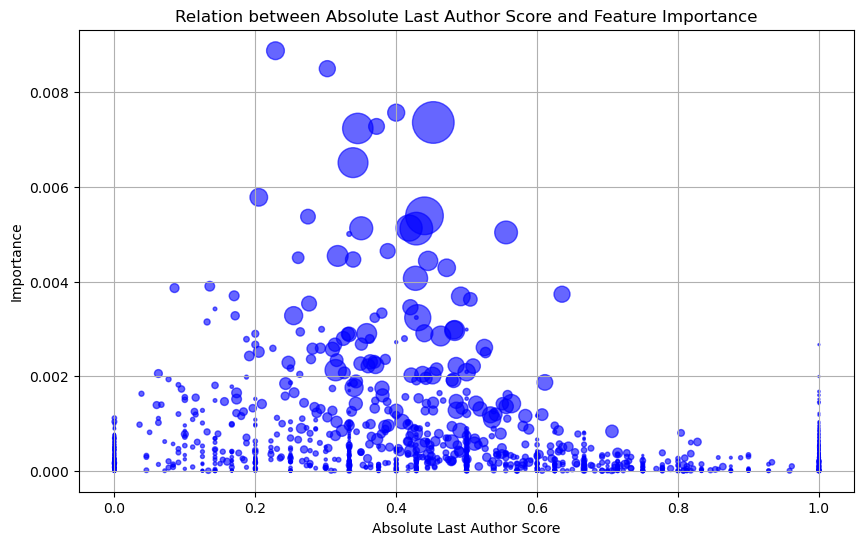

In [47]:
# Add the 'size' column to la_features_df where feature names match
la_features_df['size'] = la_features_df['Feature'].map(
    nodes_predominance_df.set_index('feature_name')['size']
)

# Plotting the relation between abs_la_score and Importance with the size included
plt.figure(figsize=(10, 6))
plt.scatter(la_features_df['abs_la_score'], la_features_df['Importance'], 
            s=la_features_df['size'], alpha=0.6, color='blue')
plt.title('Relation between Absolute Last Author Score and Feature Importance')
plt.xlabel('Absolute Last Author Score')
plt.ylabel('Importance')
plt.grid(True)
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/LA_feature_imp.png')
plt.show()

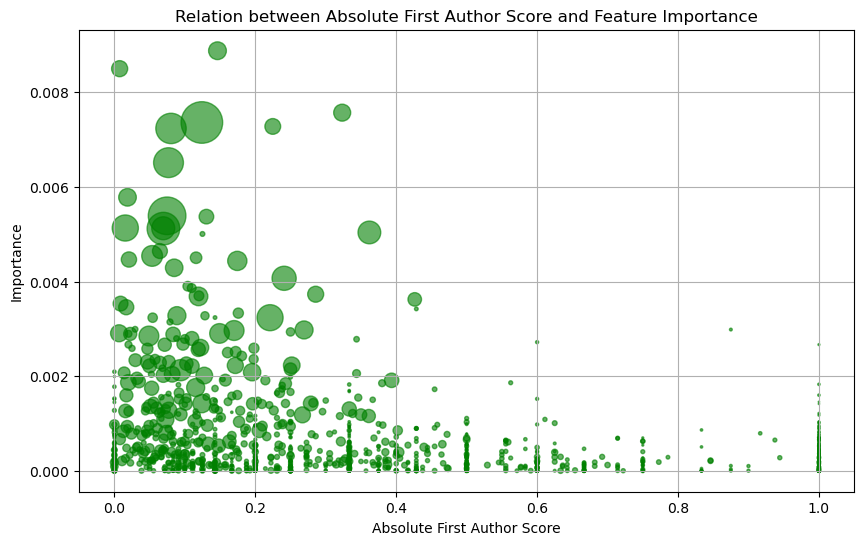

In [48]:
# Add the 'size' column to la_features_df where feature names match
la_features_df['size'] = la_features_df['Feature'].map(
    nodes_predominance_df.set_index('feature_name')['size']
)

# Plotting the relation between abs_la_score and Importance with the size included
plt.figure(figsize=(10, 6))
plt.scatter(la_features_df['abs_fa_score'], la_features_df['Importance'], 
            s=la_features_df['size'], alpha=0.6, color='green')
plt.title('Relation between Absolute First Author Score and Feature Importance')
plt.xlabel('Absolute First Author Score')
plt.ylabel('Importance')
plt.grid(True)
plt.savefig('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Graphs/Visualizations/FA_feature_imp.png')
plt.show()